<a href="https://colab.research.google.com/github/anishmahapatra/Classification-Telecom-Customer-Churn/blob/main/v4_Classification_Telecom_Customer_Churn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Prediction of Customer Attrition in the Telecom Industry using Machine Learning

Master's in Data Science from<br/>
Liverpool John Moores University <br/>
*Date: April, 2020 <br/>
Author: Anish Mahapatra* 

This notebook is based on the IBM Watson Telecom Dataset. We will go through all of the steps:

- Data Selection
- Data Preprocessing
- Data Transformation
- Data Visualization
- Class Balancing
- Model Building
- Model Evaluation
- Model Review

<b>Aim:</b> <br/>The purpose of this notebook is to analyze, visualize and model (classification) [IBM Telecom Dataset](https://www.kaggle.com/blastchar/telco-customer-churn).

The Telecom Dataset has been pulled from the IBM Watson Website. The level of the Data is at a <b>Customer Id</b> Level.



<a name="0"></a>
## Table of Contents

1 [Loading the Data](#1) <br/>
2 [Quick EDA](#2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;2.1 [Pandas Profiling](#2.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;2.2 [SweetViz](#2.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;2.3 [Dataprep](#2.3) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;2.4 [Initial EDA](#2.4) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;2.5 [Statistical Tests](#2.5) <br/>
3 [Pre-processing](#3) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.1 [Distribution of each feature](#3.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.2 [Distribution of each feature based on Churn](#3.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;3.3 [Numerical values, value ranges and distributions](#3.3) <br/>
4 [Modelling](#4) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;4.1 [Encoding](#4.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;4.2 [Train-Test Split](#4.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;4.3 [Building ML Pipelines](#4.3) <br/>
5 [Refinement](#5) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;5.1 [Cross-Validation](#5.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;5.2 [Best Features Selection](#5.2) <br/>
6 [Hyperparameter Tuning](#6) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;6.1 [Preprocessing](#6.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;6.2 [Utility functions for Hyperparameter Tuning](#6.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;6.3 [Random Forest](#6.3) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;6.4 [Gradient Boosting](#6.4) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;6.5 [Light GBM](#6.5) <br/>
7 [LIME](#7) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;7.1 [LIME Explainer](#7.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;7.2 [XGBoost LIME](#7.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;7.3 [LIME](#7.3) <br/>
8 [SMOTE](#8) <br/> 
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;8.1 [Import and clean data](#8.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;8.2 [Correlations in the data](#8.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;8.3 [Data Preprocessing](#8.3) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;8.4 [Data Modelling](#8.4) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;8.5 [Model Comparison](#8.5) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;8.6 [Further Analysis](#8.6) <br/>
9 [SHAP](#9) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;9.1 [Feature Engineering](#9.1) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;9.2 [Predictive Modelling](#9.2) <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;9.3 [Model Interpretability using SHAP](#9.3) <br/>


<a name="1"></a>
## 1 Loading the Data
Back to [Table of Contents](#0)

---


In [ ]:
# Installing the required packages

! pip uninstall -y pandas-profiling &> /dev/null                # Package for pandas profiling - visualization
! pip install pandas-profiling[notebook,html] &> /dev/null      # Uninstalling and reinstalling it due to a bug in Google Colab
! pip install sweetviz &> /dev/null                             # Package for some sweet visualizations
! pip install -U dataprep &> /dev/null                          # Package for instant data preparation
! pip install --upgrade plotly &> /dev/null                     # Updating plotly to the latest version
! pip install jupyter-dash &> /dev/null                         # Installing jupyter-dash 
! pip install pydotplus &> /dev/null                            # Visualization library
! pip install eli5 &> /dev/null
! pip install lime &> /dev/null
! pip3 install catboost &> /dev/null

In [ ]:
from sklearn import svm, tree, linear_model, neighbors, naive_bayes, ensemble, discriminant_analysis, gaussian_process
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import warnings
import re
import os

# Removing the minimum display columns to 500
pd.set_option('display.max_columns', 1000)
pd.set_option('display.max_rows', 1000)

# Hide Warnings
warnings.filterwarnings('ignore') #adjust display options

%matplotlib inline 

In [ ]:
# Let us import the required packages

from dash.dependencies import Input, Output
from pandas_profiling import ProfileReport          # Pandas Profile to visualize the data
from dataprep.eda import plot_correlation           # Importing a package to visualize data correlation
from dataprep.eda import plot_missing               # Importing packge to plot the missing values of the dataset
from jupyter_dash import JupyterDash                # Importing Jupter Dash to use visualization components 

from IPython.display import display                 # Displaying widgets
import dash_html_components as html                 # To leverage html components in the visualization
import dash_core_components as dcc                  # Importing dash core components for visualization
import matplotlib.ticker as ticker                  # User-defined function for formatting graphs
import plotly.graph_objects as go                   # To use graph objects within visualizations

from plotly.offline import iplot                    # Used for interactive plots
import matplotlib.pyplot as plt                     # Importing matplotlib for visualization
from dataprep.eda import plot                       # Importing package to plot/ visualize features of the dataset
import ipywidgets as widgets                        # Creating widgets
# import plotly.express as px                         # Importing plotly express for visualizations
import matplotlib.cm as cm                          # Colormaps, colormaps handling utilities

import pandas_profiling                             # Automatic EDA
import sweetviz as sv                               # Importing sweetviz for some sweet visualizations
import seaborn as sns                               # Importing seaborn for visualization
import pandas as pd                                 # Importing pandas
import numpy as np                                  # Importing numpy
%matplotlib inline    
import warnings                                     # Importing package to toggle warnings
import IPython                                      # Importing ipython for displaying html files in the notebook

# Removing the minimum display columns to 500
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

# Hide Warnings
warnings.filterwarnings('ignore')

NumExpr defaulting to 2 threads.


In [ ]:
import numpy as np 
import pandas as pd
import pandas
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
%matplotlib inline
import seaborn as sns; sns.set()

from sklearn import tree
import graphviz 
import os

import numpy as np 
import pandas as pd 
from plotly.offline import init_notebook_mode, iplot, plot
import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go
from wordcloud import WordCloud
import matplotlib.pyplot as plt

from pandas_profiling import ProfileReport

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_classif
from sklearn.model_selection import KFold
from sklearn.feature_selection import SelectFromModel
from sklearn.svm import LinearSVC

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

from sklearn.preprocessing import normalize
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.model_selection import train_test_split

from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.decomposition import PCA

from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import BernoulliNB
from sklearn.naive_bayes import CategoricalNB
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import StandardScaler
from xgboost import XGBClassifier
import lightgbm

from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.model_selection import GridSearchCV

from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier, XGBRFClassifier
from xgboost import plot_tree, plot_importance

from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE

from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis


import warnings
warnings.filterwarnings("ignore")

In [ ]:
# Reading the file onto Google Colab from GitHub using pandas library
telecomDf = pd.read_csv("https://raw.githubusercontent.com/anishmahapatra/Telecom-Customer-Churn/main/Data/WA_Fn-UseC_-Telco-Customer-Churn.csv")    # Reading file zomato.csv

In [ ]:
df = telecomDf.copy(deep = True)
# Viewing the head of the data
df.head().T

,0,1,2,3,4
customerID,7590-VHVEG,5575-GNVDE,3668-QPYBK,7795-CFOCW,9237-HQITU
gender,Female,Male,Male,Male,Female
SeniorCitizen,0,0,0,0,0
Partner,Yes,No,No,No,No
Dependents,No,No,No,No,No
tenure,1,34,2,45,2
PhoneService,No,Yes,Yes,No,Yes
MultipleLines,No phone service,No,No,No phone service,No
InternetService,DSL,DSL,DSL,DSL,Fiber optic
OnlineSecurity,No,Yes,Yes,Yes,No


In [ ]:
df.shape

(7043, 21)

In [ ]:
# Let's view a summary of the dataset now
print(df.info(verbose=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   gender            7043 non-null   object 
 2   SeniorCitizen     7043 non-null   int64  
 3   Partner           7043 non-null   object 
 4   Dependents        7043 non-null   object 
 5   tenure            7043 non-null   int64  
 6   PhoneService      7043 non-null   object 
 7   MultipleLines     7043 non-null   object 
 8   InternetService   7043 non-null   object 
 9   OnlineSecurity    7043 non-null   object 
 10  OnlineBackup      7043 non-null   object 
 11  DeviceProtection  7043 non-null   object 
 12  TechSupport       7043 non-null   object 
 13  StreamingTV       7043 non-null   object 
 14  StreamingMovies   7043 non-null   object 
 15  Contract          7043 non-null   object 
 16  PaperlessBilling  7043 non-null   object 


**Variable Descriptions**
- gender --> Whether the customer is a male or a female
- SeniorCitizen --> Whether the customer is a senior citizen or not (1, 0)
- Partner --> Whether the customer has a partner or not (Yes, No)
- Dependents --> Whether the customer has dependents or not (Yes, No)
- tenure --> Number of months the customer has stayed with the company
- PhoneService --> Whether the customer has a phone service or not (Yes, No)
- MultipleLines --> Whether the customer has multiple lines or not (Yes, No, No phone service)
- InternetService --> Customer’s internet service provider (DSL, Fiber optic, No)
- OnlineSecurity --> Whether the customer has online security or not (Yes, No, No internet service)
- OnlineBackup --> Whether the customer has online backup or not (Yes, No, No internet service)
- DeviceProtection --> Whether the customer has device protection or not (Yes, No, No internet service)
- TechSupport --> Whether the customer has tech support or not (Yes, No, No internet service)
- StreamingTV --> Whether the customer has streaming TV or not (Yes, No, No internet service)
- StreamingMovies --> Whether the customer has streaming movies or not (Yes, No, No internet service)
- Contract --> The contract term of the customer (Month-to-month, One year, Two year)
- PaperlessBilling --> Whether the customer has paperless billing or not (Yes, No)
- PaymentMethod --> The customer’s payment method (Electronic check, Mailed check, Bank transfer (automatic), Credit card (automatic))
- MonthlyCharges --> The amount charged to the customer monthly
- TotalCharges --> The total amount charged to the customer
- Churn --> Whether the customer churned or not (Yes or No)

In [ ]:
df.isnull().sum().sum()

0

<a name="2"></a>
## 2 Quick EDA
Back to [Table of Contents](#0)

---


Now that we have some basic data understanding of the data we are dealing with, it's time to try and understand things a little more in details. We will proceed to <b>analyze and explore the data</b>. There is a common term in the Data Science community that we use to describe this: <u>Exploratory Data Analysis</u> (<b>[EDA](https://en.wikipedia.org/wiki/Exploratory_data_analysis)</b>).</n>


Exploratory Data Analysis is used to get a <i>feel</i> of the data. We use it to understand the attributes, gaps and behaviour that the data has. A traditional way of doing it can be looking at the data column by column, row by row. As more developers contribute to the open-source python ecosystem, we have great packages that can help us analyze the data with minimal effort.


<a name="2.1"></a>
### 2.1 Pandas Profiling
Back to [Table of Contents](#0)

In [ ]:
# Making a copy of the dataset as df
df = telecomDf.copy(deep = True)

In [ ]:
# Generating the profile report and feeding it into a variable
Profile = ProfileReport(df, title = 'Telecom Data: Pandas Profiling Report', html = {'style':{'full_width':True}})

In [ ]:
# Showcasing the Pandas Profiling Report for the Zomato Dataset
Profile

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<a name="2.2"></a>
### 2.2 SweetViz
Back to [Table of Contents](#0)

The [SweetViz](https://pypi.org/project/sweetviz/) package is a pandas-based library to visualize and compare datsets. <br/>
It is used for in-depth EDA to generate beautiful, high-density visualizations. 

In [ ]:
# We shall use the SweetViz analyze() function to generate a shareable .html file to analyze the dataset
sweetvizReport = sv.analyze(df)
sweetvizReport.show_html('SweetViz.html', open_browser=False)

                                             |          | [  0%]   00:00 -> (? left)

Report SweetViz.html was generated.


We now generate the SweetViz html file and generate the html file for it. We can see


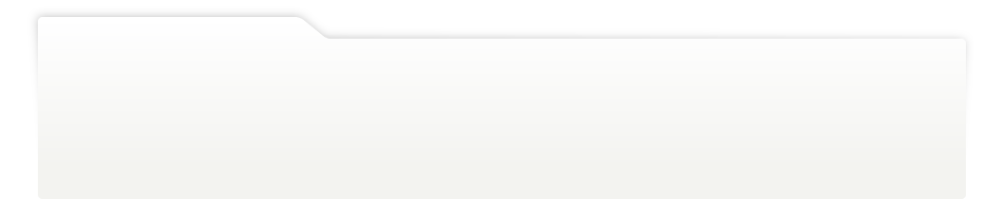
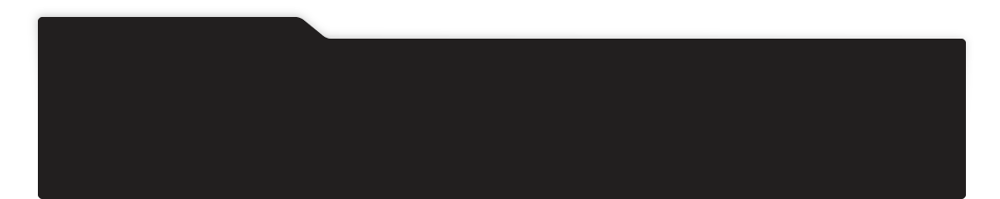
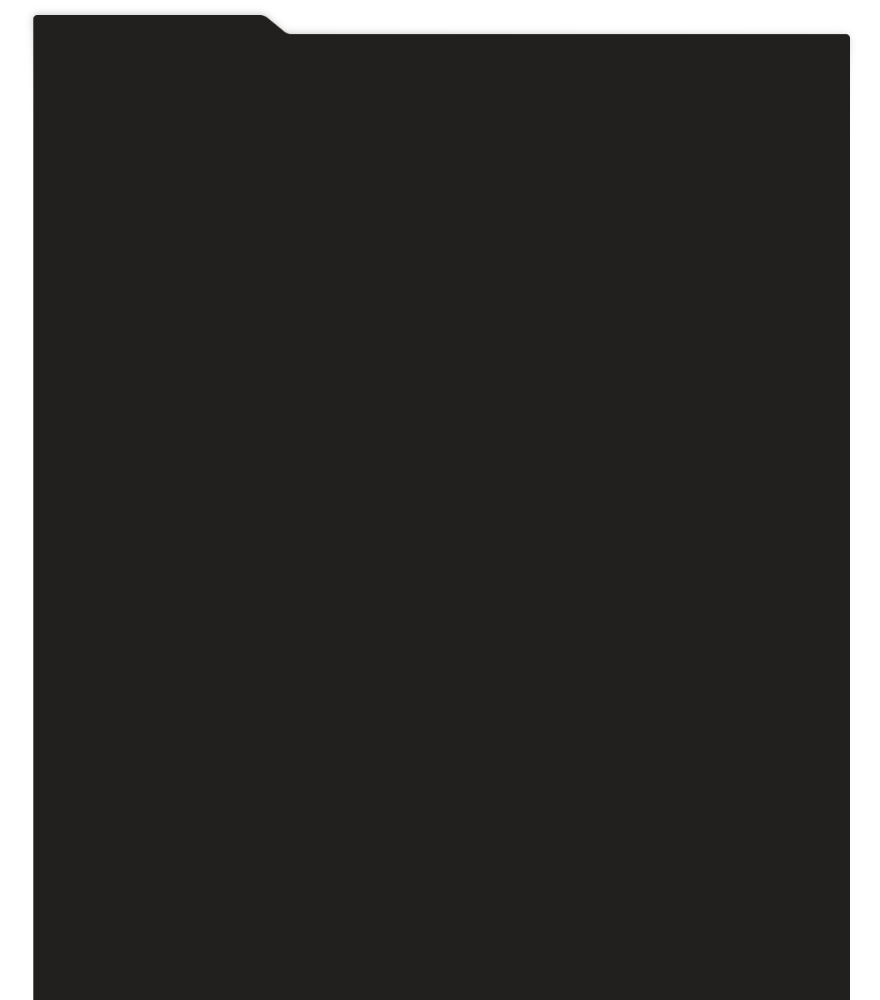
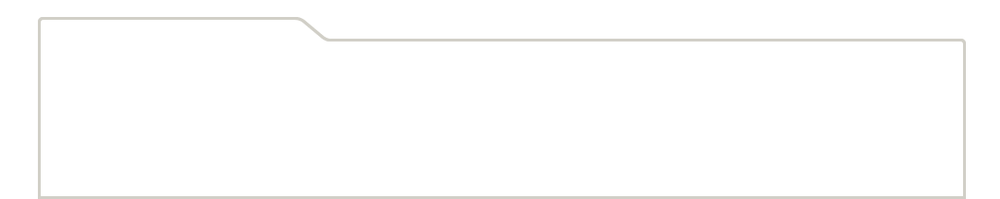
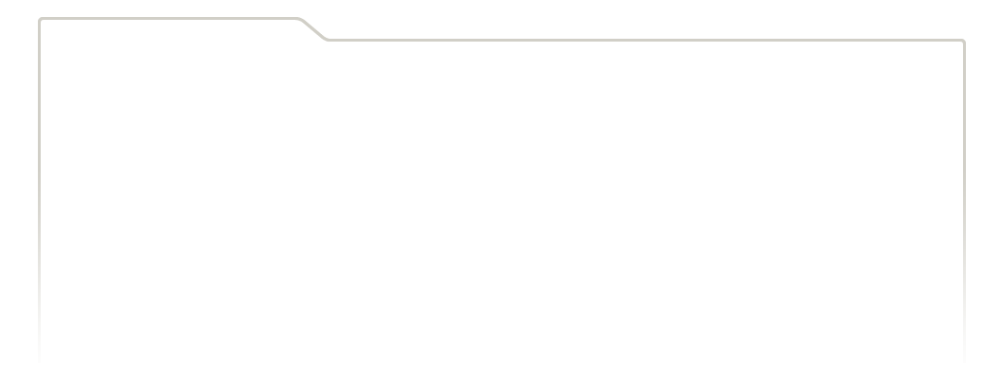
...
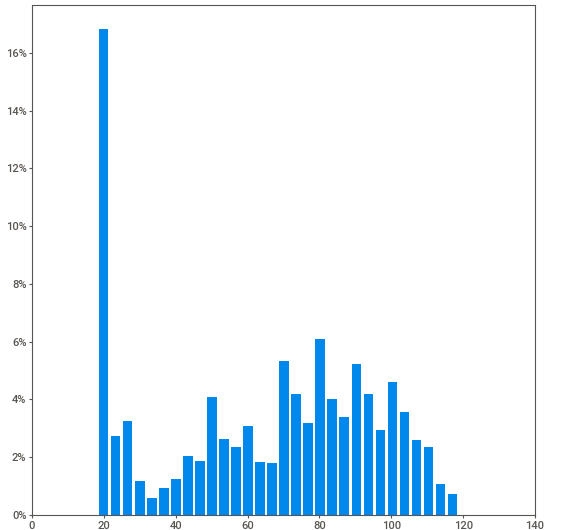
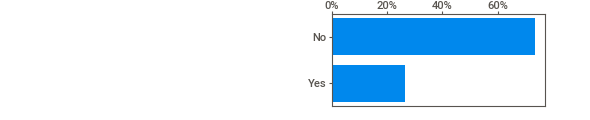
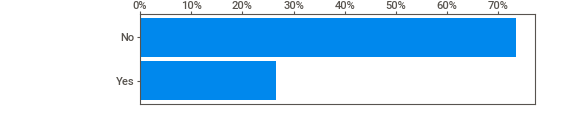
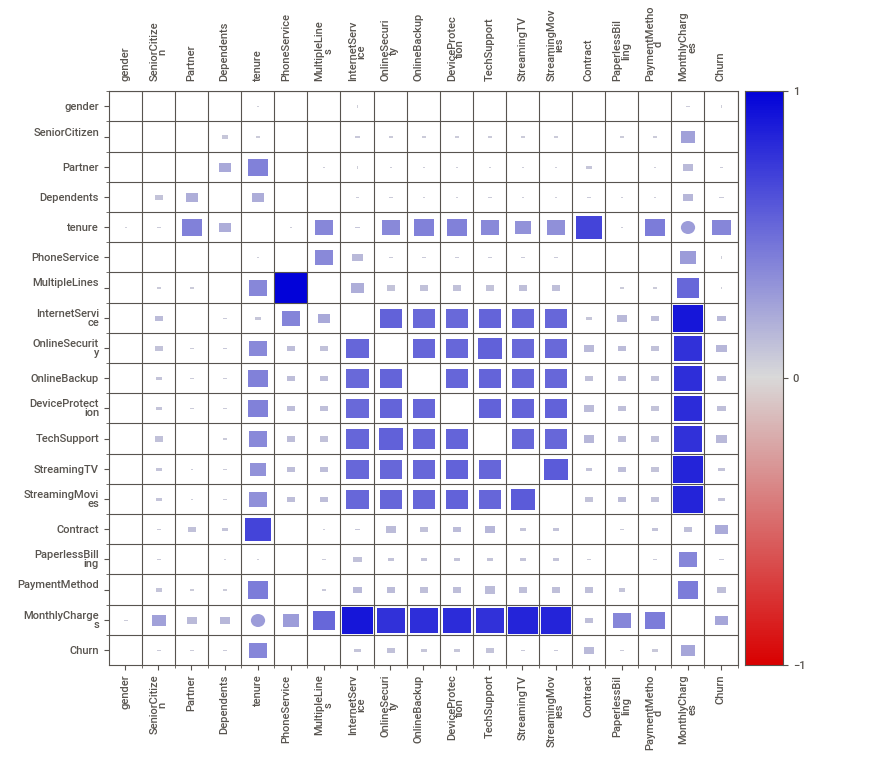
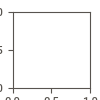

In [ ]:
# Displaying the html file in the Google Colab notebook
IPython.display.HTML('SweetViz.html')

<a name="2.3"></a>
### 2.3 Dataprep
Back to [Table of Contents](#0)

[Dataprep](https://github.com/sfu-db/dataprep) is a python package to collect data, perform eda, clean and standardize data.

In [ ]:
# Plotting the features of the dataframe
# plot(df)


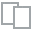
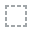
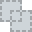
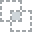
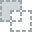
...
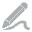
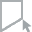
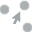
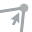
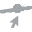

In [ ]:
# Plotting the correlation of the dataframe
plot_correlation(df)


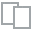
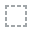
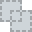
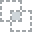
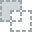
...
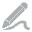
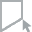
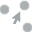
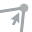
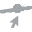

In [ ]:
# Analyzing the miissing values from the dataset and visualizing it 
plot_missing(df)

<a name="2.4"></a>
### 2.4 Initial EDA
Back to [Table of Contents](#0)


In [ ]:
import numpy as np 
import pandas as pd 
import eli5
import plotly
import plotly.graph_objs as go
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set()
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
from scipy.stats import chisquare
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from eli5.sklearn import PermutationImportance

# command for work offline
plotly.offline.init_notebook_mode(connected=True)

In [ ]:
dataset = telecomDf.copy(deep = True)

In [ ]:
# an overview of the dataset
dataset.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [ ]:
# only 3 feature contain numerical values, rest are categorical feature
dataset.describe()

,SeniorCitizen,tenure,MonthlyCharges
count,7043.000000,7043.000000,7043.000000
mean,0.162147,32.371149,64.761692
std,0.368612,24.559481,30.090047
min,0.000000,0.000000,18.250000
25%,0.000000,9.000000,35.500000
50%,0.000000,29.000000,70.350000
75%,0.000000,55.000000,89.850000
max,1.000000,72.000000,118.750000


In [ ]:
# customer id is unnecessary
del dataset["customerID"]

<a name="2.4.1"></a>
#### 2.4.1 Encoding: Binary, One-hot
Back to [Table of Contents](#0)


In [ ]:
gender_map = {"Female" : 0, "Male": 1}
yes_no_map = {"Yes" : 1, "No" : 0}

dataset["gender"] = dataset["gender"].map(gender_map)

def binary_encode(features):
    for feature in features:
        dataset[feature] = dataset[feature].map(yes_no_map)

Apply binary encoding on categorical features that contains only two categories

In [ ]:
binary_encode_candidate = ["Partner", "Dependents", "PhoneService", "PaperlessBilling", "Churn"]
binary_encode(binary_encode_candidate)

In [ ]:
# converting series object dataset into numeric
# errors = 'coerce’ means, if invalid parsing occur then set NaN
dataset["TotalCharges"] = pd.to_numeric(dataset["TotalCharges"], errors = 'coerce')

In [ ]:
# missing values check
print(dataset.isnull().any())
print("\n# of Null values in 'TotalCharges`: ",dataset["TotalCharges"].isnull().sum())

gender              False
SeniorCitizen       False
Partner             False
Dependents          False
tenure              False
PhoneService        False
MultipleLines       False
InternetService     False
OnlineSecurity      False
OnlineBackup        False
DeviceProtection    False
TechSupport         False
StreamingTV         False
StreamingMovies     False
Contract            False
PaperlessBilling    False
PaymentMethod       False
MonthlyCharges      False
TotalCharges         True
Churn               False
dtype: bool

# of Null values in 'TotalCharges`:  11


In [ ]:
# fill null values with the mean values of that feature
dataset["TotalCharges"].fillna(dataset["TotalCharges"].mean(), inplace=True)

Apply One Hot Encoding on categorical features that containg more than two categories

In [ ]:
dataset = pd.get_dummies(dataset)

In [ ]:
# now take a look at our final dataset
dataset.head()

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,MultipleLines_No,MultipleLines_No phone service,MultipleLines_Yes,InternetService_DSL,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No,OnlineSecurity_No internet service,OnlineSecurity_Yes,OnlineBackup_No,OnlineBackup_No internet service,OnlineBackup_Yes,DeviceProtection_No,DeviceProtection_No internet service,DeviceProtection_Yes,TechSupport_No,TechSupport_No internet service,TechSupport_Yes,StreamingTV_No,StreamingTV_No internet service,StreamingTV_Yes,StreamingMovies_No,StreamingMovies_No internet service,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,0,0,1,0,1,0,1,29.85,29.85,0,0,1,0,1,0,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0
1,1,0,0,0,34,1,0,56.95,1889.50,0,1,0,0,1,0,0,0,0,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1
2,1,0,0,0,2,1,1,53.85,108.15,1,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1
3,1,0,0,0,45,0,0,42.30,1840.75,0,0,1,0,1,0,0,0,0,1,1,0,0,0,0,1,0,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0
4,0,0,0,0,2,1,1,70.70,151.65,1,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0


In [ ]:
dataset.describe().T

,count,mean,std,min,25%,50%,75%,max
gender,7043.0,0.504756,0.500013,0.00,0.000,1.00,1.00,1.00
SeniorCitizen,7043.0,0.162147,0.368612,0.00,0.000,0.00,0.00,1.00
Partner,7043.0,0.483033,0.499748,0.00,0.000,0.00,1.00,1.00
Dependents,7043.0,0.299588,0.458110,0.00,0.000,0.00,1.00,1.00
tenure,7043.0,32.371149,24.559481,0.00,9.000,29.00,55.00,72.00
PhoneService,7043.0,0.903166,0.295752,0.00,1.000,1.00,1.00,1.00
PaperlessBilling,7043.0,0.592219,0.491457,0.00,0.000,1.00,1.00,1.00
MonthlyCharges,7043.0,64.761692,30.090047,18.25,35.500,70.35,89.85,118.75
TotalCharges,7043.0,2283.300441,2265.000258,18.80,402.225,1400.55,3786.60,8684.80
Churn,7043.0,0.265370,0.441561,0.00,0.000,0.00,1.00,1.00


<a name="2.4.2"></a>
#### 2.4.2 Feature Selection: Chi Squared Test
Back to [Table of Contents](#0)

Applying  chi2  test and select only top 20 highest  chi2  weighted feature

In [ ]:
df = dataset.copy(deep = True)

In [ ]:
# del df['TotalCharges']
# del df['tenure']
# del df['MonthlyCharges']

In [ ]:
result = pd.DataFrame(columns=["Features", "Chi2Weights"])

for i in range(len(df.columns)):
    chi2, p = chisquare(df[df.columns[i]])
    result = result.append([pd.Series([df.columns[i], chi2], index = result.columns)], ignore_index=True)

In [ ]:
result = result.sort_values(by="Chi2Weights", ascending=False)

In [ ]:
result.head(20)

,Features,Chi2Weights
8,TotalCharges,1.582229e+07
4,tenure,1.312128e+05
7,MonthlyCharges,9.845178e+04
11,MultipleLines_No phone service,6.361000e+03
1,SeniorCitizen,5.901000e+03
35,Contract_One year,5.570000e+03
38,PaymentMethod_Credit card (automatic),5.521000e+03
20,OnlineBackup_No internet service,5.517000e+03
15,InternetService_No,5.517000e+03
32,StreamingMovies_No internet service,5.517000e+03


In [ ]:
new_df = df[result["Features"].head(20)]

In [ ]:
df.head()

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,MultipleLines_No,MultipleLines_No phone service,MultipleLines_Yes,InternetService_DSL,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No,OnlineSecurity_No internet service,OnlineSecurity_Yes,OnlineBackup_No,OnlineBackup_No internet service,OnlineBackup_Yes,DeviceProtection_No,DeviceProtection_No internet service,DeviceProtection_Yes,TechSupport_No,TechSupport_No internet service,TechSupport_Yes,StreamingTV_No,StreamingTV_No internet service,StreamingTV_Yes,StreamingMovies_No,StreamingMovies_No internet service,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,0,0,1,0,1,0,1,29.85,29.85,0,0,1,0,1,0,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0
1,1,0,0,0,34,1,0,56.95,1889.50,0,1,0,0,1,0,0,0,0,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1
2,1,0,0,0,2,1,1,53.85,108.15,1,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1
3,1,0,0,0,45,0,0,42.30,1840.75,0,0,1,0,1,0,0,0,0,1,1,0,0,0,0,1,0,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0
4,0,0,0,0,2,1,1,70.70,151.65,1,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0


<a name="2.4.3"></a>
#### 2.4.3 Correlation
Back to [Table of Contents](#0)

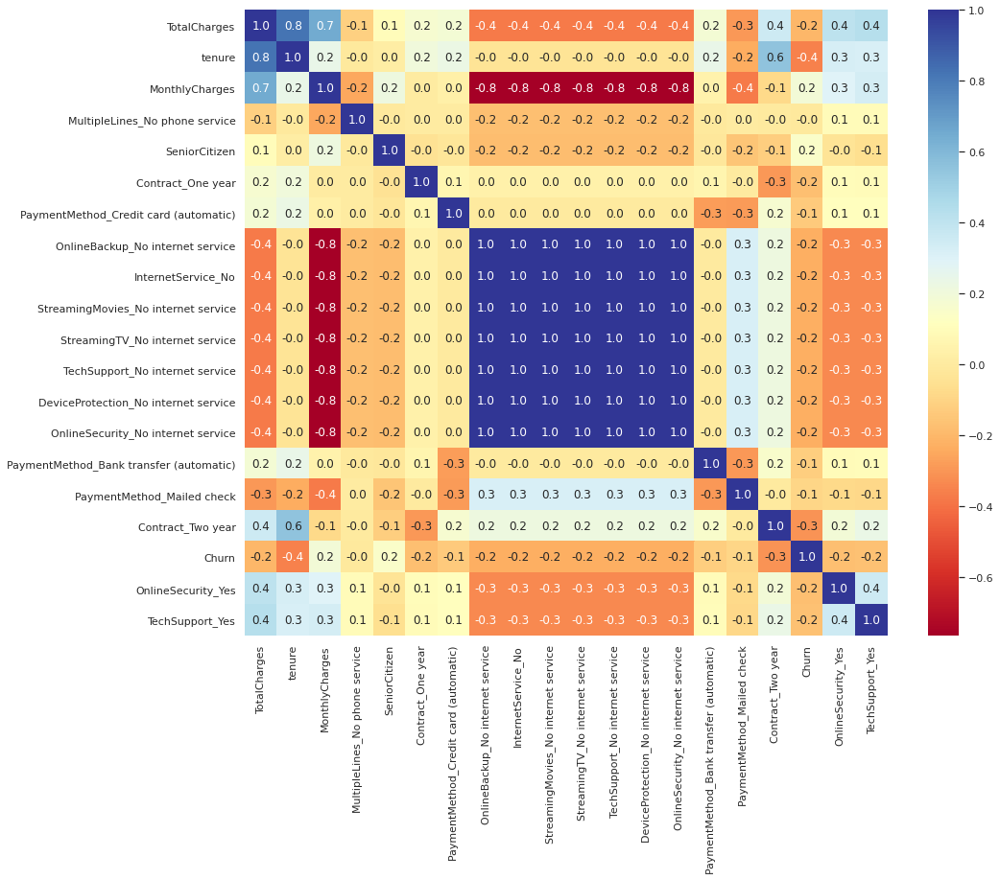

In [ ]:
plt.figure(figsize = (15, 12))
sns.heatmap(new_df.corr(), cmap="RdYlBu", annot=True, fmt=".1f")
plt.show()

In [ ]:
hightly_corr_feature = ["OnlineBackup_No internet service", "StreamingMovies_No internet service", "StreamingTV_No internet service", 
"TechSupport_No internet service", "DeviceProtection_No internet service", "OnlineSecurity_No internet service"]

def remove_corr_features(features):
    for feature in features:
        del new_df[feature]

In [ ]:
remove_corr_features(hightly_corr_feature)

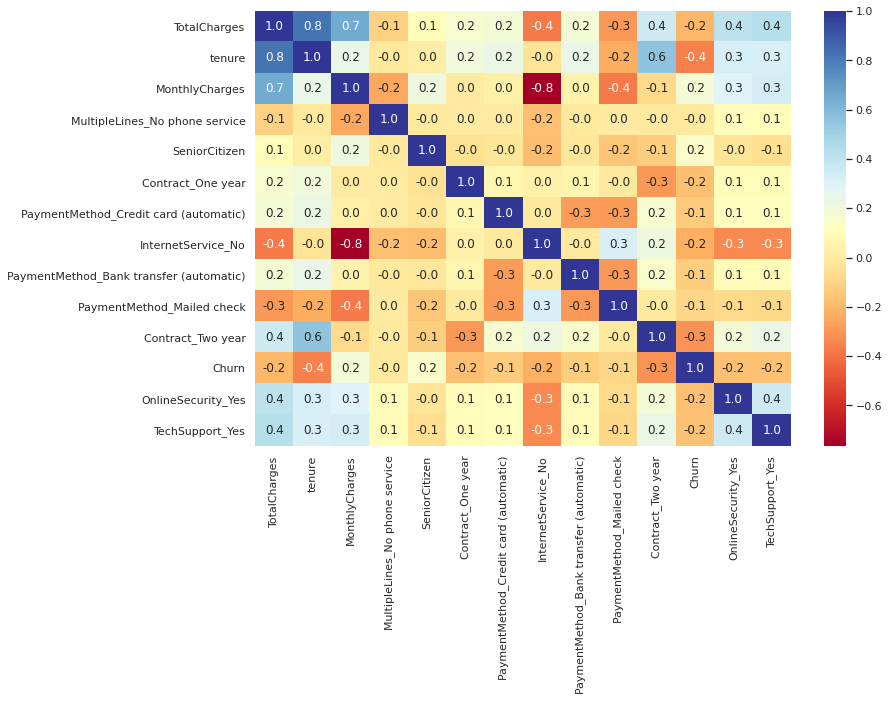

In [ ]:
plt.figure(figsize = (12, 8))
sns.heatmap(new_df.corr(), cmap="RdYlBu", annot=True, fmt=".1f")
plt.show()

<a name="2.4.4"></a>
#### 2.4.4 Boxplot for outlier detection
Back to [Table of Contents](#0)

In [ ]:
trace = []

def gen_boxplot(df):
    for feature in df:
        trace.append(
            go.Box(
                name = feature,
                y = df[feature]
            )
        )
        
gen_boxplot(new_df)

In [ ]:
data = trace
plotly.offline.iplot(data)

Text(0.5, 1.0, 'Churn vs. Monthly Charges')

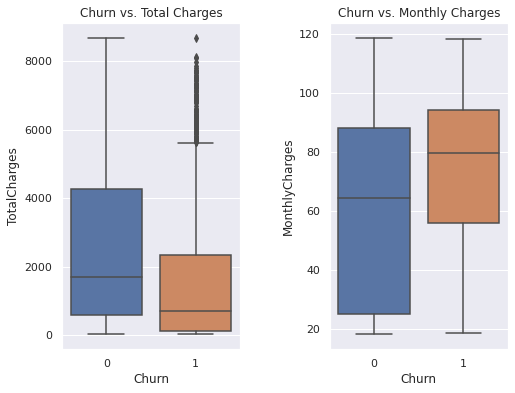

In [ ]:
_, ax = plt.subplots(1, 2, figsize= (8, 6))
plt.subplots_adjust(wspace = 0.5)
sns.boxplot(x = 'Churn',  y = 'TotalCharges', data = new_df, ax=ax[0]).set_title("Churn vs. Total Charges")
sns.boxplot(x = 'Churn',  y = 'MonthlyCharges', data = new_df, ax=ax[1]).set_title("Churn vs. Monthly Charges")

In [ ]:
X = new_df.drop("Churn", axis=1)
y = new_df["Churn"]

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)
clf = RandomForestClassifier(random_state=0).fit(X_train, y_train)

In [ ]:
perm = PermutationImportance(clf, random_state = 1).fit(X_test, y_test)
eli5.show_weights(perm, feature_names = X_test.columns.tolist())

Weight,Feature
0.0282 ± 0.0105,MonthlyCharges
0.0240 ± 0.0060,tenure
0.0115 ± 0.0068,Contract_One year
0.0085 ± 0.0094,TechSupport_Yes
0.0069 ± 0.0036,SeniorCitizen
0.0067 ± 0.0060,Contract_Two year
0.0066 ± 0.0056,PaymentMethod_Bank transfer (automatic)
0.0062 ± 0.0030,OnlineSecurity_Yes
0.0034 ± 0.0055,InternetService_No
0.0032 ± 0.0057,PaymentMethod_Mailed check


<a name="2.5"></a>
### 2.5 Statistical Tests
Back to [Table of Contents](#0)


In [ ]:
df = telecomDf.copy(deep = True)

Most of the people prefer to use warpper methods like forward feature selection,backward elimenation etc for feature selection, but while doing EDA, while proceeding to next step the easiest way to do feature selection is using univariate methods like ch2 test, ANOVA test, using coorelation matrix etc.

In [ ]:
#basic EDA


df = df.drop(columns=['customerID'])
df['TotalCharges'] = df['TotalCharges'].apply(lambda x: -1 if x == ' ' else float(x))
df['TotalCharges'] = df['TotalCharges'].replace(-1,df['TotalCharges'].mean())


num_cols = ['TotalCharges','MonthlyCharges','tenure']
for col in num_cols:
    df[col] = df[col].astype(np.float32)

<a name="2.5.1"></a>
#### 2.5.1 Chi Squared Test (For Categorical data) 
Back to [Table of Contents](#0)


In the case of classification problems where input variables are also categorical, we can use statistical tests to determine whether the output variable is dependent or independent of the input variables. If independent, then the input variable is a candidate for a feature that may be irrelevant to the problem and removed from the dataset. The Pearson’s chi-squared statistical hypothesis is an example of a test for independence between categorical variables.

Chi2 test can be used to know the feature importance of categorical variables in classification problems.Basically it will find wheather a relationship exist or there is dependency between two features. Let us take some categorical variables and see how it performs

In [ ]:
df['SeniorCitizen'].value_counts()


0    5901
1    1142
Name: SeniorCitizen, dtype: int64

1. Design the hypothesis

**Null hypothesis (H0)** : Two features are independent

**Alternate hypothesis (H1)** : Two features are dependent

If we proved that input and target variables are independent, then there is no strong relation with the target and we can remove that feature on moving forward.

2. Choose a alpha value

We need to choose a alpha-value (significance value) which indicates how confident are we in saying two features are independent.Here we choose alpha value = 0.05 which indicates the probability of rejecting null hypothesis if it is true.

If the p value obtained is greater than alpha value the null hypotheis (H0) is true.

In [ ]:
# contigency table
alpha = 0.05
cont_table = pd.crosstab(index=df['SeniorCitizen'],columns=df['Churn'])
cont_table

Churn,No,Yes
SeniorCitizen,,
0,4508,1393
1,666,476


In [ ]:
from scipy.stats import chi2_contingency,chi2

# chi2 value, p value, degree of freedom , expected_table
chi2_value, p, dof, expected_table = chi2_contingency(cont_table)

print(f'chi2 value: {chi2_value}')
print(f'p value: {p}')
print(f'degree of freedom: {dof}')
print(f'expected table/array : \n {expected_table}')

chi2 value: 159.42630036838742
p value: 1.510066805092378e-36
degree of freedom: 1
expected table/array : 
 [[4335.05239245 1565.94760755]
 [ 838.94760755  303.05239245]]


In [ ]:
## calculated value of chi2 >= crirical value from table(found using dof and alpha) --> Ho is rejected
## ie,  abs(ch2_value) > chi2.ppf(0.95, dof) -->Ho rejected

if p <= alpha:
    print(f'Reject null hypothesis. There exist some relation between features')
else:
    print(f'Accept null hypothesis. Two features are not related')

Reject null hypothesis. There exist some relation between features


Here we rejected null hypothesis which means features are not independent. There exist some relationship between SeniorCitizen and Churn prediction.

Note: Usually in hypothesis testing values below critical value are acepted and values above it are rejected. (one tail test)



In [ ]:
def chi2_test(X,target,alpha=0.05):
    """
    X = input dataframe
    target= target frame
    alpha = significant value
    """
    useful_cols = {}
    for col in X.columns: 
        cont_table = pd.crosstab(index=X[col],columns=target)
        chi2_value, p, dof, expected_table = chi2_contingency(cont_table)
        if p <= alpha:
            # reject null hypothesis # so, important feature
            useful_cols[col] = p
    print(f'Total {len(useful_cols)} features selected')
    return useful_cols


In [ ]:
chi2_test(df[['gender','SeniorCitizen', 'Partner','PhoneService','PaperlessBilling']],df['Churn'])

Total 3 features selected


{'PaperlessBilling': 4.073354668665985e-58,
 'Partner': 2.1399113440759935e-36,
 'SeniorCitizen': 1.510066805092378e-36}

We shall encode categorical variables

In [ ]:
from sklearn.feature_selection import SelectKBest,chi2

dff = df[['gender','SeniorCitizen', 'Partner','PhoneService','PaperlessBilling','Churn']]

# label encod cat features
dff['gender'] = dff['gender'].map({v:i for i,v in enumerate(dff['gender'].value_counts().index)})
dff['SeniorCitizen'] = dff['SeniorCitizen'].map({v:i for i,v in enumerate(dff['SeniorCitizen'].value_counts().index)})
dff['Partner'] = dff['Partner'].map({v:i for i,v in enumerate(dff['Partner'].value_counts().index)})
dff['PhoneService'] = dff['PhoneService'].map({v:i for i,v in enumerate(dff['PhoneService'].value_counts().index)})
dff['PaperlessBilling'] = dff['PaperlessBilling'].map({v:i for i,v in enumerate(dff['PaperlessBilling'].value_counts().index)})

We will give k = 5 to show case scores of all features.If we want top 3 features we can directly give k = 3



In [ ]:
best = SelectKBest(chi2,k=5)
best.fit(dff[['gender','SeniorCitizen', 'Partner','PhoneService','PaperlessBilling']],dff['Churn'])

SelectKBest(k=5, score_func=<function chi2 at 0x7fa0551a9050>)

In [ ]:
df_score = pd.DataFrame(best.pvalues_,columns=['P-Values'])
df_score['Chi Squared Values'] = best.scores_
df_score['Attributes'] = ['Gender','SeniorCitizen', 'Partner','PhoneService','PaperlessBilling']
df_score

,P-Values,Chi Squared Values,Attributes
0,6.076114e-01,0.263668,Gender
1,4.576959e-31,134.351545,SeniorCitizen
2,1.104764e-19,82.412083,Partner
3,3.408723e-01,0.907148,PhoneService
4,3.008474e-35,153.480111,PaperlessBilling


We have value of significance, alpha =0.05. so we have to choose those features with p value <= alpha



In [ ]:
df_score[df_score['P-Values'] <= 0.05]['Attributes']

1       SeniorCitizen
2             Partner
4    PaperlessBilling
Name: Attributes, dtype: object

<a name="2.5.2"></a>
#### 2.5.2 ANOVA Test 
Back to [Table of Contents](#0)


One way ANOVA test can be used to find relationship between numeric and a categorical variable

Here,
Null hypothesis H0 : two groups have same variance.
Alternate hypothesis H1: aleast one of the group have different variance

ie, if two groups have same variance it indicates that those feature is not important. We can drop them on feature selection. otherwise we wont drop the feature.

The basic idea is that we will find Fscore(‘variance_between / variance_within’) and compare it with critical value obtained from F value table to accept or reject null hypothesis.

Sklearn provides method called f_classif to do Anova F test and we can use it with Select K best for faster results. We dont have to do seperate for each input feature. If the value ‘variance_between / variance_within’ is less than the critical value (evaluated using log table). The library returns score and p value, for p<0.05 we mean that the confidence>95% for them to belong to the same population and hence are co-related. We select top k co-related features according to the score returned by Anova.

In [ ]:
dff = df[['TotalCharges','MonthlyCharges','Churn']]

In [ ]:
from sklearn.feature_selection import SelectKBest, f_classif

# select top 3 features
selector = SelectKBest(f_classif,k=2)
selector.fit(dff[['TotalCharges','MonthlyCharges']],dff['Churn'])


df_score = pd.DataFrame(selector.pvalues_,columns=['P-Values'])
df_score['score'] = selector.scores_
df_score['columns'] = ['TotalCharges','MonthlyCharges']

df_score

,P-Values,score,columns
0,0.0,291.625610,TotalCharges
1,0.0,273.463959,MonthlyCharges


In [ ]:
df_score[df_score['P-Values'] <= 0.05]['columns']

0      TotalCharges
1    MonthlyCharges
Name: columns, dtype: object

<a name="2.5.3"></a>
#### 2.5.3 Probability Density Function using KDE 
Back to [Table of Contents](#0)


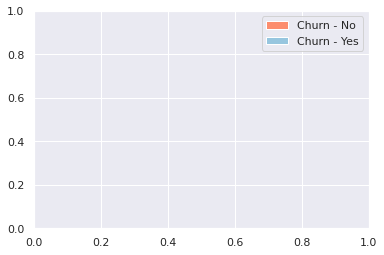

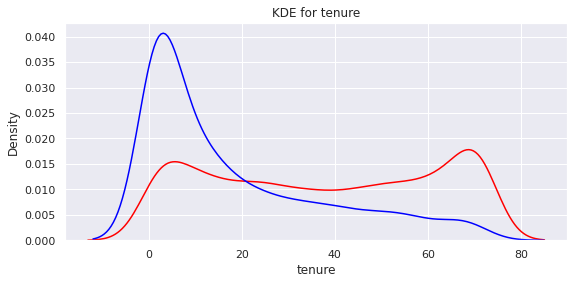

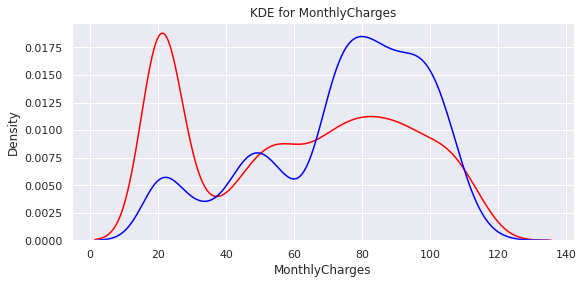

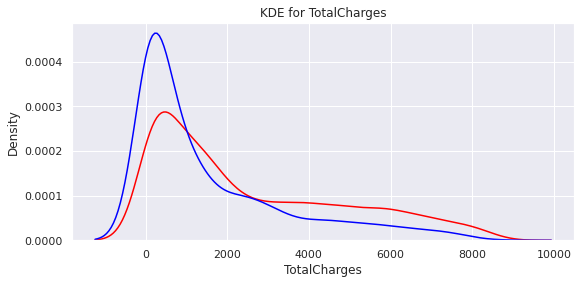

In [ ]:
import matplotlib.patches as  mpatches

def kdeplot(feature):
    plt.figure(figsize=(9, 4))
    plt.title("KDE for {}".format(feature))
    ax0 = sns.kdeplot(df[df['Churn'] == 'No'][feature].dropna(), color= 'red', label= 'Churn: No')
    ax1 = sns.kdeplot(df[df['Churn'] == 'Yes'][feature].dropna(), color= 'blue', label= 'Churn: Yes')
handles = [mpatches.Patch(facecolor=plt.cm.Reds(100), label="Churn - No"),
           mpatches.Patch(facecolor=plt.cm.Blues(100), label="Churn - Yes")]
plt.legend(handles=handles)
kdeplot('tenure')
kdeplot('MonthlyCharges')
kdeplot('TotalCharges')

<a name="3"></a>
## 3 Visualization Analysis
Back to [Table of Contents](#0)

---


<a name="3.1"></a>
### 3.1 Distribution of Each Feature
Back to [Table of Contents](#0)

In [ ]:
# Making a copy of the dataset as df
df = telecomDf.copy(deep = True)

In [ ]:
df.drop("customerID", axis=1, inplace=True)

In [ ]:
df["TotalCharges"] = pd.to_numeric(df["TotalCharges"], errors='coerce')

In [ ]:
dataset = df.copy(deep=True)

In [ ]:
categorical = (dataset.dtypes == "object")
categorical_list = list(categorical[categorical].index)

print("Categorical variables:")
print(categorical_list)

Categorical variables:
['gender', 'Partner', 'Dependents', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'Churn']


In [ ]:
numerical_int64 = (dataset.dtypes == "int64")
numerical_int64_list = list(numerical_int64[numerical_int64].index)

print("Categorical variables:")
print(numerical_int64_list)

Categorical variables:
['SeniorCitizen', 'tenure']


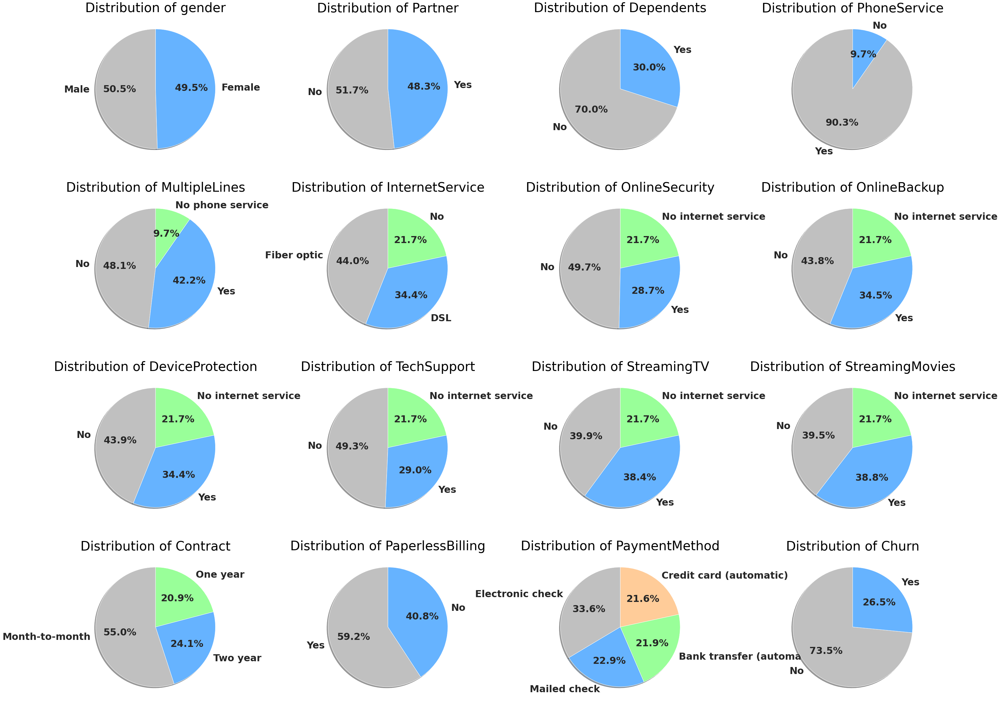

In [ ]:
plt.figure(figsize=(50,50))
j = 0

for i in categorical_list:
    colors = ['#C0C0C0','#66b3ff','#99ff99','#ffcc99','#fbdf70','#ac9fd0','#8b7470']
    
    labels = dataset[i].value_counts().index
    sizes = dataset[i].value_counts().values
    
    unique = len(dataset[i].unique())
    if(unique == 2):
        myexplode = [0.1, 0]
    if(unique == 3):
        myexplode = [0.1, 0,0]
    if(unique == 4):
        myexplode = [0.1,0,0,0]
    
    plt.subplot(5,4,j+1)
    plt.pie(sizes, labels=labels, shadow = True, startangle=90, colors=colors, autopct='%1.1f%%',textprops={'fontsize': 30})
    plt.title(f'Distribution of {i}',color = 'black',fontsize = 40)
    j += 1

<a name="3.2"></a>
### 3.2 Distribution of each feature based on 'Churn'
Back to [Table of Contents](#0)

Gender

In [ ]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 35}
import matplotlib.pylab as pylab
params = {'legend.fontsize': 'x-small',
          'figure.figsize': (25, 15),
         'axes.labelsize': 'x-small',
         'axes.titlesize':'x-small',
         'xtick.labelsize':'x-small',
         'ytick.labelsize':'x-small'}
pylab.rcParams.update(params)
plt.rc('font', **font)

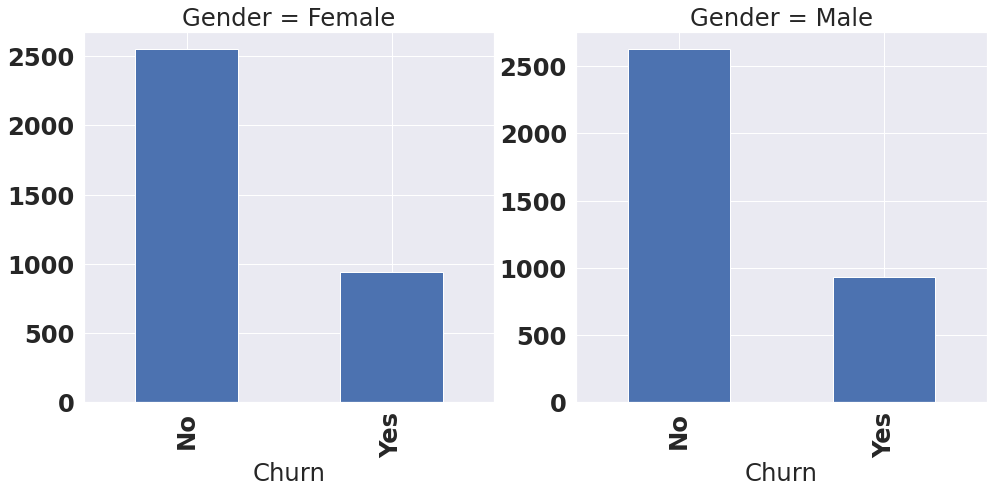

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('Gender = Female')
dataset.groupby('gender').Churn.value_counts().loc['Female'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('Gender = Male')
dataset.groupby('gender').Churn.value_counts().loc['Male'].plot(kind='bar')

Partner

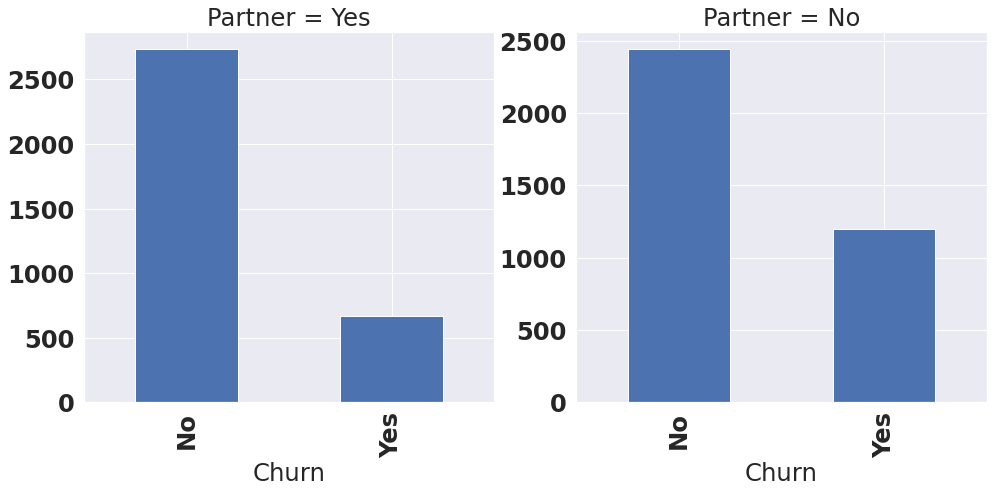

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('Partner = Yes')
dataset.groupby('Partner').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('Partner = No')
dataset.groupby('Partner').Churn.value_counts().loc['No'].plot(kind='bar')

Dependents

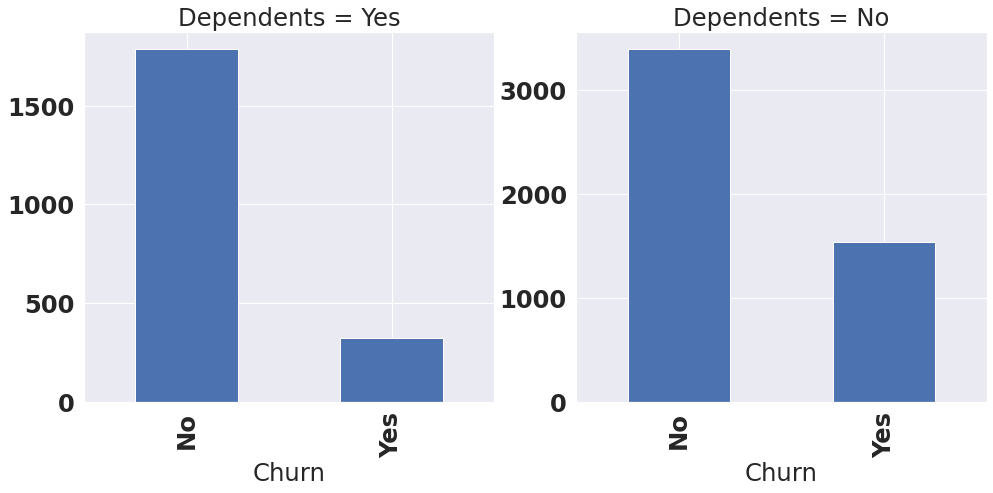

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('Dependents = Yes')
dataset.groupby('Dependents').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('Dependents = No')
dataset.groupby('Dependents').Churn.value_counts().loc['No'].plot(kind='bar')

Phone Service

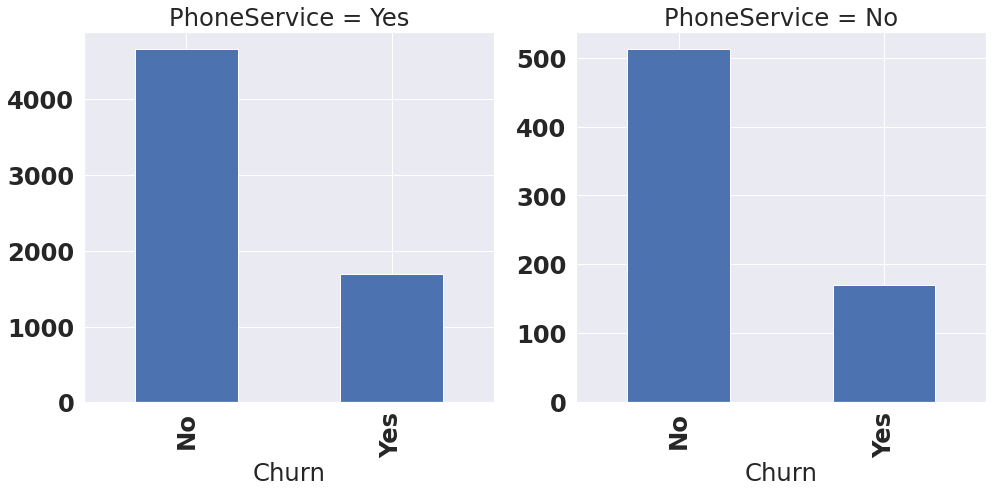

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('PhoneService = Yes')
dataset.groupby('PhoneService').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('PhoneService = No')
dataset.groupby('PhoneService').Churn.value_counts().loc['No'].plot(kind='bar')

Multiple Lines

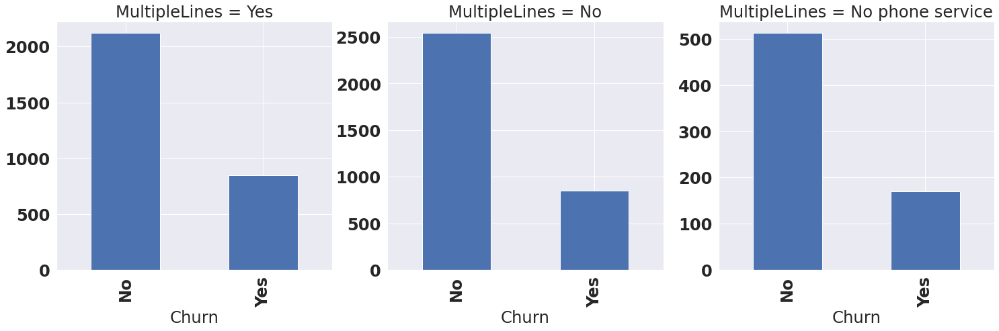

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('MultipleLines = Yes')
dataset.groupby('MultipleLines').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('MultipleLines = No')
dataset.groupby('MultipleLines').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('MultipleLines = No phone service')
dataset.groupby('MultipleLines').Churn.value_counts().loc['No phone service'].plot(kind='bar')

Internet Service

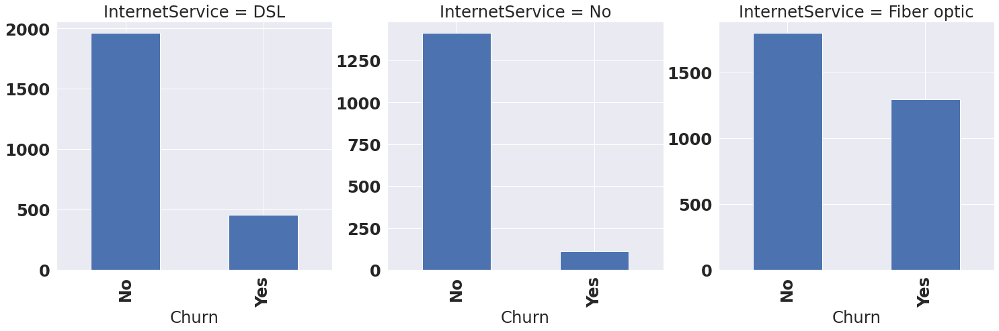

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('InternetService = DSL')
dataset.groupby('InternetService').Churn.value_counts().loc['DSL'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('InternetService = No')
dataset.groupby('InternetService').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('InternetService = Fiber optic')
dataset.groupby('InternetService').Churn.value_counts().loc['Fiber optic'].plot(kind='bar')

Online Security

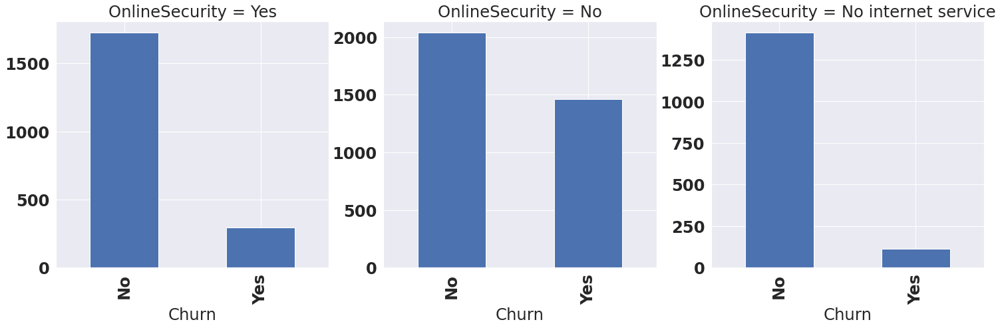

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('OnlineSecurity = Yes')
dataset.groupby('OnlineSecurity').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('OnlineSecurity = No')
dataset.groupby('OnlineSecurity').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('OnlineSecurity = No internet service')
dataset.groupby('OnlineSecurity').Churn.value_counts().loc['No internet service'].plot(kind='bar')

Online Backup

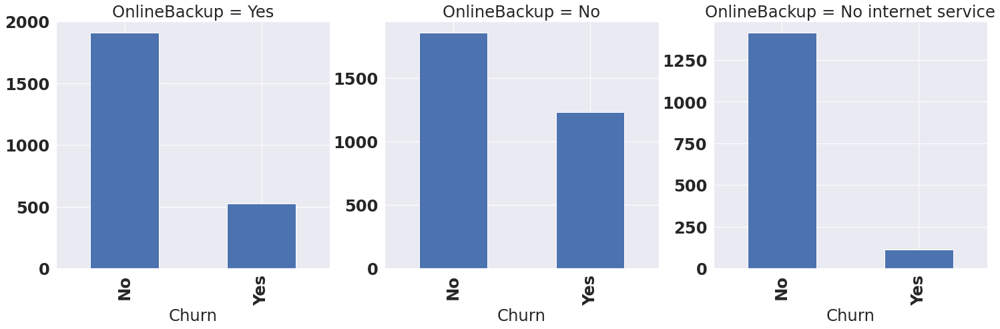

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('OnlineBackup = Yes')
dataset.groupby('OnlineBackup').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('OnlineBackup = No')
dataset.groupby('OnlineBackup').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('OnlineBackup = No internet service')
dataset.groupby('OnlineBackup').Churn.value_counts().loc['No internet service'].plot(kind='bar')

Device Protection

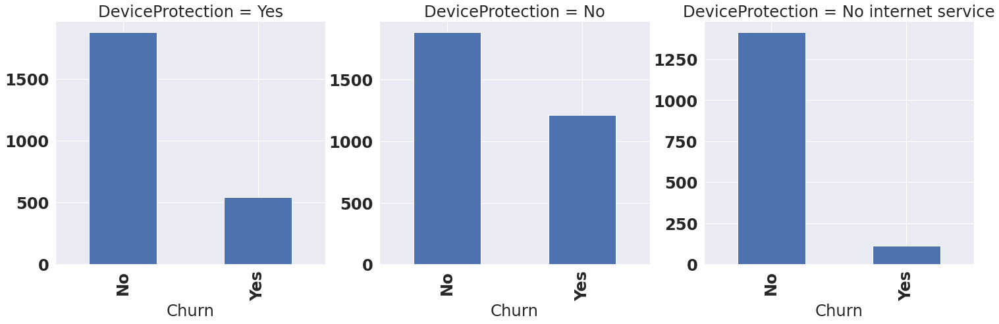

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('DeviceProtection = Yes')
dataset.groupby('DeviceProtection').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('DeviceProtection = No')
dataset.groupby('DeviceProtection').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('DeviceProtection = No internet service')
dataset.groupby('DeviceProtection').Churn.value_counts().loc['No internet service'].plot(kind='bar')

Tech Support

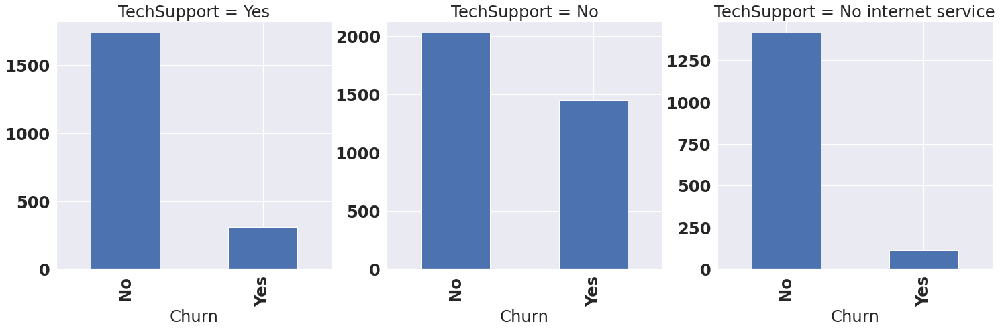

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('TechSupport = Yes')
dataset.groupby('TechSupport').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('TechSupport = No')
dataset.groupby('TechSupport').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('TechSupport = No internet service')
dataset.groupby('TechSupport').Churn.value_counts().loc['No internet service'].plot(kind='bar')

Streaming TV

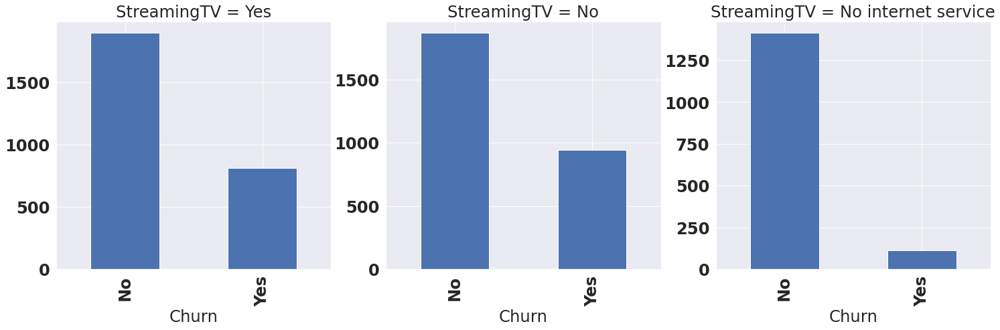

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('StreamingTV = Yes')
dataset.groupby('StreamingTV').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('StreamingTV = No')
dataset.groupby('StreamingTV').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('StreamingTV = No internet service')
dataset.groupby('StreamingTV').Churn.value_counts().loc['No internet service'].plot(kind='bar')

Streaming Movies

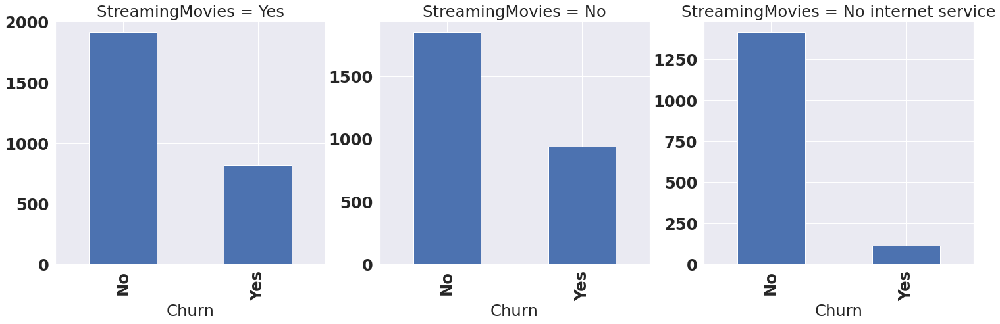

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('StreamingMovies = Yes')
dataset.groupby('StreamingMovies').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('StreamingMovies = No')
dataset.groupby('StreamingMovies').Churn.value_counts().loc['No'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('StreamingMovies = No internet service')
dataset.groupby('StreamingMovies').Churn.value_counts().loc['No internet service'].plot(kind='bar')

Contract

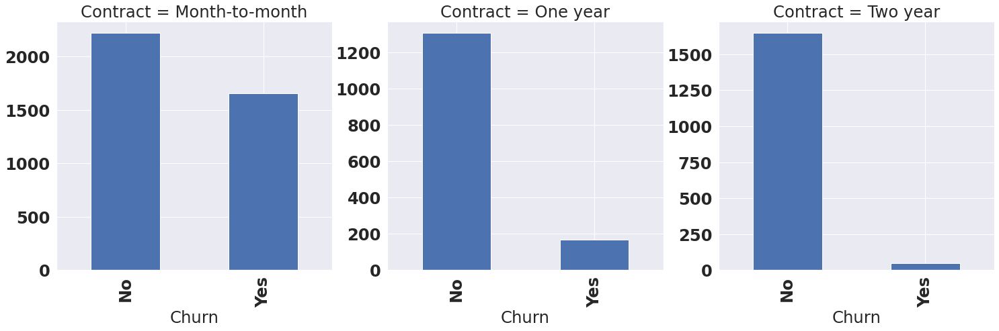

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('Contract = Month-to-month')
dataset.groupby('Contract').Churn.value_counts().loc['Month-to-month'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('Contract = One year')
dataset.groupby('Contract').Churn.value_counts().loc['One year'].plot(kind='bar')

plt.subplot(2,3,3)
plt.title('Contract = Two year')
dataset.groupby('Contract').Churn.value_counts().loc['Two year'].plot(kind='bar')

Paperless Billing

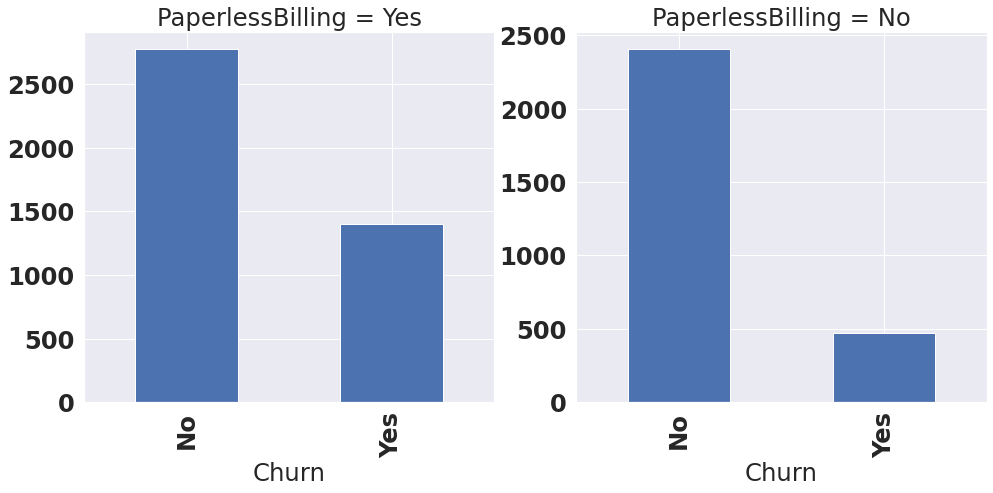

In [ ]:
plt.figure(figsize=(25,15))
plt.subplot(2,3,1)
plt.title('PaperlessBilling = Yes')
dataset.groupby('PaperlessBilling').Churn.value_counts().loc['Yes'].plot(kind='bar')

plt.subplot(2,3,2)
plt.title('PaperlessBilling = No')
dataset.groupby('PaperlessBilling').Churn.value_counts().loc['No'].plot(kind='bar')

Payment Method

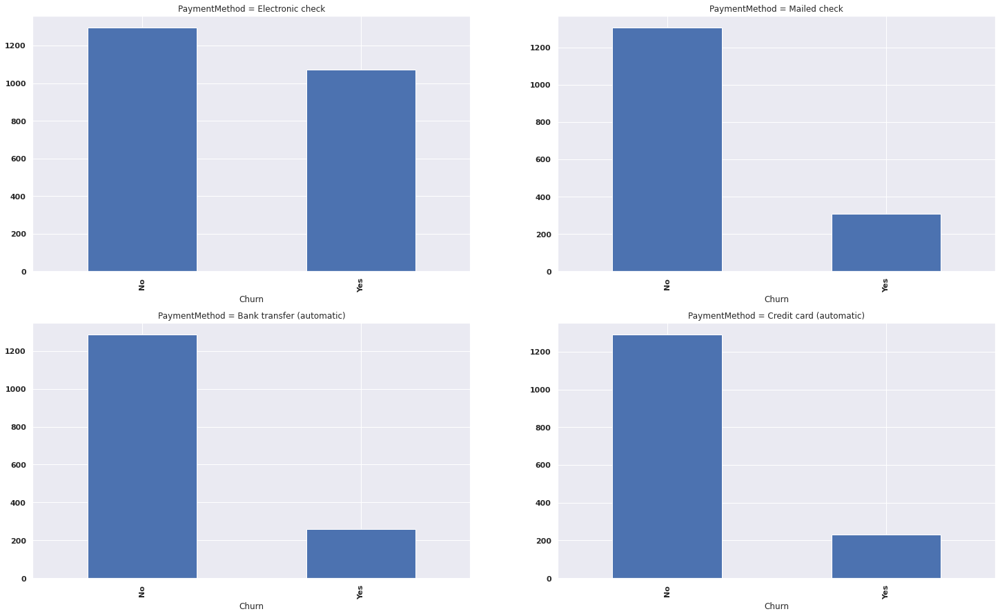

In [ ]:
plt.figure(figsize=(25,15))
sns.set_theme(style="darkgrid")

plt.subplot(2,2,1)
plt.title('PaymentMethod = Electronic check')
dataset.groupby('PaymentMethod').Churn.value_counts().loc['Electronic check'].plot(kind='bar')

plt.subplot(2,2,2)
plt.title('PaymentMethod = Mailed check')
dataset.groupby('PaymentMethod').Churn.value_counts().loc['Mailed check'].plot(kind='bar')

plt.subplot(2,2,3)
plt.title('PaymentMethod = Bank transfer (automatic)')
dataset.groupby('PaymentMethod').Churn.value_counts().loc['Bank transfer (automatic)'].plot(kind='bar')

plt.subplot(2,2,4)
plt.title('PaymentMethod = Credit card (automatic)')
dataset.groupby('PaymentMethod').Churn.value_counts().loc['Credit card (automatic)'].plot(kind='bar')

<a name="3.3"></a>
### 3.3 Numerical values, value ranges and distributions
Back to [Table of Contents](#0)

Text(0.5, 1.0, 'tenure Interval and Counts')

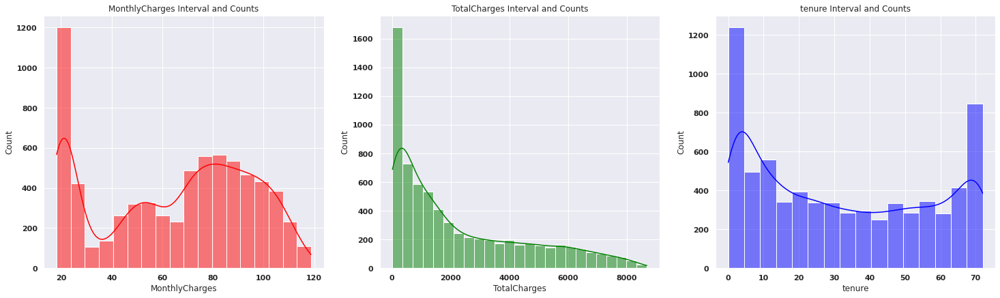

In [ ]:
plt.figure(figsize=(25,15))

plt.subplot(2,3,1)
sns.histplot(dataset['MonthlyCharges'], color = 'red', kde = True).set_title('MonthlyCharges Interval and Counts')

plt.subplot(2,3,2)
sns.histplot(dataset['TotalCharges'], color = 'green', kde = True).set_title('TotalCharges Interval and Counts')

plt.subplot(2,3,3)
sns.histplot(dataset['tenure'], color = 'blue', kde = True).set_title('tenure Interval and Counts')

The relationship between 'MonthlyCharges' and 'TotalCharges' and the correlation with 'gender' and 'tenure'.

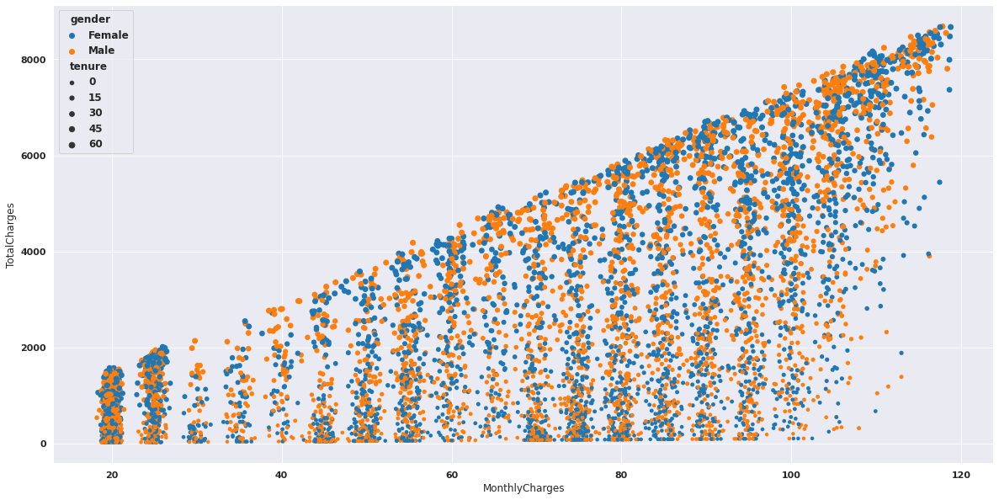

In [ ]:
# sns.set_style('darkgrid')
f, ax = plt.subplots(figsize=(20,10))
sns.despine(f, left=True, bottom=True)
sns.set_theme(style="darkgrid")
sns.scatterplot(x=dataset['MonthlyCharges'], y=dataset['TotalCharges'],
                hue=dataset['gender'], 
                size="tenure",
                palette='tab20',
                hue_order=dataset['gender'],
                sizes=(20, 50), 
                linewidth=0,
                data=dataset)

Distribution of Samples According to 'Churn' = Yes or 'Churn' = No with Histograms

In [ ]:
plt.rcParams["axes.labelsize"] = 20

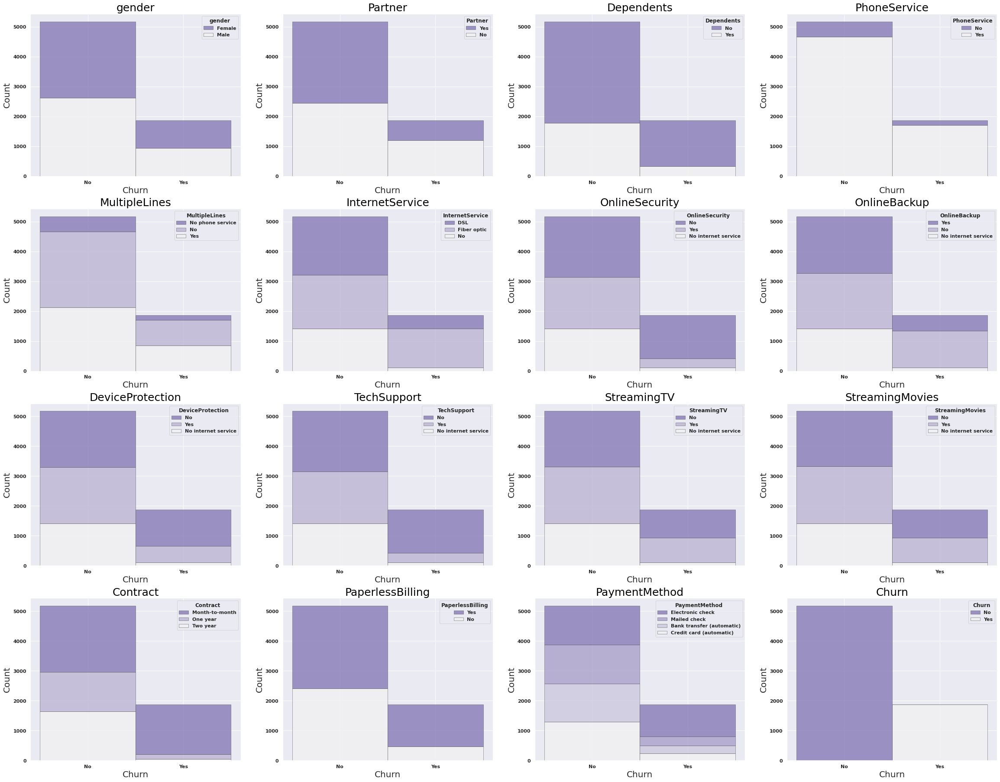

In [ ]:
plt.figure(figsize=(40,40))
j = 0
# sns.set_theme(style="whitegrid")

for i in categorical_list:
    
    plt.subplot(5,4,j+1)
    sns.histplot(dataset, x="Churn",  hue=dataset[i], multiple="stack", palette="light:m_r", edgecolor=".3", linewidth=.5)
    plt.title(f'{i}',color = 'black',fontsize = 25)
    j += 1

Correlation

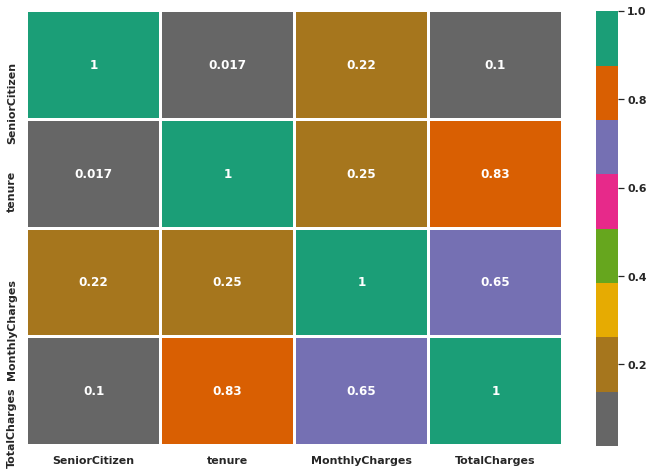

In [ ]:
plt.figure(figsize=(12,8)) 
sns.heatmap(dataset.corr(), annot=True, cmap='Dark2_r', linewidths = 2)
plt.show()

As seen from Heat Map, there is a high correlation between 'tenure' and 'TotalCharges'.

Another notable correlation is between 'MonthlyCharges' and 'TotalCharges'

Seaborn pairplot

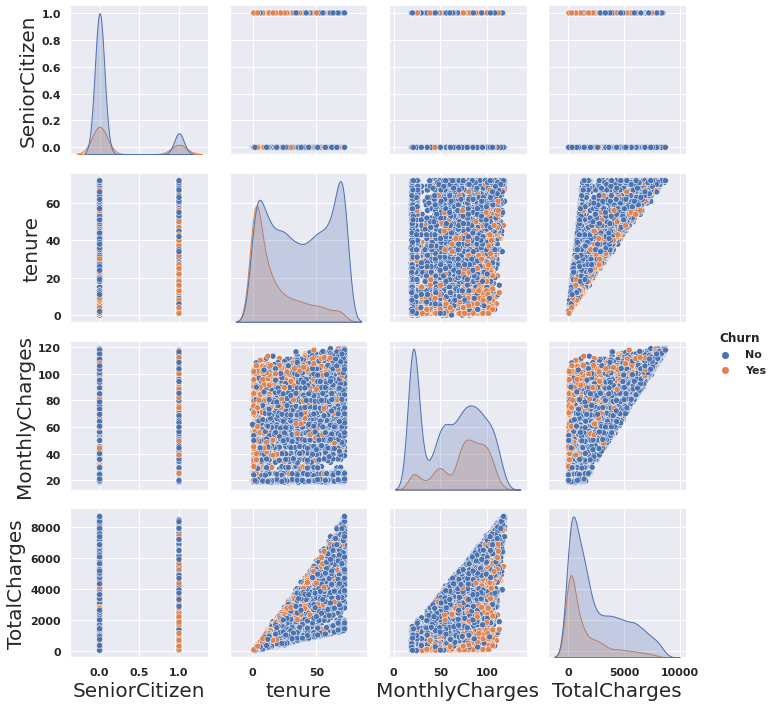

In [ ]:
sns.pairplot(dataset, hue = 'Churn')

Skewness

In [ ]:
dataset.agg(['skew'])

,SeniorCitizen,tenure,MonthlyCharges,TotalCharges
skew,1.833633,0.23954,-0.220524,0.961642


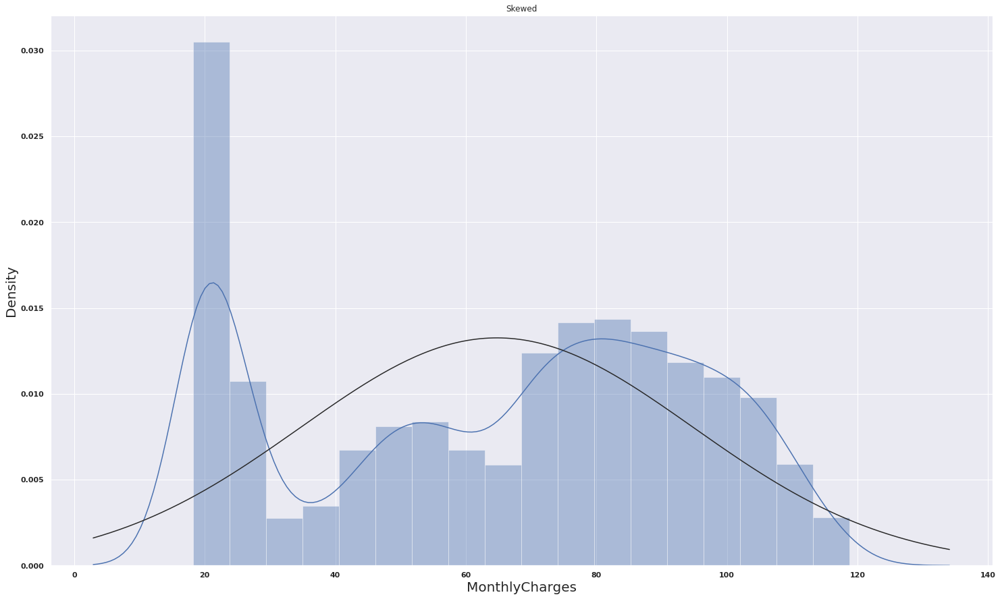

mu MonthlyCharges : 64.76169246059918, sigma MonthlyCharges : 30.087910854936975



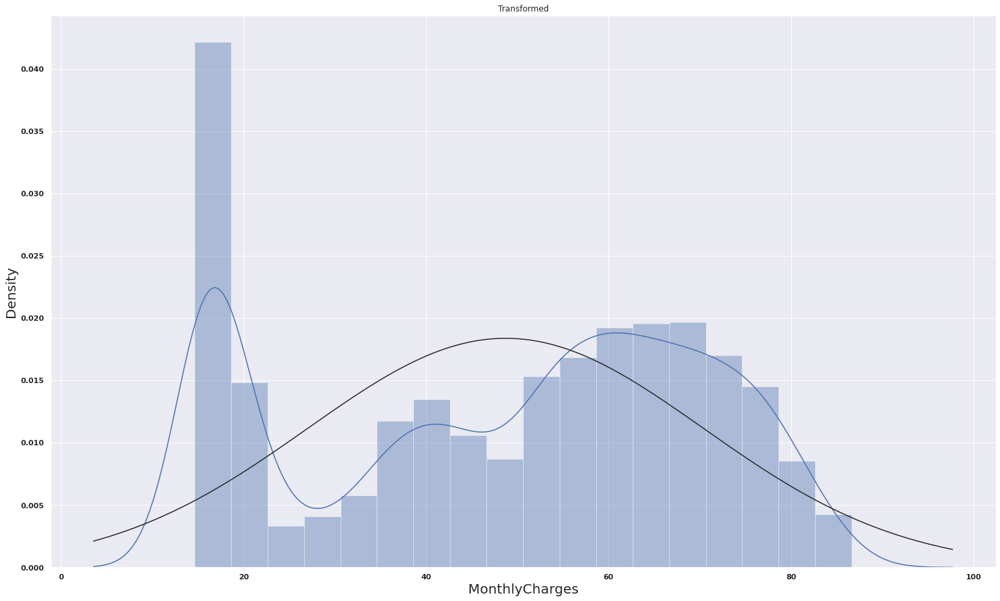

mu MonthlyCharges : 48.7129942491654, sigma MonthlyCharges : 21.702319308412328



In [ ]:
skews = ['MonthlyCharges']
from scipy.stats import norm, skew, boxcox
for i in skews:
    sns.set_style('darkgrid')
    sns.distplot(dataset[i], fit = norm)
    plt.title('Skewed')
    plt.show()
    (mu, sigma) = norm.fit(dataset[i])
    print("mu {} : {}, sigma {} : {}".format(i, mu, i, sigma))
    print()
    
    dataset[i], lam = boxcox(dataset[i])

    sns.set_style('darkgrid')
    sns.distplot(dataset[i], fit = norm)
    plt.title('Transformed')
    plt.show()
    (mu, sigma) = norm.fit(dataset[i])
    print("mu {} : {}, sigma {} : {}".format(i, mu, i, sigma))
    print()

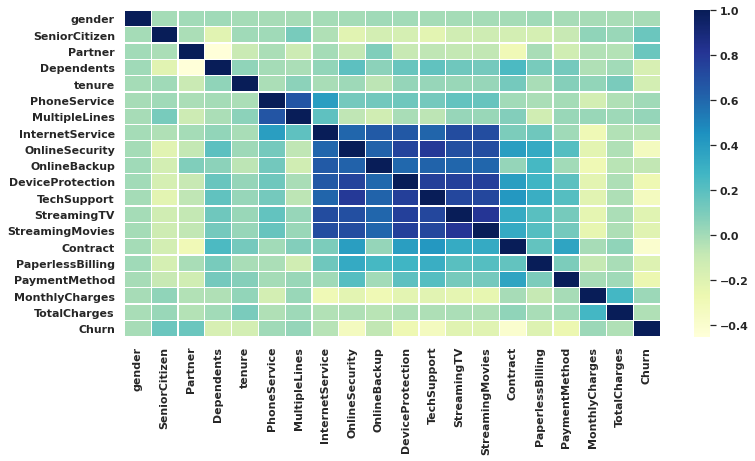

In [ ]:
plt.figure(figsize=(12, 6))
corr = df.apply(lambda x: pd.factorize(x)[0]).corr()
ax = sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, 
                 linewidths=.2, cmap="YlGnBu")

<a name="4"></a>
## 4 Modelling
Back to [Table of Contents](#0)

---


<a name="4.1"></a>
### 4.1 Encoding
Back to [Table of Contents](#0)

Uniqueness of each feature

In [ ]:
label_encoding = []
one_hot = []

for x in categorical_list:
    a = dataset[x].unique()
    print(f'Unique Values for {x}: ', dataset[x].unique())
    if(len(a) == 2):
        label_encoding.append(x)
    else:
        one_hot.append(x)

Unique Values for gender:  ['Female' 'Male']
Unique Values for Partner:  ['Yes' 'No']
Unique Values for Dependents:  ['No' 'Yes']
Unique Values for PhoneService:  ['No' 'Yes']
Unique Values for MultipleLines:  ['No phone service' 'No' 'Yes']
Unique Values for InternetService:  ['DSL' 'Fiber optic' 'No']
Unique Values for OnlineSecurity:  ['No' 'Yes' 'No internet service']
Unique Values for OnlineBackup:  ['Yes' 'No' 'No internet service']
Unique Values for DeviceProtection:  ['No' 'Yes' 'No internet service']
Unique Values for TechSupport:  ['No' 'Yes' 'No internet service']
Unique Values for StreamingTV:  ['No' 'Yes' 'No internet service']
Unique Values for StreamingMovies:  ['No' 'Yes' 'No internet service']
Unique Values for Contract:  ['Month-to-month' 'One year' 'Two year']
Unique Values for PaperlessBilling:  ['Yes' 'No']
Unique Values for PaymentMethod:  ['Electronic check' 'Mailed check' 'Bank transfer (automatic)'
 'Credit card (automatic)']
Unique Values for Churn:  ['No' 'Ye

**Label Encoding**

Label Encoding is an encoding technique for handling categorical variables. In this technique, each data is assigned a unique integer.

In [ ]:
for y in label_encoding:
    var = dataset[y].unique()
    y_mapping = {var[0]: 0, var[1]: 1}
    dataset[y] = dataset[y].map(y_mapping)

**One-Hot Encoding**

One Hot Encoding is the binary representation of categorical variables. This process requires categorical values to be mapped to integer values first. Next, each integer value is represented as a binary vector with all values zero except the integer index marked with 1.

One Hot Encoding makes the representation of categorical data more expressive and easy. Many machine learning algorithms cannot work directly with categorical data, so categories must be converted to numbers. This operation is required for input and output variables that are categorical.

In this part, I converted categorical datas to the binary values. This operation increases the accuracy.

In [ ]:
for i in range(0, len(one_hot)):
    dataset[f'{one_hot[i]}'] = pd.Categorical(dataset[f'{one_hot[i]}'])
    dummies = pd.get_dummies(dataset[f'{one_hot[i]}'], prefix = f'{one_hot[i]}_encoded')
    dataset.drop([f'{one_hot[i]}'], axis=1, inplace=True)
    dataset = pd.concat([dataset, dummies], axis=1)

In [ ]:
dataset

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,MultipleLines_encoded_No,MultipleLines_encoded_No phone service,MultipleLines_encoded_Yes,InternetService_encoded_DSL,InternetService_encoded_Fiber optic,InternetService_encoded_No,OnlineSecurity_encoded_No,OnlineSecurity_encoded_No internet service,OnlineSecurity_encoded_Yes,OnlineBackup_encoded_No,OnlineBackup_encoded_No internet service,OnlineBackup_encoded_Yes,DeviceProtection_encoded_No,DeviceProtection_encoded_No internet service,DeviceProtection_encoded_Yes,TechSupport_encoded_No,TechSupport_encoded_No internet service,TechSupport_encoded_Yes,StreamingTV_encoded_No,StreamingTV_encoded_No internet service,StreamingTV_encoded_Yes,StreamingMovies_encoded_No,StreamingMovies_encoded_No internet service,StreamingMovies_encoded_Yes,Contract_encoded_Month-to-month,Contract_encoded_One year,Contract_encoded_Two year,PaymentMethod_encoded_Bank transfer (automatic),PaymentMethod_encoded_Credit card (automatic),PaymentMethod_encoded_Electronic check,PaymentMethod_encoded_Mailed check
0,0,0,0,0,1,0,0,23.578295,29.85,0,0,1,0,1,0,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0
1,1,0,1,0,34,1,1,43.571734,1889.50,0,1,0,0,1,0,0,0,0,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1
2,1,0,1,0,2,1,0,41.332735,108.15,1,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1
3,1,0,1,0,45,0,1,32.892530,1840.75,0,0,1,0,1,0,0,0,0,1,1,0,0,0,0,1,0,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0
4,0,0,1,0,2,1,0,53.391036,151.65,1,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1,0,0,1,24,1,0,63.300009,1990.50,0,0,0,1,1,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,0,0,0,1
7039,0,0,0,1,72,1,0,76.033726,7362.90,0,0,0,1,0,1,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,1,0,0
7040,0,0,0,1,11,0,0,23.388387,346.45,0,0,1,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0
7041,1,1,0,0,4,1,0,56.005603,306.60,1,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1


<a name="4.2"></a>
### 4.2 Train-test split
Back to [Table of Contents](#0)

In [ ]:
dataset.fillna(dataset.mean(), inplace=True)

In [ ]:
columns = dataset.columns.drop('Churn')

In [ ]:
features = columns
label = ['Churn']

X = dataset[features]
y = dataset[label]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0) 
X_valid, X_test, y_valid, y_test = train_test_split(X_test, y_test, test_size=0.5, random_state=0)

print(f'Total # of sample in whole dataset: {len(X)}')
print(f'Total # of sample in train dataset: {len(X_train)}')
print(f'Total # of sample in validation dataset: {len(X_valid)}')
print(f'Total # of sample in test dataset: {len(X_test)}')

Total # of sample in whole dataset: 7043
Total # of sample in train dataset: 5634
Total # of sample in validation dataset: 704
Total # of sample in test dataset: 705


<a name="4.3"></a>
### 4.3 Building ML Pipelines
Back to [Table of Contents](#0)

In [ ]:
pipeline_GaussianNB = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_GaussianNB",GaussianNB())])

pipeline_BernoulliNB = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_BernoulliNB",BernoulliNB())])

pipeline_LogisticRegression = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_LogisticRegression",LogisticRegression())])

pipeline_RandomForest = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_RandomForest",RandomForestClassifier())])

pipeline_SVM = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_SVM",SVC())])

pipeline_DecisionTree = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_DecisionTree",DecisionTreeClassifier())])

pipeline_KNN = Pipeline([("scaler",StandardScaler()),
                     ("pipeline_KNN",KNeighborsClassifier())])

pipeline_GBC = Pipeline([("scaler",StandardScaler()), (
                        "pipeline_GBC",GradientBoostingClassifier())])

pipeline_SGD = Pipeline([("scaler",StandardScaler()), 
                        ("pipeline_SGD",SGDClassifier(max_iter=5000, random_state=0))])

pipeline_LGBM = Pipeline([("scaler",StandardScaler()), 
                        ("pipeline_NN",lightgbm.LGBMClassifier())])

pipelines = [pipeline_GaussianNB, pipeline_BernoulliNB, pipeline_LogisticRegression, pipeline_RandomForest, pipeline_SVM, pipeline_DecisionTree, pipeline_KNN, pipeline_GBC, pipeline_SGD, pipeline_LGBM]

pipe_dict = {0: "GaussianNB", 1: "BernoulliNB", 2: "LogisticRegression",3: "RandomForestClassifier", 4: "SupportVectorMachine", 5: "DecisionTreeClassifier",
            6: "KNeighborsClassifier", 7: "GradientBoostingClassifier", 8:"Stochastic Gradient Descent", 9: "LGBM"}

modelNames = ["GaussianNB", 'BernoulliNB','LogisticRegression','RandomForestClassifier','SupportVectorMachine',
             'DecisionTreeClassifier', 'KNeighborsClassifier','GradientBoostingClassifier',
             'Stochastic Gradient Descent', 'LGBM']

i= 0
trainScores = []
validationScores = []
testScores = []

for pipe in pipelines:
    pipe.fit(X_train, y_train)
    print(f'{pipe_dict[i]}')
    print("Train Score of %s: %f     " % (pipe_dict[i], pipe.score(X_train, y_train)*100))
    trainScores.append(pipe.score(X_train, y_train)*100)
    
    print("Validation Score of %s: %f" % (pipe_dict[i], pipe.score(X_valid, y_valid)*100))
    validationScores.append(pipe.score(X_valid, y_valid)*100)
    
    print("Test Score of %s: %f      " % (pipe_dict[i], pipe.score(X_test, y_test)*100))
    testScores.append(pipe.score(X_test, y_test)*100)
    print(" ")
    
    y_predictions = pipe.predict(X_test)
    conf_matrix = confusion_matrix(y_predictions, y_test)
    print(f'Confussion Matrix: \n{conf_matrix}\n')
    
    tn = conf_matrix[0,0]
    fp = conf_matrix[0,1]
    tp = conf_matrix[1,1]
    fn = conf_matrix[1,0]

    total = tn + fp + tp + fn
    real_positive = tp + fn
    real_negative = tn + fp

    accuracy  = (tp + tn) / total # Accuracy Rate
    precision = tp / (tp + fp) # Positive Predictive Value
    recall    = tp / (tp + fn) # True Positive Rate
    f1score  = 2 * precision * recall / (precision + recall)
    specificity = tn / (tn + fp) # True Negative Rate
    error_rate = (fp + fn) / total # Missclassification Rate
    prevalence = real_positive / total
    miss_rate = fn / real_positive # False Negative Rate
    fall_out = fp / real_negative # False Positive Rate
    
    print('Evaluation Metrics:')
    print(f'Accuracy    : {accuracy}')
    print(f'Precision   : {precision}')
    print(f'Recall      : {recall}')
    print(f'F1 score    : {f1score}')
    print(f'Specificity : {specificity}')
    print(f'Error Rate  : {error_rate}')
    print(f'Prevalence  : {prevalence}')
    print(f'Miss Rate   : {miss_rate}')
    print(f'Fall Out    : {fall_out}')

    print("") 
    print(f'Classification Report: \n{classification_report(y_predictions, y_test)}\n')
    print("")

    print("*****"*20)
    i +=1

GaussianNB
Train Score of GaussianNB: 70.376287     
Validation Score of GaussianNB: 70.028409
Test Score of GaussianNB: 67.517730      
 
Confussion Matrix: 
[[317  35]
 [194 159]]

Evaluation Metrics:
Accuracy    : 0.675177304964539
Precision   : 0.8195876288659794
Recall      : 0.45042492917847027
F1 score    : 0.5813528336380256
Specificity : 0.9005681818181818
Error Rate  : 0.324822695035461
Prevalence  : 0.500709219858156
Miss Rate   : 0.5495750708215298
Fall Out    : 0.09943181818181818

Classification Report: 
              precision    recall  f1-score   support

           0       0.62      0.90      0.73       352
           1       0.82      0.45      0.58       353

    accuracy                           0.68       705
   macro avg       0.72      0.68      0.66       705
weighted avg       0.72      0.68      0.66       705



****************************************************************************************************
BernoulliNB
Train Score of BernoulliNB: 72.932

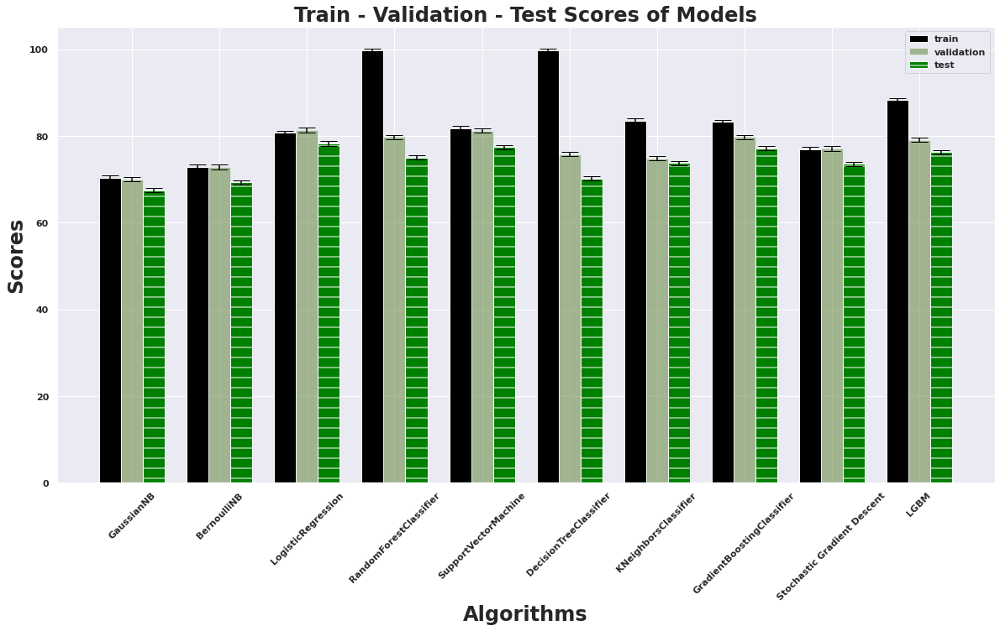

In [ ]:
plt.figure(figsize=(20,10))
sns.set_style('darkgrid')
plt.title('Train - Validation - Test Scores of Models', fontweight='bold', size = 24)
plt.rcParams["axes.labelsize"] = 30

barWidth = 0.25
 
bars1 = trainScores
bars2 = validationScores
bars3 = testScores
 
r1 = np.arange(len(bars1))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
 
plt.bar(r1, bars1, color='black', width=barWidth, edgecolor='white', label='train', yerr=0.5,ecolor="black",capsize=10)
plt.bar(r2, bars2, color='#557f2d', width=barWidth, edgecolor='white', label='validation', yerr=0.5,ecolor="black",capsize=10, alpha = .50)
plt.bar(r3, bars3, color='green', width=barWidth, edgecolor='white', label='test', yerr=0.5,ecolor="black",capsize=10, hatch = '-')
 
modelNames = ["GaussianNB", 'BernoulliNB','LogisticRegression','RandomForestClassifier','SupportVectorMachine',
             'DecisionTreeClassifier', 'KNeighborsClassifier','GradientBoostingClassifier',
             'Stochastic Gradient Descent', 'LGBM']
    
plt.xlabel('Algorithms', fontweight='bold', size = 24)
plt.ylabel('Scores', fontweight='bold', size = 24)
plt.xticks([r + barWidth for r in range(len(bars1))], modelNames, rotation = 45)
 
plt.legend()
plt.show()

In [ ]:
table = pd.DataFrame({'Model': modelNames, 'Train': trainScores, 'Validation': validationScores, 'Test': testScores})
table

,Model,Train,Validation,Test
0,GaussianNB,70.376287,70.028409,67.517730
1,BernoulliNB,72.932197,72.869318,69.361702
2,LogisticRegression,80.795172,81.392045,78.297872
3,RandomForestClassifier,99.751509,79.829545,75.035461
4,SupportVectorMachine,81.824636,81.250000,77.446809
5,DecisionTreeClassifier,99.751509,75.852273,70.212766
6,KNeighborsClassifier,83.510827,74.857955,73.758865
7,GradientBoostingClassifier,83.297835,79.829545,77.163121
8,Stochastic Gradient Descent,76.979056,77.130682,73.617021
9,LGBM,88.338658,79.119318,76.312057


<a name="5"></a>
## 5 Refinement
Back to [Table of Contents](#0)

---


<a name="5.1"></a>
### 5.1 Cross Validation
Back to [Table of Contents](#0)

In [ ]:
cv_results_acc = []

for i, model in enumerate(pipelines):
    cv_score = cross_val_score(model, X_train, y_train, scoring = "accuracy", cv = 10)
    cv_results_acc.append(cv_score.mean()*100)
    print("%s: %f" % (pipe_dict[i], cv_score.mean()*100))

GaussianNB: 70.446695
BernoulliNB: 72.949278
LogisticRegression: 80.386512
RandomForestClassifier: 79.924701
SupportVectorMachine: 79.765724
DecisionTreeClassifier: 73.216054
KNeighborsClassifier: 75.665161
GradientBoostingClassifier: 80.564195
Stochastic Gradient Descent: 76.535971
LGBM: 79.853716


In [ ]:
table_cv = pd.DataFrame({'Model': modelNames, 'CV Score': cv_results_acc})
table_cv

,Model,CV Score
0,GaussianNB,70.446695
1,BernoulliNB,72.949278
2,LogisticRegression,80.386512
3,RandomForestClassifier,79.924701
4,SupportVectorMachine,79.765724
5,DecisionTreeClassifier,73.216054
6,KNeighborsClassifier,75.665161
7,GradientBoostingClassifier,80.564195
8,Stochastic Gradient Descent,76.535971
9,LGBM,79.853716


No handles with labels found to put in legend.


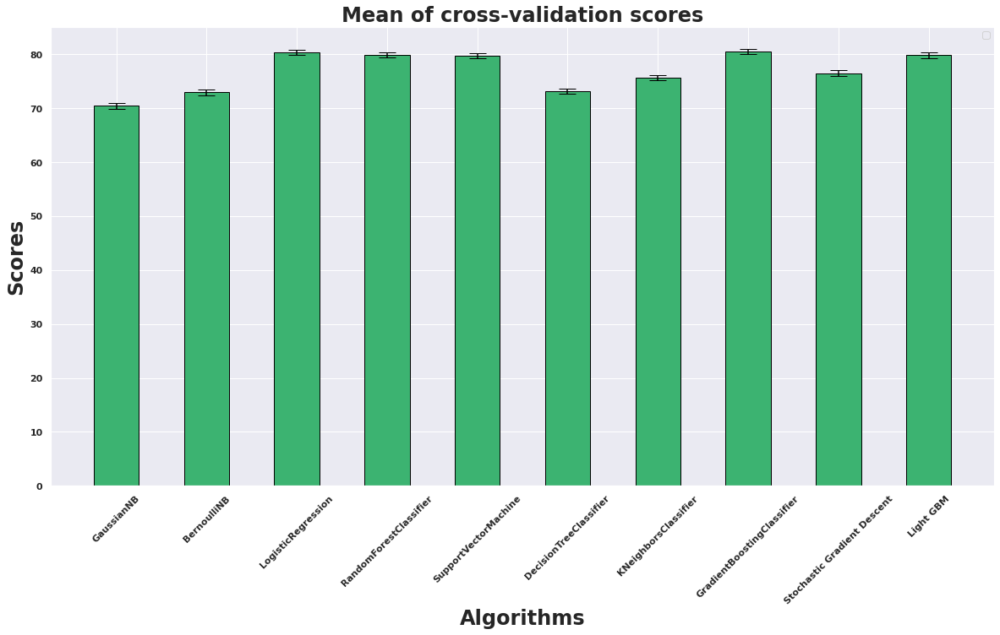

In [ ]:
plt.figure(figsize=(20,10))
sns.set_style('darkgrid')
plt.title('Mean of cross-validation scores', fontweight='bold', size = 24)

barWidth = 0.5
 
bars2 = cv_results_acc
 
r1 = np.arange(len(bars1))
r2 = [x + barWidth for x in r1]
 
plt.bar(r2, bars2, color='#3CB371', width=barWidth, edgecolor='black',  yerr=0.5,ecolor="black",capsize=10)


modelNames = ["GaussianNB", 'BernoulliNB','LogisticRegression','RandomForestClassifier','SupportVectorMachine',
             'DecisionTreeClassifier', 'KNeighborsClassifier','GradientBoostingClassifier',
             'Stochastic Gradient Descent', 'Light GBM']
    
plt.xlabel('Algorithms', fontweight='bold', size = 24)
plt.ylabel('Scores', fontweight='bold', size = 24)
plt.xticks([r + barWidth for r in range(len(bars1))], modelNames, rotation = 45)
 
plt.legend()
plt.show()

<a name="5.2"></a>
### 5.2 Best Features Selection
Back to [Table of Contents](#0)

In [ ]:
sc=StandardScaler()

X_train = sc.fit_transform(X_train)
X_valid = sc.fit_transform(X_valid)
X_test = sc.transform(X_test)

RandomForestClassifier
Old Shape: (7043, 40) New shape: (7043, 8)




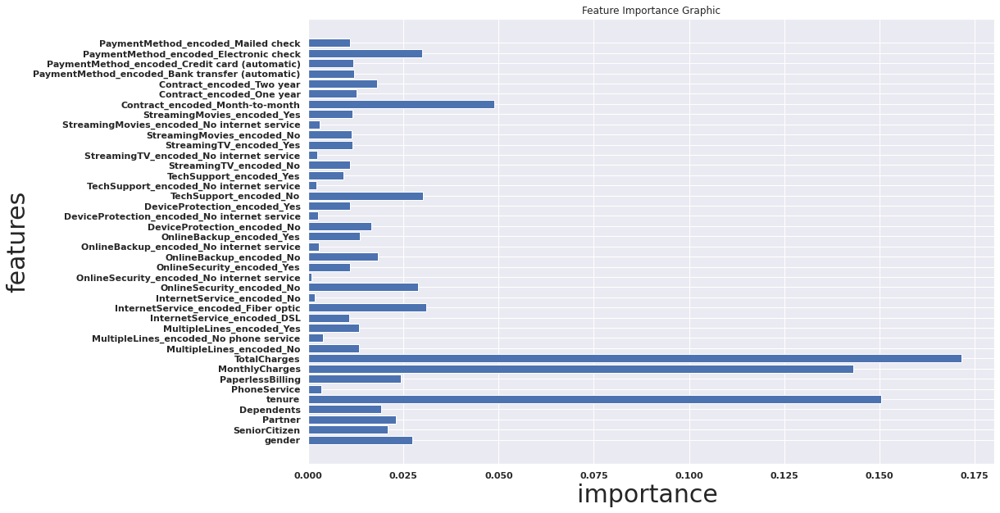

DecisionTreeClassifier
Old Shape: (7043, 40) New shape: (7043, 5)




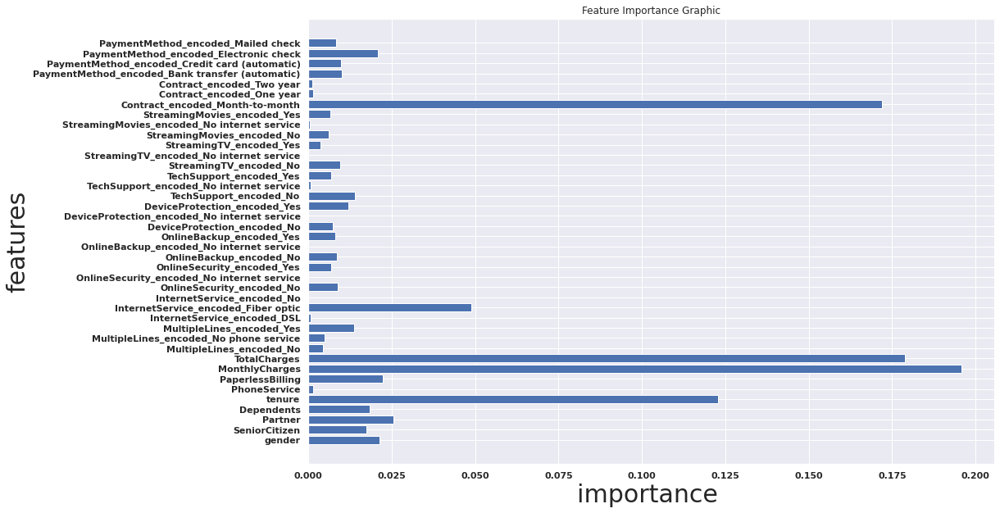

GradientBoostingClassifier
Old Shape: (7043, 40) New shape: (7043, 8)




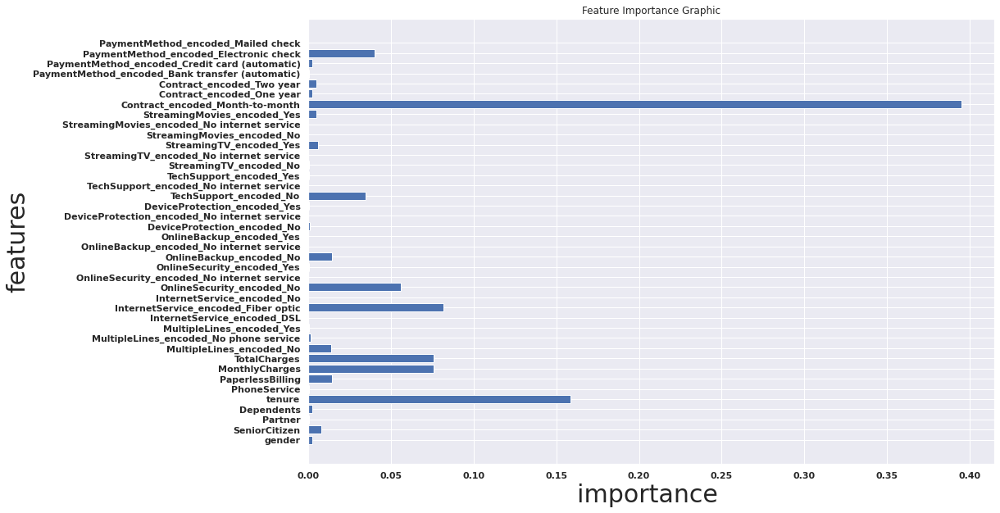

Light GBM
Old Shape: (7043, 40) New shape: (7043, 5)




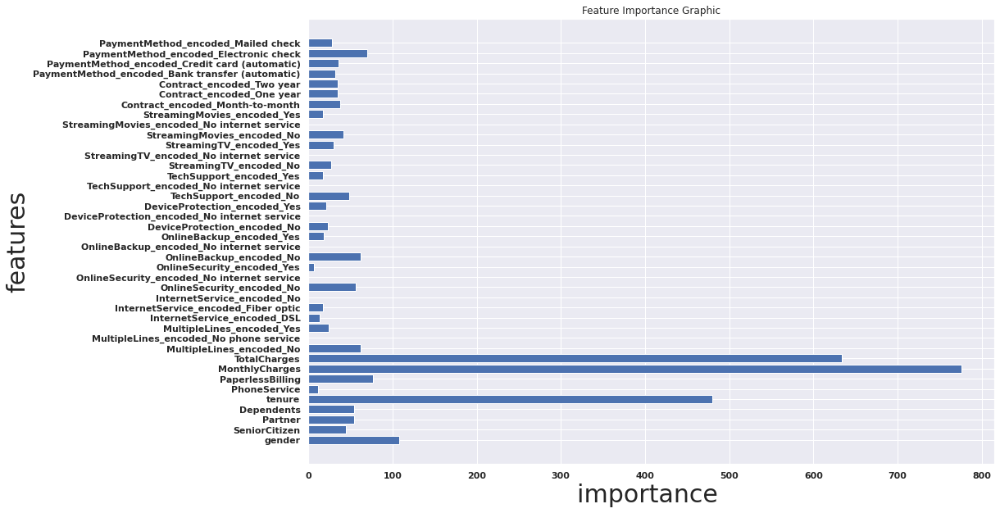

In [ ]:
models = {
    'RandomForestClassifier': RandomForestClassifier(),
    'DecisionTreeClassifier': DecisionTreeClassifier(),
    'GradientBoostingClassifier': GradientBoostingClassifier(),
    'Light GBM': lightgbm.LGBMClassifier(),
}

for m in models:
  model = models[m]
  model.fit(X_train, y_train)
  
  print(f'{m}') 
  best_features = SelectFromModel(model)
  best_features.fit(X, y)

  transformedX = best_features.transform(X)
  print(f"Old Shape: {X.shape} New shape: {transformedX.shape}")
  print("\n")

  imp_feature = pd.DataFrame({'Feature': features, 'Importance': model.feature_importances_})
  plt.figure(figsize=(15,10))
  plt.title("Feature Importance Graphic")
  plt.xlabel("importance ")
  plt.ylabel("features")
  plt.barh(imp_feature['Feature'],imp_feature['Importance'])
  plt.show()

In [ ]:
models = {
    'BernoulliNB': BernoulliNB(),
    'LogisticRegression': LogisticRegression(),
    'Stochastic Gradient Descent':  SGDClassifier(max_iter=5000, random_state=0),
}

for m in models:
  model = models[m]
  model.fit(X_train, y_train)
  
  print(f'{m}') 
  best_features = SelectFromModel(model)
  best_features.fit(X, y)

  transformedX = best_features.transform(X)
  print(f"Old Shape: {X.shape} New shape: {transformedX.shape}")
  print("\n")

BernoulliNB
Old Shape: (7043, 40) New shape: (7043, 19)


LogisticRegression
Old Shape: (7043, 40) New shape: (7043, 16)


Stochastic Gradient Descent
Old Shape: (7043, 40) New shape: (7043, 14)




Gradient Boosting Classifier

In [ ]:
gbc_model = GradientBoostingClassifier()
gbc_model.fit(X_train, y_train)

train_score = gbc_model.score(X_train, y_train)
print(f'Train score of trained model: {train_score*100}')

validation_score = gbc_model.score(X_valid, y_valid)
print(f'Validation score of trained model: {validation_score*100}')

test_score = gbc_model.score(X_test, y_test)
print(f'Test score of trained model: {test_score*100}')

Train score of trained model: 83.12034078807243
Validation score of trained model: 79.9715909090909
Test score of trained model: 76.87943262411348


Confusion matrix

Accuracy: 76.87943262411348

Confussion matrix: 
[[443  95]
 [ 68  99]]



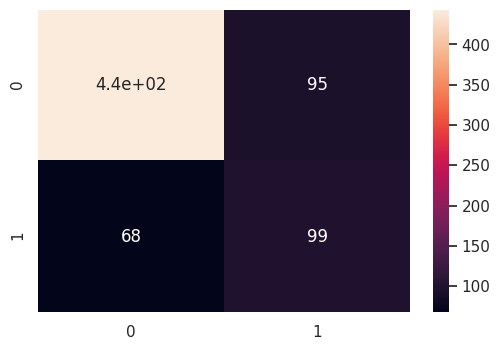

In [ ]:
y_predictions = gbc_model.predict(X_test)

conf_matrix = confusion_matrix(y_predictions, y_test)

print(f'Accuracy: {accuracy_score(y_predictions, y_test)*100}')
print()
print(f'Confussion matrix: \n{conf_matrix}\n')

sns.heatmap(conf_matrix, annot=True)

In [ ]:
tn = conf_matrix[0,0]
fp = conf_matrix[0,1]
tp = conf_matrix[1,1]
fn = conf_matrix[1,0]

total = tn + fp + tp + fn
real_positive = tp + fn
real_negative = tn + fp

In [ ]:
accuracy  = (tp + tn) / total # Accuracy Rate
precision = tp / (tp + fp) # Positive Predictive Value
recall    = tp / (tp + fn) # True Positive Rate
f1score  = 2 * precision * recall / (precision + recall)
specificity = tn / (tn + fp) # True Negative Rate
error_rate = (fp + fn) / total # Missclassification Rate
prevalence = real_positive / total
miss_rate = fn / real_positive # False Negative Rate
fall_out = fp / real_negative # False Positive Rate

print(f'Accuracy    : {accuracy}')
print(f'Precision   : {precision}')
print(f'Recall      : {recall}')
print(f'F1 score    : {f1score}')
print(f'Specificity : {specificity}')
print(f'Error Rate  : {error_rate}')
print(f'Prevalence  : {prevalence}')
print(f'Miss Rate   : {miss_rate}')
print(f'Fall Out    : {fall_out}')

Accuracy    : 0.7687943262411348
Precision   : 0.5103092783505154
Recall      : 0.592814371257485
F1 score    : 0.5484764542936288
Specificity : 0.8234200743494424
Error Rate  : 0.23120567375886525
Prevalence  : 0.23687943262411348
Miss Rate   : 0.40718562874251496
Fall Out    : 0.17657992565055763


Classification Report

In [ ]:
predictions = gbc_model.predict(X_test)

print(classification_report(predictions, y_test))

              precision    recall  f1-score   support

           0       0.87      0.82      0.84       538
           1       0.51      0.59      0.55       167

    accuracy                           0.77       705
   macro avg       0.69      0.71      0.70       705
weighted avg       0.78      0.77      0.77       705



ROC Curve

In [ ]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

def plot_roc_curve(fpr, tpr):
    plt.plot(fpr, tpr, color='orange', label='ROC' )
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()

In [ ]:
probs = gbc_model.predict_proba(X_test)
probs = probs[:, 1]

In [ ]:
auc = roc_auc_score(y_test, probs)
print('AUC: ', auc*100)

AUC:  81.71464885911998


No handles with labels found to put in legend.


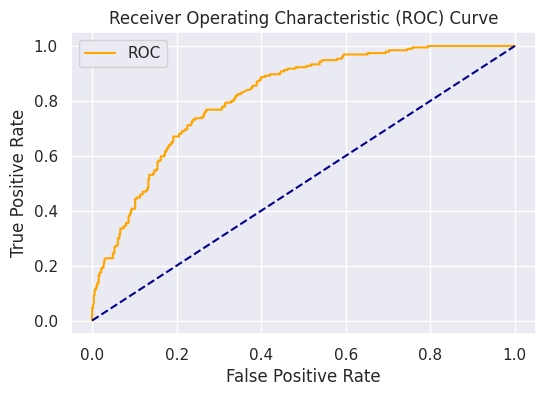

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, probs)
plt.legend(loc = 'lower right')
plot_roc_curve(fpr, tpr)

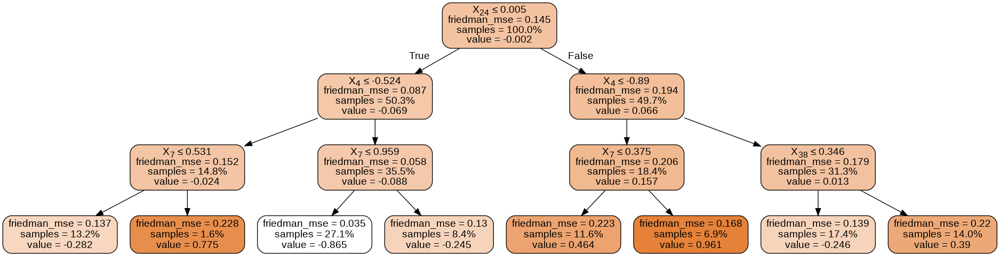

In [ ]:
#####
# This code snippet was taken from this url: https://stackoverflow.com/questions/44974360/how-to-visualize-an-sklearn-gradientboostingclassifier
#####

import pydotplus
from sklearn.tree import export_graphviz
from pydotplus import graph_from_dot_data
from IPython.display import Image

sub_tree = gbc_model.estimators_[10, 0]
dot_data = export_graphviz(sub_tree, out_file=None, filled=True, 
                           rounded=True, special_characters=True, proportion=True, impurity=True)

graph = graph_from_dot_data(dot_data)
Image(graph.create_png())

<a name="6"></a>
## 6 Hyperparameter Tuning
Back to [Table of Contents](#0)

---


<a name="6.1"></a>
### 6.1 Preprocessing
Back to [Table of Contents](#0)

In this notebook we will be using ensemble methods to predict if a customer left the company in the last month. The goal of ensemble methods is to combine the predictions of several base estimators built with a given learning algorithm in order to improve robustness. There are two general categories of ensemble methods: averaging and boosting methods. Decision trees will be used as our base estimator for both.

In [ ]:
import random
import pprint
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, accuracy_score, recall_score, precision_score
import warnings
warnings.simplefilter(action='ignore', category=UserWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)
df = telecomDf.copy(deep = True)

In [ ]:
def preprocessing(df):
    """Preprocess df and return X (train features) and Y (target feature)."""
    # Impute missing values on TotalCharges
    df['TotalCharges'] = df['TotalCharges'].replace(" ", 0).astype('float32')
    # Drop customer id
    df.drop(['customerID'], axis=1, inplace=True)
    # Encode categorical features
    cat_cols = [c for c in df.columns if df[c].dtype == 'object' or c == 'SeniorCitizen']
    for col in cat_cols:
        if df[col].nunique() == 2:
            df[col], _ = pd.factorize(df[col])
        else:
            df = pd.get_dummies(df, columns=[col])
    # Drop target column and some correlated features
    drop_features = ['OnlineSecurity_No internet service', 'OnlineBackup_No internet service',
                     'DeviceProtection_No internet service', 'TechSupport_No internet service',
                     'StreamingTV_No internet service', 'StreamingMovies_No internet service',
                     'PhoneService', 'Churn']
    feats = [c for c in df.columns if c not in drop_features]
    return df[feats], df['Churn']
x, y = preprocessing(df)
x.head(3)

,gender,SeniorCitizen,Partner,Dependents,tenure,PaperlessBilling,MonthlyCharges,TotalCharges,MultipleLines_No,MultipleLines_No phone service,MultipleLines_Yes,InternetService_DSL,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No,OnlineSecurity_Yes,OnlineBackup_No,OnlineBackup_Yes,DeviceProtection_No,DeviceProtection_Yes,TechSupport_No,TechSupport_Yes,StreamingTV_No,StreamingTV_Yes,StreamingMovies_No,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,0,0,0,0,1,0,29.85,29.850000,0,1,0,1,0,0,1,0,0,1,1,0,1,0,1,0,1,0,1,0,0,0,0,1,0
1,1,0,1,0,34,1,56.95,1889.500000,1,0,0,1,0,0,0,1,1,0,0,1,1,0,1,0,1,0,0,1,0,0,0,0,1
2,1,0,1,0,2,0,53.85,108.150002,1,0,0,1,0,0,0,1,0,1,1,0,1,0,1,0,1,0,1,0,0,0,0,0,1


Split data: Divide our data in 80% for training and 20% for our final test.

In [ ]:
# Split dataset in train and test
train_x, test_x, train_y, test_y = train_test_split(x, y, test_size=0.2, random_state=50)
# Create a training and testing dataset (lightgbm api object)
train_set = lgb.Dataset(data= train_x, label= train_y, silent=-1)
test_set = lgb.Dataset(data= test_x, label= test_y, silent=-1)

<a name="6.2"></a>
### 6.2 Utility Functions for Hyperparameter Tuning
Back to [Table of Contents](#0)



We have to define many hyperparameters since we have the ensemble estimator and the base estimator. Instead of doing this by hand, the next function will randomly pick a set of parameters and test it with a KFold cross-validation scheme. The LightGBM library has a built-in function to easily implement this validation method.

The procedure can be described with the following steps:

- Randomly pick a subset of hyperparameters
- Train and validate our model with KFold cross-validation (second function)
- Repeat this procedure MAX_EVALS times
- Get the best cross-validation score and hyperparameters


Early stopping will be used to stop the algorithm when the validation score doesn't improve for 50 boosting rounds.

In [ ]:
def hyperparameter_random_search(train_set, params_grid, fixed_params, max_evals,
                                 num_folds, print_params=False):
    """Random search for hyperparameter optimization"""
    # Dataframe for results
    results = pd.DataFrame(columns = ['score', 'params', 'iteration'],
                                  index = list(range(max_evals)))
    
    # Keep searching until reach max evaluations
    for i in range(max_evals):
        # Choose random hyperparameters
        hyperparameters = {k: random.sample(v, 1)[0] for k, v in params_grid.items()}
        hyperparameters.update(fixed_params)
        if print_params:
            print(hyperparameters)
        # Evaluate randomly selected hyperparameters
        eval_results = objective(train_set, hyperparameters, i, num_folds)
        # Add results to our dataframe
        results.loc[i, :] = eval_results
    # Sort with best score on top
    results.sort_values('score', ascending=False, inplace=True)
    results.reset_index(inplace=True)
    return results

def objective(train_set, hyperparameters, iteration, num_folds):
    """Objective function for grid and random search. Returns
       the cross-validation score from a set of hyperparameters."""

     # Perform n_folds cross validation
    hyperparameters['verbose'] = -1
    cv_results = lgb.cv(hyperparameters, train_set, num_boost_round=10000, nfold=num_folds,
                        early_stopping_rounds=50, metrics ='auc', seed=50)
    score = cv_results['auc-mean'][-1]
    estimators = len(cv_results['auc-mean'])
    hyperparameters['n_estimators'] = estimators 
    return score, hyperparameters, iteration

<a name="6.3"></a>
### 6.3 Random Forest
Back to [Table of Contents](#0)



The idea behind Random Forests is to build multiple decision trees and merges them together to get a more accurate and stable prediction. In each estimator, only a random subset of the features is taken into consideration for splitting a node, therefore adding additional randomness to the final model. Random Forests can be considered an averaging ensemble method.

In [ ]:
params_grid = {
    'num_leaves': list(range(8, 255)),  # Control tree size
    # Percentage (sample) of columns and rows
    'colsample_bytree': list(np.linspace(0.4, 0.99)),
    'subsample': list(np.linspace(0.4, 0.99)),
    # Min data points to create a leaf
    'min_child_samples': list(range(1, 101, 5)),
    # Regularization
    'reg_alpha': list(np.linspace(0, 1)),
    'reg_lambda': list(np.linspace(0, 1)),
}

fixed_params = {'boosting_type': 'rf', 'objective': 'binary',
                'subsample_freq': 1, 'n_jobs':4}
res = hyperparameter_random_search(train_set, params_grid, fixed_params, 1000, 5)
res.head()

,index,score,params,iteration
0,182,0.849026,"{'num_leaves': 32, 'colsample_bytree': 0.56857...",182
1,179,0.848987,"{'num_leaves': 253, 'colsample_bytree': 0.5204...",179
2,84,0.848944,"{'num_leaves': 189, 'colsample_bytree': 0.5083...",84
3,575,0.848897,"{'num_leaves': 132, 'colsample_bytree': 0.5204...",575
4,127,0.848819,"{'num_leaves': 42, 'colsample_bytree': 0.52040...",127


Testing the model

In [ ]:
# Create, train, test model
model = lgb.LGBMClassifier(**res.loc[0, 'params'], random_state=50)
model.fit(train_x.values, train_y.values)
predict_proba = model.predict_proba(test_x.values)[:, 1]
predict_labels = model.predict(test_x.values)

# Print final results
print("Scores on test set: {:.4f} ROC AUC,  {:.4f} accuracy, {:.4f} recall, {:.4f} precision"
      .format(roc_auc_score(test_y, predict_proba),
              accuracy_score(test_y, predict_labels),
              recall_score(test_y, predict_labels), 
              precision_score(test_y, predict_labels)))

Scores on test set: 0.8437 ROC AUC,  0.7970 accuracy, 0.5652 recall, 0.6228 precision


<a name="6.4"></a>
### 6.4 Gradient Boosting
Back to [Table of Contents](#0)



In gradient boosting, the predictors are not made independently, but sequentially. In each iteration, a decision tree is fit on the error from the previous round. It's usually better to use shallow trees (weak learners) and a low learning rate, so each iteration does small improvements to the overall problem.

In [ ]:
# Possible hyperparameters (grid)
param_grid = {
    'num_leaves': list(range(7, 95)),
    'learning_rate': list(np.logspace(np.log(0.005), np.log(0.2))),
    'subsample_for_bin': list(range(20000, 300000, 20000)),
    'min_child_samples': list(range(20, 500, 5)),
    'reg_alpha': list(np.linspace(0, 1)),
    'reg_lambda': list(np.linspace(0, 1)),
    'colsample_bytree': list(np.linspace(0.4, 1, 10)),
    'subsample': list(np.linspace(0.5, 1, 100)),
}
fixed_params = {'boosting': 'gbdt', 'objective': 'binary', 'n_jobs': 4}
res = hyperparameter_random_search(train_set, param_grid, fixed_params, 1000, 5)
res.head()

,index,score,params,iteration
0,40,0.850262,"{'num_leaves': 69, 'learning_rate': 0.02066706...",40
1,121,0.85014,"{'num_leaves': 70, 'learning_rate': 0.01033108...",121
2,57,0.850076,"{'num_leaves': 63, 'learning_rate': 0.01461208...",57
3,81,0.849993,"{'num_leaves': 87, 'learning_rate': 0.00730431...",81
4,439,0.849989,"{'num_leaves': 27, 'learning_rate': 0.01228652...",439


Testing the model

In [ ]:
# Create, train, test model
model = lgb.LGBMClassifier(**res.loc[0, 'params'], random_state=50)
model.fit(train_x.values, train_y.values)
predict_proba = model.predict_proba(test_x.values)[:, 1]
predict_labels = model.predict(test_x.values)

# Print final results
print("Scores on test set: {:.4f} ROC AUC,  {:.4f} accuracy, {:.4f} recall, {:.4f} precision"
      .format(roc_auc_score(test_y, predict_proba),
              accuracy_score(test_y, predict_labels),
              recall_score(test_y, predict_labels), 
              precision_score(test_y, predict_labels)))

Scores on test set: 0.8459 ROC AUC,  0.8055 accuracy, 0.5299 recall, 0.6588 precision


In this short notebook, we compared the performance of two ensemble methods in a binary classification problem. The first algorithm (Random Forests) is an averaging ensemble technique that train multiple decision trees in parallel and combine their predictions. Our second classifier was a boosting ensemble method, also using decision trees as base estimator.

Hyperparameters were found using random search with a KFold validation scheme over more than one thousand tries for each estimator.

<a name="6.5"></a>
### 6.5 Light GBM
Back to [Table of Contents](#0)



In [ ]:
# Python libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as ss
%matplotlib inline
import itertools
import lightgbm as lgbm
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import precision_score, recall_score, confusion_matrix,  roc_curve, precision_recall_curve, accuracy_score, roc_auc_score
from datetime import datetime
import lightgbm as lgbm
import warnings
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff
import warnings
import plotly.express as px

from contextlib import contextmanager

@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

warnings.filterwarnings('ignore') #ignore warning messages 

In [ ]:
data = telecomDf.copy(deep = True)

In [ ]:
data["TotalCharges"] = pd.to_numeric(data["TotalCharges"], errors='coerce')
# del data['customerID']

In [ ]:
churn = data[(data['Churn'] != 0)]
no_churn = data[(data['Churn'] == 0)]

In [ ]:
data.loc[:,'Engaged']=1 
data.loc[(data['Contract']=='Month-to-month'),'Engaged']=0

data.loc[:,'YandNotE']=0
data.loc[(data['SeniorCitizen']==0) & (data['Engaged']==0),'YandNotE']=1

data.loc[:,'ElectCheck']=0 
data.loc[(data['PaymentMethod']=='Electronic check') & (data['Engaged']==0),'ElectCheck']=1

data.loc[:,'fiberopt']=1 
data.loc[(data['InternetService']!='Fiber optic'),'fiberopt']=0

data.loc[:,'StreamNoInt']=1 
data.loc[(data['StreamingTV']!='No internet service'),'StreamNoInt']=0

data.loc[:,'NoProt']=1 
data.loc[(data['OnlineBackup']!='No') | (data['DeviceProtection']!='No') | (data['TechSupport']!='No'),'NoProt']=0

data['TotalServices'] = (data[['PhoneService', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies']]== 'Yes').sum(axis=1)

In [ ]:
data['tenure'] = pd.cut(data['tenure'], 3)

In [ ]:
data = data.drop(columns = [
                            'Contract',
                            'DeviceProtection', 
                            'Partner'
                           ])

In [ ]:
#customer id col
Id_col     = ['customerID']
#Target columns
target_col = ["Churn"]
#categorical columns
cat_cols   = data.nunique()[data.nunique() < 10].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col]
#numerical columns
num_cols   = [x for x in data.columns if x not in cat_cols + target_col + Id_col]
#Binary columns with 2 values
bin_cols   = data.nunique()[data.nunique() == 2].keys().tolist()
#Columns more than 2 values
multi_cols = [i for i in cat_cols if i not in bin_cols]

#Label encoding Binary columns
le = LabelEncoder()
for i in bin_cols :
    data[i] = le.fit_transform(data[i])
    
#Duplicating columns for multi value columns
data = pd.get_dummies(data = data,columns = multi_cols )

#Scaling Numerical columns
std = StandardScaler()
scaled = std.fit_transform(data[num_cols])
scaled = pd.DataFrame(scaled,columns=num_cols)

#dropping original values merging scaled values for numerical columns
df_data_og = data.copy()
data = data.drop(columns = num_cols,axis = 1)
data = data.merge(scaled,left_index=True,right_index=True,how = "left")
data = data.drop(['customerID'],axis = 1)

In [ ]:
def correlation_plot():
    #correlation
    correlation = data.corr()
    #tick labels
    matrix_cols = correlation.columns.tolist()
    #convert to array
    corr_array  = np.array(correlation)
    trace = go.Heatmap(z = corr_array,
                       x = matrix_cols,
                       y = matrix_cols,
                      #  colorscale='Viridis',
                       colorbar   = dict() ,
                      )
    layout = go.Layout(dict(title = 'Correlation Matrix for variables',
                            #autosize = False,
                            #height  = 1400,
                            #width   = 1600,
                            margin  = dict(r = 0 ,l = 210,
                                           t = 25,b = 210,
                                         ),
                            yaxis   = dict(tickfont = dict(size = 9)),
                            xaxis   = dict(tickfont = dict(size = 9)),
                           )
                      )
    fig = go.Figure(data = [trace],layout = layout)
    fig.show(renderer="colab")
    py.iplot(fig)

In [ ]:
# ! pip install -U plotly

In [ ]:
correlation_plot()

In [ ]:
#Threshold for removing correlated variables
threshold = 0.9

# Absolute value correlation matrix
corr_matrix = data.corr().abs()
corr_matrix.head()

# Upper triangle of correlations
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper.head()

# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove :' % (len(to_drop)))

data = data.drop(columns = to_drop)

to_drop

There are 8 columns to remove :


['MultipleLines_No phone service',
 'InternetService_Fiber optic',
 'InternetService_No',
 'OnlineSecurity_No internet service',
 'OnlineBackup_No internet service',
 'TechSupport_No internet service',
 'StreamingTV_No internet service',
 'StreamingMovies_No internet service']

In [ ]:
correlation_plot()

Prepare Dataset

In [ ]:
# Def X and Y
y = np.array(data.Churn.tolist())
data = data.drop('Churn', 1)
X = np.array(data.to_numpy())

In [ ]:
# Train_test split
random_state = 42
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = random_state)

In [ ]:
def model_performance(model) : 
    #Conf matrix
    conf_matrix = confusion_matrix(y_test, y_pred)
    trace1 = go.Heatmap(z = conf_matrix  ,x = ["0 (pred)","1 (pred)"],
                        y = ["0 (true)","1 (true)"],xgap = 2, ygap = 2, 
                        colorscale = 'Viridis', showscale  = False)


    #Show metrics
    tp = conf_matrix[1,1]
    fn = conf_matrix[1,0]
    fp = conf_matrix[0,1]
    tn = conf_matrix[0,0]
    Accuracy  =  ((tp+tn)/(tp+tn+fp+fn))
    Precision =  (tp/(tp+fp))
    Recall    =  (tp/(tp+fn))
    F1_score  =  (2*(((tp/(tp+fp))*(tp/(tp+fn)))/((tp/(tp+fp))+(tp/(tp+fn)))))

    show_metrics = pd.DataFrame(data=[[Accuracy , Precision, Recall, F1_score]])
    show_metrics = show_metrics.T

    colors = ['gold', 'lightgreen', 'lightcoral', 'lightskyblue']
    trace2 = go.Bar(x = (show_metrics[0].values), 
                    y = ['Accuracy', 'Precision', 'Recall', 'F1_score'], text = np.round_(show_metrics[0].values,4),
                    textposition = 'auto', textfont=dict(color='black'),
                    orientation = 'h', opacity = 1, marker=dict(
            color=colors,
            line=dict(color='#000000',width=1.5)))
    
    #Roc curve
    model_roc_auc = round(roc_auc_score(y_test, y_score) , 3)
    fpr, tpr, t = roc_curve(y_test, y_score)
    trace3 = go.Scatter(x = fpr,y = tpr,
                        name = "Roc : " + str(model_roc_auc),
                        line = dict(color = ('rgb(22, 96, 167)'),width = 2), fill='tozeroy')
    trace4 = go.Scatter(x = [0,1],y = [0,1],
                        line = dict(color = ('black'),width = 1.5,
                        dash = 'dot'))
    
    # Precision-recall curve
    precision, recall, thresholds = precision_recall_curve(y_test, y_score)
    trace5 = go.Scatter(x = recall, y = precision,
                        name = "Precision" + str(precision),
                        line = dict(color = ('lightcoral'),width = 2), fill='tozeroy')
    
    #Feature importance
    coefficients  = pd.DataFrame(eval(model).feature_importances_)
    column_data   = pd.DataFrame(list(data))
    coef_sumry    = (pd.merge(coefficients,column_data,left_index= True,
                              right_index= True, how = "left"))
    coef_sumry.columns = ["coefficients","features"]
    coef_sumry    = coef_sumry.sort_values(by = "coefficients",ascending = False)
    coef_sumry = coef_sumry[coef_sumry["coefficients"] !=0]
    trace6 = go.Bar(x = coef_sumry["features"],y = coef_sumry["coefficients"],
                    name = "coefficients", 
                    marker = dict(color = coef_sumry["coefficients"],
                                  colorscale = "Viridis",
                                  line = dict(width = .6,color = "black")))
    
    #Cumulative gain
    pos = pd.get_dummies(y_test).to_numpy()
    pos = pos[:,1] 
    npos = np.sum(pos)
    index = np.argsort(y_score) 
    index = index[::-1] 
    sort_pos = pos[index]
    #cumulative sum
    cpos = np.cumsum(sort_pos) 
    #recall
    recall = cpos/npos 
    #size obs test
    n = y_test.shape[0] 
    size = np.arange(start=1,stop=369,step=1) 
    #proportion
    size = size / n 
    #plots
    model = model
    trace7 = go.Scatter(x = size,y = recall,
                        line = dict(color = ('gold'),width = 2), fill='tozeroy') 
    
    #Subplots
    fig = tls.make_subplots(rows=4, cols=2, print_grid=False,
                          specs=[[{}, {}], 
                                 [{}, {}],
                                 [{'colspan': 2}, None],
                                 [{'colspan': 2}, None]],
                          subplot_titles=('Confusion Matrix',
                                          'Metrics',
                                          'ROC curve'+" "+ '('+ str(model_roc_auc)+')',
                                          'Precision - Recall curve',
                                          'Cumulative gains curve',
                                          'Feature importance'
                                          ))
    
    
    fig.append_trace(trace1,1,1)
    fig.append_trace(trace2,1,2)
    fig.append_trace(trace3,2,1)
    fig.append_trace(trace4,2,1)
    fig.append_trace(trace5,2,2)
    fig.append_trace(trace6,4,1)
    fig.append_trace(trace7,3,1)
    
    fig['layout'].update(showlegend = False, title = '<b>Model performance report</b><br>'+str(model),
                        autosize = False, height = 1500,width = 830,
                        plot_bgcolor = 'black',
                        paper_bgcolor = 'black',
                        margin = dict(b = 195), font=dict(color='white'))
    fig["layout"]["xaxis1"].update(dict(color = 'white'),showgrid=False)
    fig["layout"]["yaxis1"].update(dict(color = 'white'),showgrid=False)
    fig["layout"]["xaxis2"].update((dict(range=[0, 1], color = 'white')),showgrid=False)
    fig["layout"]["yaxis2"].update(dict(color = 'white'),showgrid=False)
    fig["layout"]["xaxis3"].update(dict(title = "false positive rate"),showgrid=False)
    fig["layout"]["yaxis3"].update(dict(title = "true positive rate"),color = 'white',showgrid=False)
    fig["layout"]["xaxis4"].update(dict(title = "recall"), range = [0,1.05],color = 'white',showgrid=False)
    fig["layout"]["yaxis4"].update(dict(title = "precision"), range = [0,1.05],color = 'white',showgrid=False)
    fig["layout"]["xaxis5"].update(dict(title = "Percentage contacted"),color = 'white',showgrid=False)
    fig["layout"]["yaxis5"].update(dict(title = "Percentage positive targeted"),color = 'white',showgrid=False)
    fig["layout"]["xaxis6"].update(dict(color = 'white'),showgrid=False)
    fig["layout"]["yaxis6"].update(dict(color = 'white'),showgrid=False)
    for i in fig['layout']['annotations']:
        i['font'] = titlefont=dict(color='white', size = 14)
    fig.show(renderer="colab")
    py.iplot(fig)

Light GBM

In [ ]:
%%time
lgbm_clf = lgbm.LGBMClassifier(n_estimators=1500, random_state = 42)

lgbm_clf.fit(X_train, y_train)
lgbm_clf.fit(X_train, y_train)
y_pred = lgbm_clf.predict(X_test)
y_score = lgbm_clf.predict_proba(X_test)[:,1]

model_performance('lgbm_clf')

CPU times: user 14 s, sys: 7.63 s, total: 21.6 s
Wall time: 12.8 s


LightGBM - RandomizedSearchCV to optimise hyperparameters (1000 fits)

In [ ]:
fit_params = {"early_stopping_rounds" : 50, 
             "eval_metric" : 'binary', 
             "eval_set" : [(X_test,y_test)],
             'eval_names': ['valid'],
             'verbose': 0,
             'categorical_feature': 'auto'}

param_test = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 1000, 1500, 2000, 3000, 5000],
              'num_leaves': sp_randint(6, 50), 
              'min_child_samples': sp_randint(100, 500), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'subsample': sp_uniform(loc=0.2, scale=0.8), 
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}

#number of combinations
n_iter = 200

#intialize lgbm and lunch the search
lgbm_clf = lgbm.LGBMClassifier(random_state=random_state, silent=True, metric='None', n_jobs=4)
grid_search = RandomizedSearchCV(
    estimator=lgbm_clf, param_distributions=param_test, 
    n_iter=n_iter,
    scoring='accuracy',
    cv=5,
    refit=True,
    random_state=random_state,
    verbose=True)

grid_search.fit(X_train, y_train, **fit_params)
print('Best params: {} '.format(grid_search.best_params_))

opt_parameters =  grid_search.best_params_

Fitting 5 folds for each of 200 candidates, totalling 1000 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1000 out of 1000 | elapsed:  6.6min finished


Best params: {'colsample_bytree': 0.9382661559715463, 'learning_rate': 0.2, 'max_depth': 5, 'min_child_samples': 219, 'min_child_weight': 1e-05, 'n_estimators': 1000, 'num_leaves': 16, 'reg_alpha': 0, 'reg_lambda': 100, 'subsample': 0.828272520891155} 


Light GBM After RandomizedSearchCV

In [ ]:
%%time
lgbm_clf = lgbm.LGBMClassifier(**opt_parameters)

lgbm_clf.fit(X_train, y_train)
y_pred = lgbm_clf.predict(X_test)
y_score = lgbm_clf.predict_proba(X_test)[:,1]

model_performance('lgbm_clf')

CPU times: user 2.92 s, sys: 1.11 s, total: 4.04 s
Wall time: 2.46 s


Light GBM - Cross Validation (5 folds)

In [ ]:
cross_val_metrics(lgbm_clf)

[accuracy] : 0.79597 (+/- 0.00952)
[precision] : 0.64751 (+/- 0.02606)
[recall] : 0.50937 (+/- 0.00854)
[f1] : 0.57006 (+/- 0.01462)
[roc_auc] : 0.82996 (+/- 0.01302)


<a name="7"></a>
## 7 LIME
Back to [Table of Contents](#0)

---


In [ ]:
! pip install lime

In [ ]:

# Ignore all warnings
import warnings
warnings.filterwarnings("ignore")
   
# Importing Libraries
import numpy as np # linear algebra
np.random.seed(1)
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sn
import sklearn
import sklearn.datasets
from sklearn.model_selection import train_test_split 
import sklearn.ensemble
import lime
import lime.lime_tabular

In [ ]:
# Dataset Loading
data = telecomDf
data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [ ]:
# Data overview
print ("Shape     : " ,data.shape)
print ("\nFeatures : \n" ,data.columns.tolist())
print ("\nMissing values :  ", data.isnull().sum().values.sum())
print ("\nUnique values :  \n",data.nunique())

Shape     :  (7043, 21)

Features : 
 ['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn']

Missing values :   0

Unique values :  
 customerID          7043
gender                 2
SeniorCitizen          2
Partner                2
Dependents             2
tenure                73
PhoneService           2
MultipleLines          3
InternetService        3
OnlineSecurity         3
OnlineBackup           3
DeviceProtection       3
TechSupport            3
StreamingTV            3
StreamingMovies        3
Contract               3
PaperlessBilling       2
PaymentMethod          4
MonthlyCharges      1585
TotalCharges        6531
Churn                  2
dtype: int64


In [ ]:
# Preprocessing
totalcharges_float = []
null_idx = []
for idx,val in enumerate(data['TotalCharges'].values):
    try:
        totalcharges_float.append(np.float(val))
    
    except:
        null_idx.append(idx)
        
data = data.drop(labels=data.iloc[null_idx].index, axis=0)
data['TotalCharges'] = data['TotalCharges'].values.astype(float)
data.drop('customerID',axis=1,inplace=True)

In [ ]:
labels = data['Churn']

le= sklearn.preprocessing.LabelEncoder()
le.fit(labels)
labels = le.transform(labels)
class_names = le.classes_
data = data.drop('Churn',axis=1)
pd.DataFrame(data)

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50
2,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15
3,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75
4,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,Male,0,Yes,Yes,24,Yes,Yes,DSL,Yes,No,Yes,Yes,Yes,Yes,One year,Yes,Mailed check,84.80,1990.50
7039,Female,0,Yes,Yes,72,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,Yes,One year,Yes,Credit card (automatic),103.20,7362.90
7040,Female,0,Yes,Yes,11,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,Yes,Electronic check,29.60,346.45
7041,Male,1,Yes,No,4,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Mailed check,74.40,306.60


In [ ]:
categorical_features = range(data.shape[1]-2)

feature_names = data.columns.values

categorical_names = {}
for feature in categorical_features:
    le = sklearn.preprocessing.LabelEncoder()
    le.fit(data.iloc[:, feature])
    data.iloc[:, feature] = le.transform(data.iloc[:, feature])
    categorical_names[feature] = le.classes_
    
# data after label encoding
print(feature_names)
(categorical_names)

['gender' 'SeniorCitizen' 'Partner' 'Dependents' 'tenure' 'PhoneService'
 'MultipleLines' 'InternetService' 'OnlineSecurity' 'OnlineBackup'
 'DeviceProtection' 'TechSupport' 'StreamingTV' 'StreamingMovies'
 'Contract' 'PaperlessBilling' 'PaymentMethod' 'MonthlyCharges'
 'TotalCharges']


{0: array(['Female', 'Male'], dtype=object),
 1: array([0, 1]),
 2: array(['No', 'Yes'], dtype=object),
 3: array(['No', 'Yes'], dtype=object),
 4: array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
        35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
        52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
        69, 70, 71, 72]),
 5: array(['No', 'Yes'], dtype=object),
 6: array(['No', 'No phone service', 'Yes'], dtype=object),
 7: array(['DSL', 'Fiber optic', 'No'], dtype=object),
 8: array(['No', 'No internet service', 'Yes'], dtype=object),
 9: array(['No', 'No internet service', 'Yes'], dtype=object),
 10: array(['No', 'No internet service', 'Yes'], dtype=object),
 11: array(['No', 'No internet service', 'Yes'], dtype=object),
 12: array(['No', 'No internet service', 'Yes'], dtype=object),
 13: array(['No', 'No internet service', 'Yes'], d

In [ ]:
# train test split
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(data , labels, train_size=0.80)

# one hotEncoding
encoder = sklearn.preprocessing.OneHotEncoder(handle_unknown='ignore')
encoder.fit(train.iloc[:,categorical_features])
encoded_train = encoder.transform(train.iloc[:,categorical_features])
encoded_test= encoder.transform(test.iloc[:,categorical_features])

train_concat = np.hstack((encoded_train.toarray(),train.iloc[:,-2:]))

rf = sklearn.ensemble.RandomForestClassifier(n_estimators=500,random_state=1234)
rf.fit(train_concat, labels_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=500,
                       n_jobs=None, oob_score=False, random_state=1234,
                       verbose=0, warm_start=False)

In [ ]:
# predict function
predict_fn = lambda x: rf.predict(np.hstack((encoder.transform(x[:,categorical_features]).toarray(), x[:,-2:])))

# predict probability function
predict_proba_fn = lambda x: rf.predict_proba(np.hstack((encoder.transform(x[:,categorical_features]).toarray(), x[:,-2:])))
                                  
                              
# Acuuracy
print("Accuracy :")
sklearn.metrics.accuracy_score(labels_test, predict_fn(test.values))

Accuracy :


0.7910447761194029

<a name="7.1"></a>
### 7.1 LIME Explainer
Back to [Table of Contents](#0)

In [ ]:
# Explainer initialise
class_name = ['no','yes']
explainer = lime.lime_tabular.LimeTabularExplainer(train.values, class_names= class_names, feature_names= feature_names,
                                                   categorical_features= categorical_features, 
                                                   categorical_names= categorical_names, kernel_width=3, verbose=False)

In [ ]:
# misclassified points
np.where(labels_test!=predict_fn(test.values))[0]

array([   3,    5,    7,   11,   14,   24,   29,   32,   39,   40,   44,
         47,   58,   93,   98,   99,  102,  104,  113,  119,  128,  130,
        131,  133,  139,  142,  149,  153,  155,  158,  159,  163,  164,
        165,  166,  168,  173,  179,  181,  192,  199,  203,  206,  207,
        209,  212,  230,  231,  236,  241,  242,  248,  251,  253,  255,
        260,  265,  267,  268,  278,  279,  281,  301,  314,  317,  321,
        326,  333,  338,  343,  355,  358,  365,  369,  372,  373,  378,
        381,  383,  384,  390,  396,  408,  410,  417,  423,  426,  433,
        434,  444,  450,  451,  464,  484,  485,  488,  494,  495,  502,
        509,  521,  523,  526,  527,  528,  531,  542,  544,  545,  553,
        554,  555,  559,  560,  562,  567,  568,  569,  570,  577,  581,
        586,  589,  600,  605,  621,  624,  630,  632,  640,  650,  653,
        656,  659,  666,  669,  670,  672,  674,  677,  680,  690,  692,
        702,  705,  713,  721,  723,  724,  725,  7

Example 1

In [ ]:
# Explaing random instance using LIME explainer 

idx = 19
exp = explainer.explain_instance(test.values[idx],  predict_proba_fn, num_features=5, top_labels=1)

print('\nDocument id: %d' % idx)
print('Probability(0) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,0])
print('Probability(1) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,1])
print('True class: %s' % labels_test[idx])

exp.show_in_notebook(show_table=True, show_all=False)


Document id: 19
Probability(0) = 0.9875589
Probability(1) = 0.012441074
True class: 0


Example 2

In [ ]:
# Explaing random instance using LIME explainer 

idx = 40
exp = explainer.explain_instance(test.values[idx],  predict_proba_fn, num_features=5, top_labels=1)

print('\nDocument id: %d' % idx)
print('Probability(0) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,0])
print('Probability(1) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,1])
print('True class: %s' % labels_test[idx])

exp.show_in_notebook(show_table=True, show_all=False)


Document id: 40
Probability(0) = 0.44290692
Probability(1) = 0.5570931
True class: 0


Example 3

In [ ]:
# Explaing random instance using LIME explainer 

idx = 51
exp = explainer.explain_instance(test.values[idx],  predict_proba_fn, num_features=5, top_labels=1)

print('\nDocument id: %d' % idx)
print('Probability(0) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,0])
print('Probability(1) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,1])
print('True class: %s' % labels_test[idx])

exp.show_in_notebook(show_table=True, show_all=False)


Document id: 51
Probability(0) = 0.6638942
Probability(1) = 0.3361058
True class: 0


<a name="7.2"></a>
### 7.2 XGBoost LIME
Back to [Table of Contents](#0)

In [ ]:
from xgboost import XGBClassifier

# Modeling
classifier = XGBClassifier()
classifier.fit(train_concat, labels_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [ ]:
# predict function
predict_fn = lambda x: classifier.predict(np.hstack((encoder.transform(x[:,categorical_features]).toarray(), x[:,-2:])))

# predict probability function
predict_proba_fn = lambda x: classifier.predict_proba(np.hstack((encoder.transform(x[:,categorical_features]).toarray(), x[:,-2:])))
                                                            
# Acuuracy
print("Accuracy :")
sklearn.metrics.accuracy_score(labels_test, predict_fn(test.values))

Accuracy :


0.7995735607675906

<a name="7.3"></a>
### 7.3 LIME
Back to [Table of Contents](#0)

In [ ]:
# Explainer initialise
class_name = ['no','yes']
explainer = lime.lime_tabular.LimeTabularExplainer(train.values, class_names= class_names, feature_names= feature_names,
                                                   categorical_features= categorical_features, 
                                                   categorical_names= categorical_names, kernel_width=3, verbose=False)

In [ ]:
# mis classified points
np.where(labels_test!=predict_fn(test.values))[0]

array([   3,    5,    7,   11,   14,   24,   29,   32,   39,   40,   44,
         47,   58,   93,   98,   99,  102,  104,  113,  119,  128,  130,
        131,  133,  139,  142,  149,  153,  155,  158,  159,  163,  164,
        165,  166,  168,  173,  179,  181,  192,  199,  203,  206,  207,
        209,  212,  230,  231,  236,  241,  242,  248,  251,  253,  255,
        260,  265,  267,  268,  278,  279,  281,  301,  314,  317,  321,
        326,  333,  338,  343,  355,  358,  365,  369,  372,  373,  378,
        381,  383,  384,  390,  396,  408,  410,  417,  423,  426,  433,
        434,  444,  450,  451,  464,  484,  485,  488,  494,  495,  502,
        509,  521,  523,  526,  527,  528,  531,  542,  544,  545,  553,
        554,  555,  559,  560,  562,  567,  568,  569,  570,  577,  581,
        586,  589,  600,  605,  621,  624,  630,  632,  640,  650,  653,
        656,  659,  666,  669,  670,  672,  674,  677,  680,  690,  692,
        702,  705,  713,  721,  723,  724,  725,  7

Example 1

In [ ]:
idx = 3
exp = explainer.explain_instance(test.values[idx],predict_proba_fn, num_features=5, top_labels=1)

print('\nDocument id: %d' % idx)
print('Probability(0) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,0])
print('Probability(1) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,1])
print('True class: %s' % labels_test[idx])

exp.show_in_notebook(show_table=True, show_all=False)


Document id: 3
Probability(0) = 0.32322955
Probability(1) = 0.67677045
True class: 0


Example 2

In [ ]:
idx = 1404
exp = explainer.explain_instance(test.values[idx],predict_proba_fn, num_features=5, top_labels=1)

print('\nDocument id: %d' % idx)
print('Probability(0) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,0])
print('Probability(1) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,1])
print('True class: %s' % labels_test[idx])

exp.show_in_notebook(show_table=True, show_all=False)


Document id: 1404
Probability(0) = 0.8870078
Probability(1) = 0.11299225
True class: 1


Example 3

In [ ]:
idx = 1406
exp = explainer.explain_instance(test.values[idx],predict_proba_fn, num_features=5, top_labels=1)

print('\nDocument id: %d' % idx)
print('Probability(0) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,0])
print('Probability(1) =',predict_proba_fn(test.values[idx].reshape(1,-1))[0,1])
print('True class: %s' % labels_test[idx])

exp.show_in_notebook(show_table=True, show_all=False)


Document id: 1406
Probability(0) = 0.7314553
Probability(1) = 0.26854467
True class: 0


<a name="8"></a>
## 8 SMOTE
Back to [Table of Contents](#0)

---


In [ ]:
import os, sys

import numpy as np
from scipy.stats import chi2_contingency
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer

%matplotlib inline

<a name="8.1"></a>
### 8.1 Import and Clean Data
Back to [Table of Contents](#0)

In [ ]:
df = telecomDf.copy(deep = True)

Delete customerid column

In [ ]:
df.drop(labels=['customerID'], axis=1, inplace=True)
df.head(2)

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No


Data Munging

Checking for null values in the dataset

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            7043 non-null   object 
 1   SeniorCitizen     7043 non-null   int64  
 2   Partner           7043 non-null   object 
 3   Dependents        7043 non-null   object 
 4   tenure            7043 non-null   int64  
 5   PhoneService      7043 non-null   object 
 6   MultipleLines     7043 non-null   object 
 7   InternetService   7043 non-null   object 
 8   OnlineSecurity    7043 non-null   object 
 9   OnlineBackup      7043 non-null   object 
 10  DeviceProtection  7043 non-null   object 
 11  TechSupport       7043 non-null   object 
 12  StreamingTV       7043 non-null   object 
 13  StreamingMovies   7043 non-null   object 
 14  Contract          7043 non-null   object 
 15  PaperlessBilling  7043 non-null   object 
 16  PaymentMethod     7043 non-null   object 


As of now we don't see any null values. However, we will find a few in the TotalCharges column after casting it to float64

**Making labels concise** <br/>
Let's make the categorical labels more concise. For instance, we will convert the categorical label 'Bank transfer (automatic)' to 'Bank transfer' to make it easier to access (and display) during visualization.

In [ ]:
## Shorten the Labels
value_mapper = {'Female': 'F', 'Male': 'M', 'Yes': 'Y', 'No': 'N',
                'No phone service': 'No phone', 'Fiber optic': 'Fiber',
                'No internet service': 'No internet', 'Month-to-month': 'Monthly',
                'Bank transfer (automatic)': 'Bank transfer',
                'Credit card (automatic)': 'Credit card',
                'One year': '1 yr', 'Two year': '2 yr'}
df.replace(to_replace=value_mapper, inplace=True)

Let's also change column labels from TitleCase to lowercase to ease access.

In [ ]:
df.columns = [label.lower() for label in df.columns]
df.head(10).T

,0,1,2,3,4,5,6,7,8,9
gender,F,M,M,M,F,F,M,F,F,M
seniorcitizen,0,0,0,0,0,0,0,0,0,0
partner,Y,N,N,N,N,N,N,N,Y,N
dependents,N,N,N,N,N,N,Y,N,N,Y
tenure,1,34,2,45,2,8,22,10,28,62
phoneservice,N,Y,Y,N,Y,Y,Y,N,Y,Y
multiplelines,No phone,N,N,No phone,N,Y,Y,No phone,Y,N
internetservice,DSL,DSL,DSL,DSL,Fiber,Fiber,Fiber,DSL,Fiber,DSL
onlinesecurity,N,Y,Y,Y,N,N,N,Y,N,Y
onlinebackup,Y,N,Y,N,N,N,Y,N,N,Y


**Column Type Casting and Imputation** <br/>
Pandas couldn't properly cast the data type of several columns. For instance, the TotalCharges column is recognized as object instead of float. Similarly, all the categorical columns were casted as object type instead of pd.Categorical.

Cast TotalCharges column to float

In [ ]:
df['totalcharges'] = pd.to_numeric(df['totalcharges'], errors='coerce')
df['totalcharges'].head()

0      29.85
1    1889.50
2     108.15
3    1840.75
4     151.65
Name: totalcharges, dtype: float64

Here we see that the totalcharges has 11 missing values. Let's see the complete data corresponding to these customers.

In [ ]:
df[np.isnan(df['totalcharges'])]

,gender,seniorcitizen,partner,dependents,tenure,phoneservice,multiplelines,internetservice,onlinesecurity,onlinebackup,deviceprotection,techsupport,streamingtv,streamingmovies,contract,paperlessbilling,paymentmethod,monthlycharges,totalcharges,churn
488,F,0,Y,Y,0,N,No phone,DSL,Y,N,Y,Y,Y,N,2 yr,Y,Bank transfer,52.55,NaN,N
753,M,0,N,Y,0,Y,N,N,No internet,No internet,No internet,No internet,No internet,No internet,2 yr,N,Mailed check,20.25,NaN,N
936,F,0,Y,Y,0,Y,N,DSL,Y,Y,Y,N,Y,Y,2 yr,N,Mailed check,80.85,NaN,N
1082,M,0,Y,Y,0,Y,Y,N,No internet,No internet,No internet,No internet,No internet,No internet,2 yr,N,Mailed check,25.75,NaN,N
1340,F,0,Y,Y,0,N,No phone,DSL,Y,Y,Y,Y,Y,N,2 yr,N,Credit card,56.05,NaN,N
3331,M,0,Y,Y,0,Y,N,N,No internet,No internet,No internet,No internet,No internet,No internet,2 yr,N,Mailed check,19.85,NaN,N
3826,M,0,Y,Y,0,Y,Y,N,No internet,No internet,No internet,No internet,No internet,No internet,2 yr,N,Mailed check,25.35,NaN,N
4380,F,0,Y,Y,0,Y,N,N,No internet,No internet,No internet,No internet,No internet,No internet,2 yr,N,Mailed check,20.00,NaN,N
5218,M,0,Y,Y,0,Y,N,N,No internet,No internet,No internet,No internet,No internet,No internet,1 yr,Y,Mailed check,19.70,NaN,N
6670,F,0,Y,Y,0,Y,Y,DSL,N,Y,Y,Y,Y,N,2 yr,N,Mailed check,73.35,NaN,N


It can also be noted that the Tenure column is 0 for these entries even though the monthlycharges column is not empty. Let's see if there are any other 0 values in the tenure column.

In [ ]:
df[df['tenure'] == 0].index

Int64Index([488, 753, 936, 1082, 1340, 3331, 3826, 4380, 5218, 6670, 6754], dtype='int64')

There are no additional missing values in the Tenure column. Let's delete the rows with missing values in monthlycharges and tenure columns.

In [ ]:
df.drop(labels=df[df['tenure'] == 0].index, axis=0, inplace=True)
df[df['tenure'] == 0].index

Int64Index([], dtype='int64')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            7032 non-null   object 
 1   seniorcitizen     7032 non-null   int64  
 2   partner           7032 non-null   object 
 3   dependents        7032 non-null   object 
 4   tenure            7032 non-null   int64  
 5   phoneservice      7032 non-null   object 
 6   multiplelines     7032 non-null   object 
 7   internetservice   7032 non-null   object 
 8   onlinesecurity    7032 non-null   object 
 9   onlinebackup      7032 non-null   object 
 10  deviceprotection  7032 non-null   object 
 11  techsupport       7032 non-null   object 
 12  streamingtv       7032 non-null   object 
 13  streamingmovies   7032 non-null   object 
 14  contract          7032 non-null   object 
 15  paperlessbilling  7032 non-null   object 
 16  paymentmethod     7032 non-null   object 


**Search for categorical columns and cast them to pd.Categorical** <br/>
We need to manually identify categorical columns in the data before casting them to pd.Categorical. Casting categorical columns from the detected object type to categorical will ease visualization.

In [ ]:
def summarize_categoricals(df, show_levels=False):
    """
        Display uniqueness in each column
    """
    data = [[df[c].unique(), len(df[c].unique()), df[c].isnull().sum()] for c in df.columns]
    df_temp = pd.DataFrame(data, index=df.columns,
                           columns=['Levels', 'No. of Levels', 'No. of Missing Values'])
    return df_temp.iloc[:, 0 if show_levels else 1:]


def find_categorical(df, cutoff=10):
    """
        Function to find categorical columns in the dataframe.
    """
    cat_cols = []
    for col in df.columns:
        if len(df[col].unique()) <= cutoff:
            cat_cols.append(col)
    return cat_cols


def to_categorical(columns, df):
    """
        Converts the columns passed in `columns` to categorical datatype
    """
    for col in columns:
        df[col] = df[col].astype('category')
    return df

In [ ]:
summarize_categoricals(df, show_levels=True)

,Levels,No. of Levels,No. of Missing Values
gender,"[F, M]",2,0
seniorcitizen,"[0, 1]",2,0
partner,"[Y, N]",2,0
dependents,"[N, Y]",2,0
tenure,"[1, 34, 2, 45, 8, 22, 10, 28, 62, 13, 16, 58, ...",72,0
phoneservice,"[N, Y]",2,0
multiplelines,"[No phone, N, Y]",3,0
internetservice,"[DSL, Fiber, N]",3,0
onlinesecurity,"[N, Y, No internet]",3,0
onlinebackup,"[Y, N, No internet]",3,0


In [ ]:
df = to_categorical(find_categorical(df), df)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   gender            7032 non-null   category
 1   seniorcitizen     7032 non-null   category
 2   partner           7032 non-null   category
 3   dependents        7032 non-null   category
 4   tenure            7032 non-null   int64   
 5   phoneservice      7032 non-null   category
 6   multiplelines     7032 non-null   category
 7   internetservice   7032 non-null   category
 8   onlinesecurity    7032 non-null   category
 9   onlinebackup      7032 non-null   category
 10  deviceprotection  7032 non-null   category
 11  techsupport       7032 non-null   category
 12  streamingtv       7032 non-null   category
 13  streamingmovies   7032 non-null   category
 14  contract          7032 non-null   category
 15  paperlessbilling  7032 non-null   category
 16  paymentmethod     7032 n

**Reordering Columns**

In [ ]:
new_order = list(df.columns)
new_order.insert(16, new_order.pop(4))
df = df[new_order]
df.head(2)

,gender,seniorcitizen,partner,dependents,phoneservice,multiplelines,internetservice,onlinesecurity,onlinebackup,deviceprotection,techsupport,streamingtv,streamingmovies,contract,paperlessbilling,paymentmethod,tenure,monthlycharges,totalcharges,churn
0,F,0,Y,N,N,No phone,DSL,N,Y,N,N,N,N,Monthly,Y,Electronic check,1,29.85,29.85,N
1,M,0,N,N,Y,N,DSL,Y,N,Y,N,N,N,1 yr,N,Mailed check,34,56.95,1889.50,N


<a name="8.2"></a>
### 8.2 Correlations in the Data
Back to [Table of Contents](#0)

In [ ]:
df.describe().T


,count,mean,std,min,25%,50%,75%,max
tenure,7032.0,32.421786,24.545260,1.00,9.0000,29.000,55.0000,72.00
monthlycharges,7032.0,64.798208,30.085974,18.25,35.5875,70.350,89.8625,118.75
totalcharges,7032.0,2283.300441,2266.771362,18.80,401.4500,1397.475,3794.7375,8684.80


<a name="8.2.1"></a>
#### 8.2.1 Correlation between Quantitative variables
Back to [Table of Contents](#0)


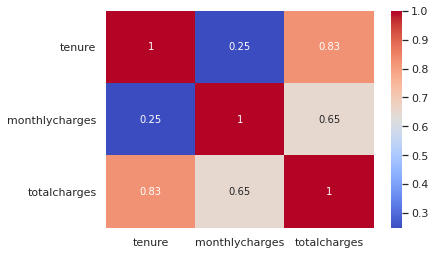

In [ ]:
sns.heatmap(data=df[['tenure', 'monthlycharges', 'totalcharges']].corr(),
            annot=True, cmap='coolwarm');

Inference: As evident from the correlation matrix and regplots, since 'totalcharges' is the total monthly charges over the tenure of a customer, 'totalcharges' is highly correlated with 'monthlycharges' and 'tenure'.

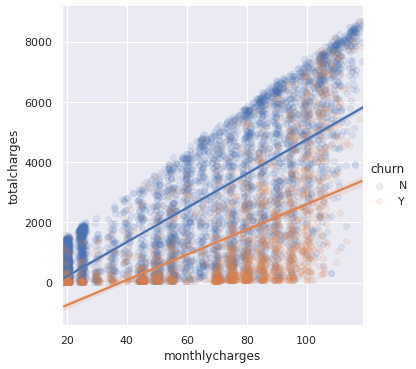

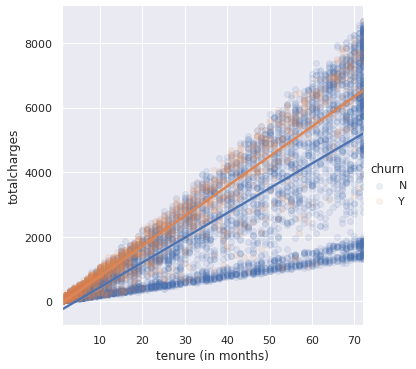

In [ ]:
sns.lmplot('monthlycharges', 'totalcharges', data=df, hue='churn',
           scatter_kws={'alpha': 0.1})
fig = sns.lmplot('tenure', 'totalcharges', data=df, hue='churn',
                 scatter_kws={'alpha': 0.1})
fig.set_xlabels('tenure (in months)');

<a name="8.2.2"></a>
#### 8.2.2 Correlation between Qualitative/ Categorical variables
Back to [Table of Contents](#0)


Cramer's V is more appropriate than Pearson correlation to find correlation between two nominal variables. Here, the Cramer's V metric is implemented.

In [ ]:
def cramers_corrected_stat(contingency_table):
    """
        Computes corrected Cramer's V statistic for categorial-categorial association
    """
    chi2 = chi2_contingency(contingency_table)[0]
    n = contingency_table.sum().sum()
    phi2 = chi2/n
    
    r, k = contingency_table.shape
    r_corrected = r - (((r-1)**2)/(n-1))
    k_corrected = k - (((k-1)**2)/(n-1))
    phi2_corrected = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    
    return (phi2_corrected / min( (k_corrected-1), (r_corrected-1)))**0.5

In [ ]:
def categorical_corr_matrix(df):
    """
        Computes corrected Cramer's V statistic between
        all the categorical variables in the dataframe
    """
    df = df.select_dtypes(include='category')
    cols = df.columns
    n = len(cols)
    corr_matrix = pd.DataFrame(np.zeros(shape=(n, n)), index=cols, columns=cols)
    
    for col1 in cols:
        for col2 in cols:
            if col1 == col2:
                corr_matrix.loc[col1, col2] = 1
                break
            df_crosstab = pd.crosstab(df[col1], df[col2], dropna=False)
            corr_matrix.loc[col1, col2] = cramers_corrected_stat(df_crosstab)
    
    # Flip and add to get full correlation matrix
    corr_matrix += np.tril(corr_matrix, k=-1).T
    return corr_matrix

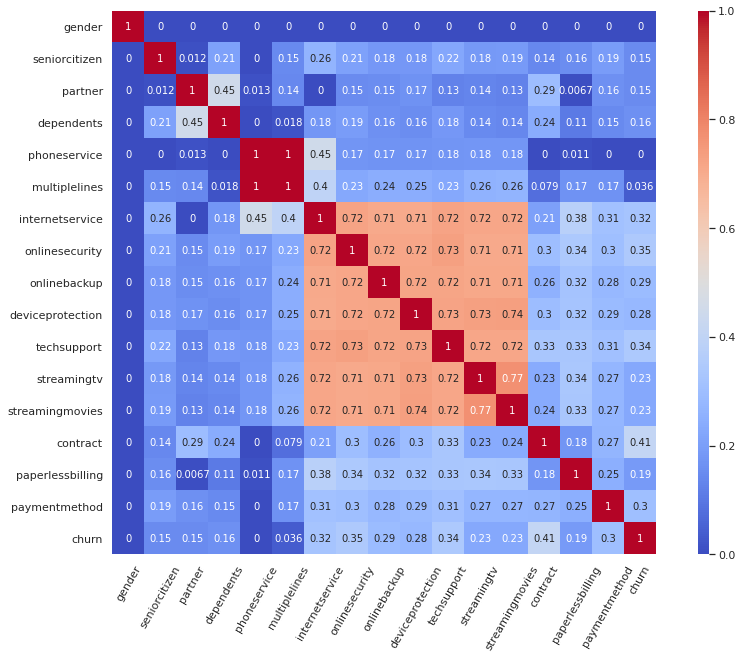

In [ ]:
fig, ax = plt.subplots(figsize=(15, 10))
sns.heatmap(categorical_corr_matrix(df), annot=True, cmap='coolwarm', 
            cbar_kws={'aspect': 50}, square=True, ax=ax)
plt.xticks(rotation=60);

Inference: There is some correlation between 'phone service' and 'multiple lines' since those who don't have a phone service cannot have multiple lines. So, knowing that a particular customer is not subscribed to phone service we can infer that the customer doesn't have multiple lines. Similarly, there is also a correlation between 'internet service' and 'online security', 'online backup', 'device protection', 'streaming tv' and 'streaming movies'

<a name="8.3"></a>
### 8.3 Data Preprocessing
Back to [Table of Contents](#0)

Data needs to be one-hot-encoded before applying machine learning models.



In [ ]:
x = df.iloc[:, :-1]
y = df['churn']

categorical_columns = list(x.select_dtypes(include='category').columns)
numeric_columns = list(x.select_dtypes(exclude='category').columns)

<a name="8.3.1"></a>
#### 8.3.1 Train-Test Split
Back to [Table of Contents](#0)


CatBoost classifier does not require any knd of preprocessing while Naive bayes requires a different kind of preprocesing. Therefore, we will use raw/ unmodified data (x_train_cat, x_test_cat, y_train_cat, y_test_cat) for CatBoost and preprocessed data (x_train, x_test, y_train, y_test) for all other classifiers. For Naive Bayes, we will use the raw data (x_train_cat, x_test_cat, y_train_cat, y_test_cat) and preprocess it as required in the Naive Bayes section.

In [ ]:
from sklearn.model_selection import train_test_split

data_splits = train_test_split(x, y, test_size=0.2, random_state=0,
                               shuffle=True, stratify=y)
x_train, x_test, y_train, y_test = data_splits


# For CatBoost and Naive Bayes
data_splits = train_test_split(x, y, test_size=0.2, random_state=0,
                               shuffle=True, stratify=y)
x_train_cat, x_test_cat, y_train_cat, y_test_cat = data_splits


# Save the non-scaled version of monthlycharges and totalcharges to compare classifiers
x_test_charges = np.array(x_test[['monthlycharges', 'totalcharges']], copy=True)

list(map(lambda x: x.shape, [x, y, x_train, x_test, y_train, y_test]))

[(7032, 19), (7032,), (5274, 19), (1758, 19), (5274,), (1758,)]

<a name="8.3.2"></a>
#### 8.3.2 Oversample Training Data (SMOTE-NC)
Back to [Table of Contents](#0)


SMOTE is an oversampling method that balances imbalanced datasets by sampling (with replacement) minority class. SMOTE-NC stands for Synthetic Minority Over-sampling TEchnique for data with Numerical-Categorical features. Note that only training data is oversampled. The testing data is untouched.

In [ ]:
# from imblearn.over_sampling import SMOTENC

# smote = SMOTENC(categorical_features=(x_train.dtypes == "category").values,
#                 random_state=42)

# x_train, y_train = smote.fit_resample(x_train, y_train)

# x_train_cat, y_train_cat = smote.fit_resample(x_train_cat, y_train_cat)

In [ ]:
from imblearn.over_sampling import SMOTENC

smote = SMOTENC(categorical_features=(x_train.dtypes == "category").values,
                random_state=42)

x_train_oversampled, y_train = smote.fit_resample(x_train, y_train)
x_train = pd.DataFrame(x_train_oversampled, columns=x_train.columns)

x_train_cat_resampled, y_train_cat = smote.fit_resample(x_train_cat, y_train_cat)
x_train_cat = pd.DataFrame(x_train_cat_resampled, columns=x_train_cat.columns)

In [ ]:
pd.Series(y_train).value_counts()

Y    3872
N    3872
dtype: int64

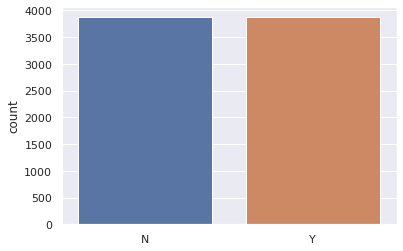

In [ ]:
sns.countplot(x=y_train);

<a name="8.3.3"></a>
#### 8.3.3 One-Hot Encoding and STandardization
Back to [Table of Contents](#0)


We need to standardize the continuous or quantitative variables/ features before applying Machine Learning models. This is important because if we don't standardize the features, features with high variance that are orders of magnitude larger that others might dominate the model fitting process and causing the model unable to learn from other features (with lower variance) correctly as expected.
There is no need to standardize categorical variables.

Also we need to standardize the data only after performing train-test split because if we standardize before splitting then there is a chance for some information leak from the test set into the train set. We always want the test set to be completely new to the ML models.

In [ ]:
# x_train = pd.DataFrame(x_train)
# x_test = pd.DataFrame(x_test)
# x_train_cat = pd.DataFrame(x_train_cat)
# x_test_cat = pd.DataFrame(x_test_cat)
# y_train = pd.DataFrame(y_train)
# y_test = pd.DataFrame(y_test)

In [ ]:
categorical_columns = list(x.select_dtypes(include='category').columns)


## Column Transformer
transformers = [('one_hot_encoder',
                  OneHotEncoder(drop='first',dtype='int'),
                  categorical_columns),
                ('standard_scaler', StandardScaler(), numeric_columns)]
x_trans = ColumnTransformer(transformers, remainder='passthrough')

## Applying Column Transformer
x_train = x_trans.fit_transform(x_train)
x_test = x_trans.transform(x_test)

## Label encoding
y_trans = LabelEncoder()
y_train = y_trans.fit_transform(y_train)
y_test = y_trans.transform(y_test)


## Save feature names after one-hot encoding for feature importances plots
feature_names = list(x_trans.named_transformers_['one_hot_encoder'] \
                            .get_feature_names(input_features=categorical_columns))
feature_names = feature_names + numeric_columns

<a name="8.4"></a>
### 8.4 Data Modelling
Back to [Table of Contents](#0)

<a name="8.4.1"></a>
#### 8.4.1 Utility Functions
Back to [Table of Contents](#0)


In [ ]:
import timeit
import pickle
import sys
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, \
                            precision_recall_curve, roc_curve, accuracy_score
from sklearn.exceptions import NotFittedError

In [ ]:
def confusion_plot(matrix, labels=None):
    """ Display binary confusion matrix as a Seaborn heatmap """
    
    labels = labels if labels else ['Negative (0)', 'Positive (1)']
    
    fig, ax = plt.subplots(nrows=1, ncols=1)
    sns.heatmap(data=matrix, cmap='Blues', annot=True, fmt='d',
                xticklabels=labels, yticklabels=labels, ax=ax)
    ax.set_xlabel('PREDICTED')
    ax.set_ylabel('ACTUAL')
    ax.set_title('Confusion Matrix')
    plt.close()
    
    return fig

In [ ]:
def roc_plot(y_true, y_probs, label, compare=False, ax=None):
    """ Plot Receiver Operating Characteristic (ROC) curve 
        Set `compare=True` to use this function to compare classifiers. """
    
    fpr, tpr, thresh = roc_curve(y_true, y_probs)
    auc = round(roc_auc_score(y_true, y_probs), 2)
    
    fig, axis = (None, ax) if ax else plt.subplots(nrows=1, ncols=1)
    label = ' '.join([label, f'({auc})']) if compare else None
    sns.lineplot(x=fpr, y=tpr, ax=axis, label=label)
    
    if compare:
        axis.legend(title='Classifier (AUC)', loc='lower right')
    else:
        axis.text(0.72, 0.05, f'AUC = { auc }', fontsize=12,
                  bbox=dict(facecolor='green', alpha=0.4, pad=5))
            
        # Plot No-Info classifier
        axis.fill_between(fpr, fpr, tpr, alpha=0.3, edgecolor='g',
                          linestyle='--', linewidth=2)
        
    axis.set_xlim(0, 1)
    axis.set_ylim(0, 1)
    axis.set_title('ROC Curve')
    axis.set_xlabel('False Positive Rate [FPR]\n(1 - Specificity)')
    axis.set_ylabel('True Positive Rate [TPR]\n(Sensitivity or Recall)')
    
    plt.close()
    
    return axis if ax else fig

In [ ]:
def precision_recall_plot(y_true, y_probs, label, compare=False, ax=None):
    """ Plot Precision-Recall curve.
        Set `compare=True` to use this function to compare classifiers. """
    
    p, r, thresh = precision_recall_curve(y_true, y_probs)
    p, r, thresh = list(p), list(r), list(thresh)
    p.pop()
    r.pop()
    
    fig, axis = (None, ax) if ax else plt.subplots(nrows=1, ncols=1)
    
    if compare:
        sns.lineplot(r, p, ax=axis, label=label)
        axis.set_xlabel('Recall')
        axis.set_ylabel('Precision')
        axis.legend(loc='lower left')
    else:
        sns.lineplot(thresh, p, label='Precision', ax=axis)
        axis.set_xlabel('Threshold')
        axis.set_ylabel('Precision')
        axis.legend(loc='lower left')

        axis_twin = axis.twinx()
        sns.lineplot(thresh, r, color='limegreen', label='Recall', ax=axis_twin)
        axis_twin.set_ylabel('Recall')
        axis_twin.set_ylim(0, 1)
        axis_twin.legend(bbox_to_anchor=(0.24, 0.18))
    
    axis.set_xlim(0, 1)
    axis.set_ylim(0, 1)
    axis.set_title('Precision Vs Recall')
    
    plt.close()
    
    return axis if ax else fig

In [ ]:
def feature_importance_plot(importances, feature_labels, ax=None):
    fig, axis = (None, ax) if ax else plt.subplots(nrows=1, ncols=1, figsize=(5, 10))
    sns.barplot(x=importances, y=feature_labels, ax=axis)
    axis.set_title('Feature Importance Measures')
    
    plt.close()
    
    return axis if ax else fig

In [ ]:
def train_clf(clf, x_train, y_train, sample_weight=None, refit=False):
    train_time = 0
    
    try:
        if refit:
            raise NotFittedError
        y_pred_train = clf.predict(x_train)
    except NotFittedError:
        start = timeit.default_timer()
        
        if sample_weight is not None:
            clf.fit(x_train, y_train, sample_weight=sample_weight)
        else:
            clf.fit(x_train, y_train)
        
        end = timeit.default_timer()
        train_time = end - start
        
        y_pred_train = clf.predict(x_train)
    
    train_acc = accuracy_score(y_train, y_pred_train)
    return clf, y_pred_train, train_acc, train_time

In [ ]:
def model_memory_size(clf):
    return sys.getsizeof(pickle.dumps(clf))

In [ ]:
def report(clf, x_train, y_train, x_test, y_test, sample_weight=None,
           refit=False, importance_plot=False, confusion_labels=None,
           feature_labels=None, verbose=True):
    """ Trains the passed classifier if not already trained and reports
        various metrics of the trained classifier """
    
    dump = dict()
    
    ## Train if not already trained
    clf, train_predictions, \
    train_acc, train_time = train_clf(clf, x_train, y_train,
                                                     sample_weight=sample_weight,
                                                     refit=refit)
    ## Testing
    start = timeit.default_timer()
    test_predictions = clf.predict(x_test)
    end = timeit.default_timer()
    test_time = end - start
    
    test_acc = accuracy_score(y_test, test_predictions)
    y_probs = clf.predict_proba(x_test)[:, 1]
    
    roc_auc = roc_auc_score(y_test, y_probs)
    
    
    ## Model Memory
    model_mem = round(model_memory_size(clf) / 1024, 2)
    
    print(clf)
    print("\n=============================> TRAIN-TEST DETAILS <======================================")
    
    ## Metrics
    print(f"Train Size: {x_train.shape[0]} samples")
    print(f" Test Size: {x_test.shape[0]} samples")
    print("------------------------------------------")
    print(f"Training Time: {round(train_time, 3)} seconds")
    print(f" Testing Time: {round(test_time, 3)} seconds")
    print("------------------------------------------")
    print("Train Accuracy: ", train_acc)
    print(" Test Accuracy: ", test_acc)
    print("------------------------------------------")
    print(" Area Under ROC: ", roc_auc)
    print("------------------------------------------")
    print(f"Model Memory Size: {model_mem} kB")
    print("\n=============================> CLASSIFICATION REPORT <===================================")
    
    ## Classification Report
    clf_rep = classification_report(y_test, test_predictions, output_dict=True)
    
    print(classification_report(y_test, test_predictions,
                                target_names=confusion_labels))
    
    
    if verbose:
        print("\n================================> CONFUSION MATRIX <=====================================")
    
        ## Confusion Matrix HeatMap
        display(confusion_plot(confusion_matrix(y_test, test_predictions),
                               labels=confusion_labels))
        print("\n=======================================> PLOTS <=========================================")


        ## Variable importance plot
        fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 10))
        roc_axes = axes[0, 0]
        pr_axes = axes[0, 1]
        importances = None

        if importance_plot:
            if not feature_labels:
                raise RuntimeError("'feature_labels' argument not passed "
                                   "when 'importance_plot' is True")

            try:
                importances = pd.Series(clf.feature_importances_,
                                        index=feature_labels) \
                                .sort_values(ascending=False)
            except AttributeError:
                try:
                    importances = pd.Series(clf.coef_.ravel(),
                                            index=feature_labels) \
                                    .sort_values(ascending=False)
                except AttributeError:
                    pass

            if importances is not None:
                # Modifying grid
                grid_spec = axes[0, 0].get_gridspec()
                for ax in axes[:, 0]:
                    ax.remove()   # remove first column axes
                large_axs = fig.add_subplot(grid_spec[0:, 0])

                # Plot importance curve
                feature_importance_plot(importances=importances.values,
                                        feature_labels=importances.index,
                                        ax=large_axs)
                large_axs.axvline(x=0)

                # Axis for ROC and PR curve
                roc_axes = axes[0, 1]
                pr_axes = axes[1, 1]
            else:
                # remove second row axes
                for ax in axes[1, :]:
                    ax.remove()
        else:
            # remove second row axes
            for ax in axes[1, :]:
                ax.remove()


        ## ROC and Precision-Recall curves
        clf_name = clf.__class__.__name__
        roc_plot(y_test, y_probs, clf_name, ax=roc_axes)
        precision_recall_plot(y_test, y_probs, clf_name, ax=pr_axes)

        fig.subplots_adjust(wspace=5)
        fig.tight_layout()
        display(fig)
    
    ## Dump to report_dict
    dump = dict(clf=clf, train_acc=train_acc, train_time=train_time,
                train_predictions=train_predictions, test_acc=test_acc,
                test_time=test_time, test_predictions=test_predictions,
                test_probs=y_probs, report=clf_rep, roc_auc=roc_auc,
                model_memory=model_mem)
    
    return clf, dump

In [ ]:
def compare_models(y_test=None, clf_reports=[], labels=[]):
    """ Compare evaluation metrics for the True Positive class [1] of 
        binary classifiers passed in the argument and plot ROC and PR curves.
        
        Arguments:
        ---------
        y_test: to plot ROC and Precision-Recall curves
        
        Returns:
        -------
        compare_table: pandas DataFrame containing evaluated metrics
                  fig: `matplotlib` figure object with ROC and PR curves """

    
    ## Classifier Labels
    default_names = [rep['clf'].__class__.__name__ for rep in clf_reports]
    clf_names =  labels if len(labels) == len(clf_reports) else default_names
    
    
    ## Compare Table
    table = dict()
    index = ['Train Accuracy', 'Test Accuracy', 'Overfitting', 'ROC Area',
             'Precision', 'Recall', 'F1-score', 'Support']
    for i in range(len(clf_reports)):
        train_acc = round(clf_reports[i]['train_acc'], 3)
        test_acc = round(clf_reports[i]['test_acc'], 3)
        clf_probs = clf_reports[i]['test_probs']
        roc_auc = clf_reports[i]['roc_auc']
        
        # Get metrics of True Positive class from sklearn classification_report
        true_positive_metrics = list(clf_reports[i]['report']["1"].values())
        
        table[clf_names[i]] = [train_acc, test_acc,
                               test_acc < train_acc, roc_auc] + true_positive_metrics
    
    table = pd.DataFrame(data=table, index=index)
    
    
    ## Compare Plots
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    
    # ROC and Precision-Recall
    for i in range(len(clf_reports)):
        clf_probs = clf_reports[i]['test_probs']
        roc_plot(y_test, clf_probs, label=clf_names[i],
                 compare=True, ax=axes[0])
        precision_recall_plot(y_test, clf_probs, label=clf_names[i],
                              compare=True, ax=axes[1])
    # Plot No-Info classifier
    axes[0].plot([0,1], [0,1], linestyle='--', color='green')
        
    fig.tight_layout()
    plt.close()
    
    return table.T, fig

<a name="8.4.2"></a>
#### 8.4.2 Naive Bayes
Back to [Table of Contents](#0)


In [ ]:
from reports import Report
from sklearn.tree import DecisionTreeClassifier
import os
import shutil
import glob

import easydev
import pandas as pd
from jinja2.environment import Environment
from jinja2 import FileSystemLoader

CategoricalNB(alpha=1.0, class_prior=None, fit_prior=True)

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 0.012 seconds
 Testing Time: 0.002 seconds
------------------------------------------
Train Accuracy:  0.7821539256198347
 Test Accuracy:  0.7337883959044369
------------------------------------------
 Area Under ROC:  0.820967760662269
------------------------------------------
Model Memory Size: 6.46 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-score   support

    No Churn       0.90      0.72      0.80      1291
       Churn       0.50      0.78      0.61       467

    accuracy                           0.73      1758
   macro avg       0.70      0.75      0.70      1758
weighted avg       0.79      0.73      0.75      1758


================

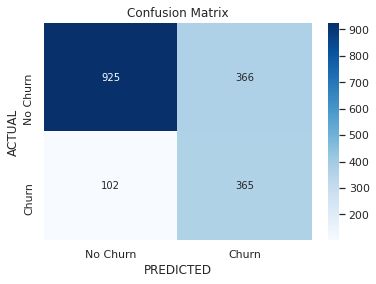


=======================================> PLOTS <=========================================


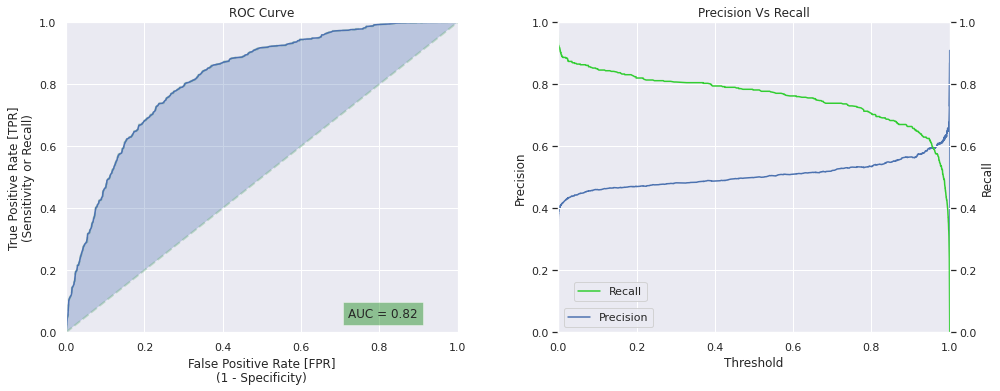

In [ ]:
from sklearn.naive_bayes import CategoricalNB, GaussianNB 
from sklearn.preprocessing import KBinsDiscretizer, OrdinalEncoder
from sklearn.metrics import classification_report


confusion_lbs = ['No Churn', 'Churn']

## Discretize 'monthlycharges' and 'totalcharges' into 3bins
kbn = KBinsDiscretizer(n_bins=12, encode='ordinal')
ode = OrdinalEncoder(dtype=np.int64)
nb_trans = [('ordinal', ode, categorical_columns),
            ('kbn', kbn, numeric_columns[1:])]
nb_col_trans = ColumnTransformer(nb_trans, remainder='passthrough')

## Applying Column Transformer
x_train_nb = nb_col_trans.fit_transform(x_train_cat)
x_test_nb = nb_col_trans.transform(x_test_cat)

nb_clf = CategoricalNB()

nb_clf, nb_report = report(nb_clf, x_train_nb, y_train,
                           x_test_nb, y_test, refit=True,
                           confusion_labels=confusion_lbs)

<a name="8.4.3"></a>
#### 8.4.3 Logistic Regression
Back to [Table of Contents](#0)


LogisticRegressionCV(Cs=10, class_weight='balanced', cv=5, dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=500, multi_class='auto', n_jobs=None,
                     penalty='l1', random_state=0, refit=True, scoring='f1',
                     solver='liblinear', tol=0.0001, verbose=0)

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 33.069 seconds
 Testing Time: 0.001 seconds
------------------------------------------
Train Accuracy:  0.8082386363636364
 Test Accuracy:  0.7559726962457338
------------------------------------------
 Area Under ROC:  0.828618321205778
------------------------------------------
Model Memory Size: 14.34 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-sco

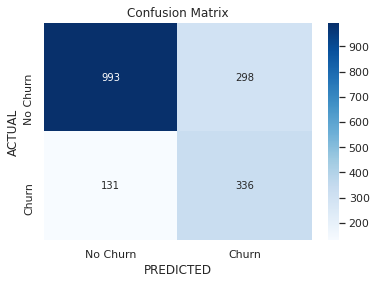


=======================================> PLOTS <=========================================


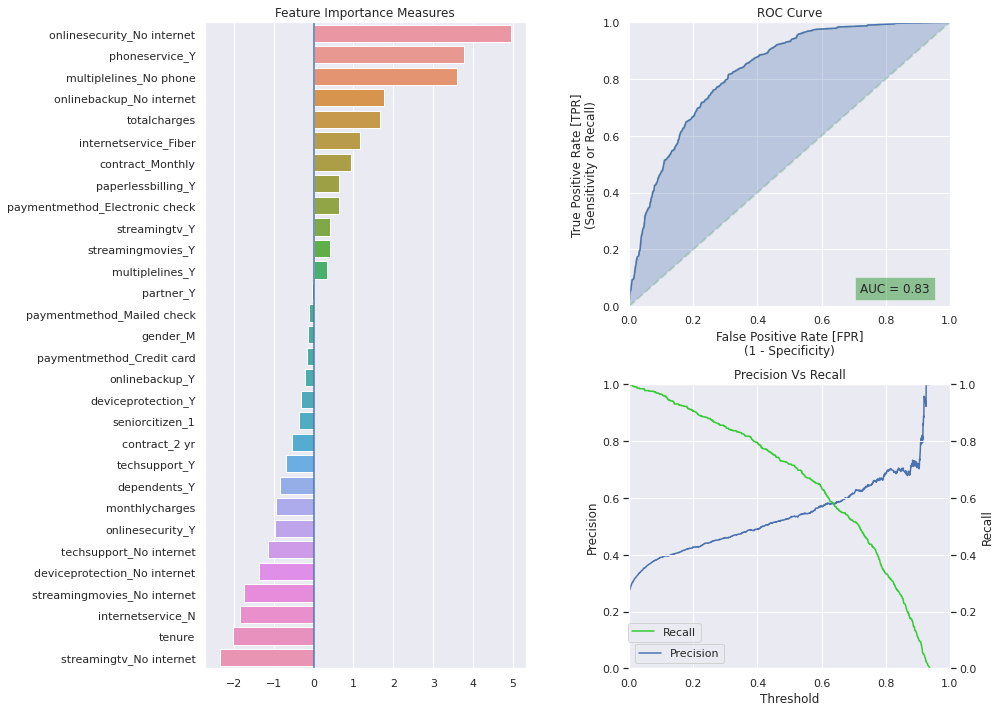

In [ ]:
from sklearn.linear_model import LogisticRegressionCV

logit_cv = LogisticRegressionCV(Cs=10, class_weight='balanced', cv=5, dual=False,
                                fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                                max_iter=500, multi_class='auto', n_jobs=None,
                                penalty='l1', random_state=0, refit=True,
                                scoring='f1', solver='liblinear', tol=0.0001,
                                verbose=0)

logit_cv, logit_report = report(logit_cv, x_train, y_train,
                                x_test, y_test, refit=True,
                                importance_plot=True,
                                feature_labels=feature_names,
                                confusion_labels=confusion_lbs)

<a name="8.4.4"></a>
#### 8.4.4 K-Nearest Neighbors
Back to [Table of Contents](#0)


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=91, p=1,
                     weights='uniform')

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 0.044 seconds
 Testing Time: 0.558 seconds
------------------------------------------
Train Accuracy:  0.7959710743801653
 Test Accuracy:  0.7002275312855518
------------------------------------------
 Area Under ROC:  0.8341457993653975
------------------------------------------
Model Memory Size: 2192.86 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-score   support

    No Churn       0.92      0.65      0.76      1291
       Churn       0.46      0.85      0.60       467

    accuracy                           0.70      

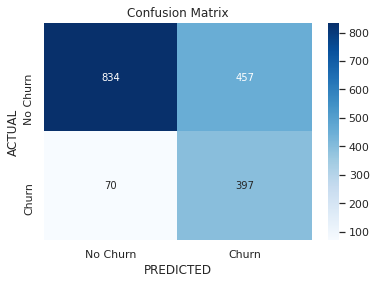


=======================================> PLOTS <=========================================


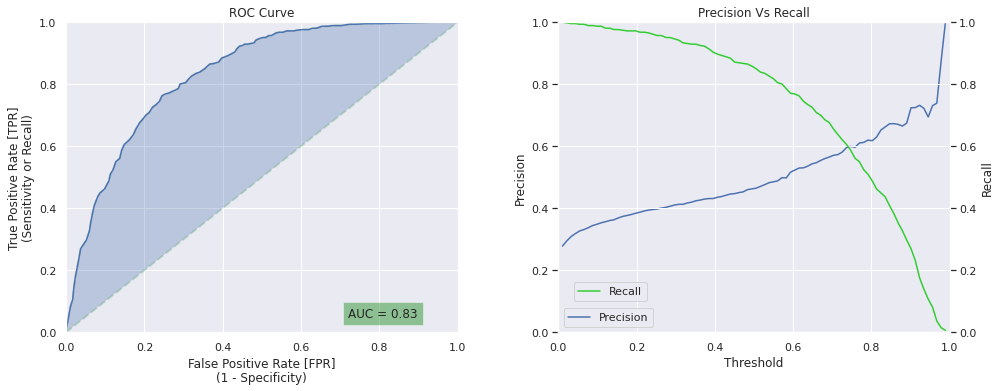

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=91, p=1,
                           weights='uniform', n_jobs=-1)

knn, knn_report = report(knn, x_train, y_train,
                         x_test, y_test,
                         importance_plot=True,
                         feature_labels=feature_names,
                         confusion_labels=confusion_lbs)

<a name="8.4.5"></a>
#### 8.4.5 Decision Tree
Back to [Table of Contents](#0)


DecisionTreeClassifier(ccp_alpha=0.0, class_weight='balanced',
                       criterion='entropy', max_depth=3, max_features=None,
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=0, splitter='best')

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 0.021 seconds
 Testing Time: 0.0 seconds
------------------------------------------
Train Accuracy:  0.7834452479338843
 Test Accuracy:  0.742320819112628
------------------------------------------
 Area Under ROC:  0.7848703841618054
------------------------------------------
Model Memory Size: 2.36 kB

=============================> CLASSIFICATION REPORT <===========

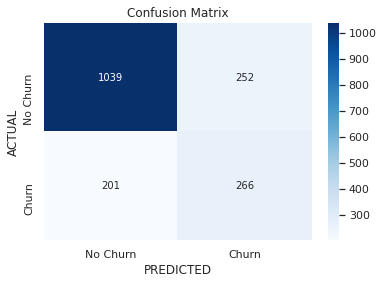


=======================================> PLOTS <=========================================


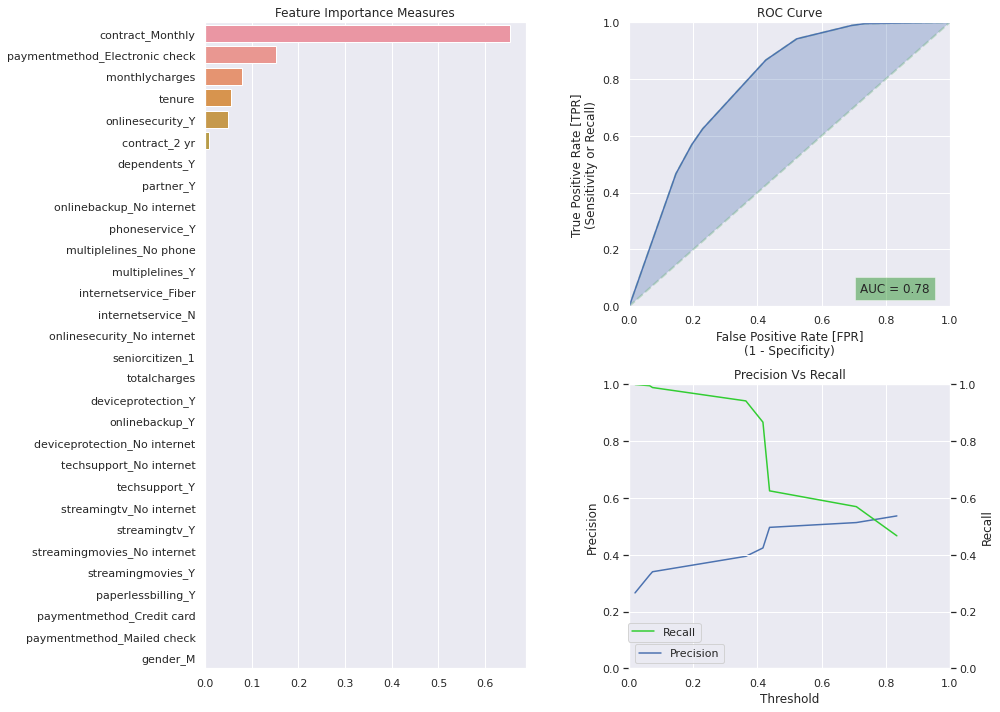

In [ ]:
from sklearn.tree import DecisionTreeClassifier

decision_tree = DecisionTreeClassifier(class_weight='balanced',
                                       criterion='entropy',
                                       max_depth=3,
                                       random_state=0)

decision_tree, decision_tree_report = report(decision_tree, x_train, y_train,
                                             x_test, y_test,
                                             importance_plot=True,
                                             feature_labels=feature_names,
                                             confusion_labels=confusion_lbs)

<a name="8.4.6"></a>
#### 8.4.6 Decision Trees with Bagging
Back to [Table of Contents](#0)


BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight='balanced',
                                                        criterion='entropy',
                                                        max_depth=2,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=

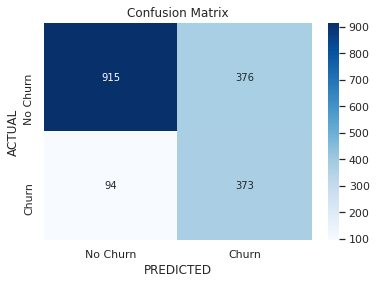


=======================================> PLOTS <=========================================


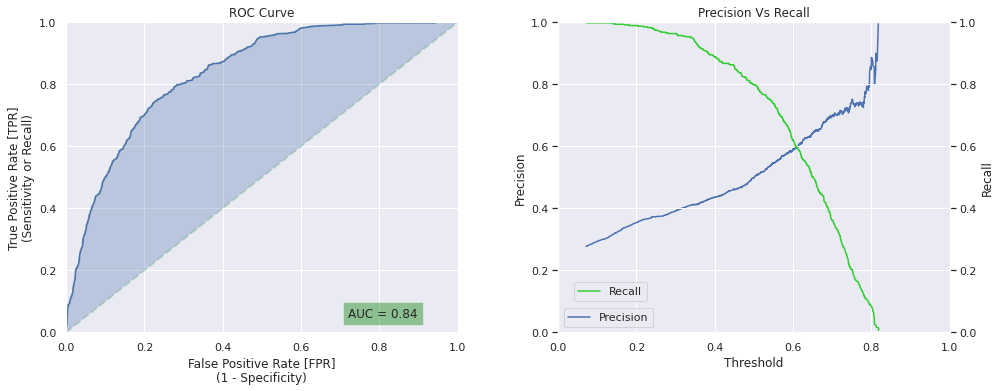

In [ ]:
from sklearn.ensemble import BaggingClassifier

bagging_dtree = DecisionTreeClassifier(max_depth=2, class_weight='balanced',
                                       criterion='entropy', random_state=0)

bagging_clf = BaggingClassifier(base_estimator=bagging_dtree,
                                max_samples=110, n_estimators=80,
                                max_features=15, n_jobs=-1,
                                random_state=0)

bagging_clf, bagging_clf_report = report(bagging_clf, x_train, y_train,
                                         x_test, y_test,
                                         feature_labels=feature_names,
                                         confusion_labels=confusion_lbs)

<a name="8.4.7"></a>
#### 8.4.7 Random Forests
Back to [Table of Contents](#0)


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='entropy', max_depth=1, max_features='auto',
                       max_leaf_nodes=None, max_samples=2000,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=0, verbose=0,
                       warm_start=False)

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 0.351 seconds
 Testing Time: 0.102 seconds
------------------------------------------
Train Accuracy:  0.7790547520661157
 Test Accuracy:  0.7161547212741752
------------------------------------------
 Area Under ROC:  0.8285262656805392
---------------

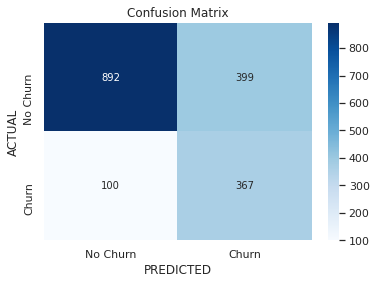


=======================================> PLOTS <=========================================


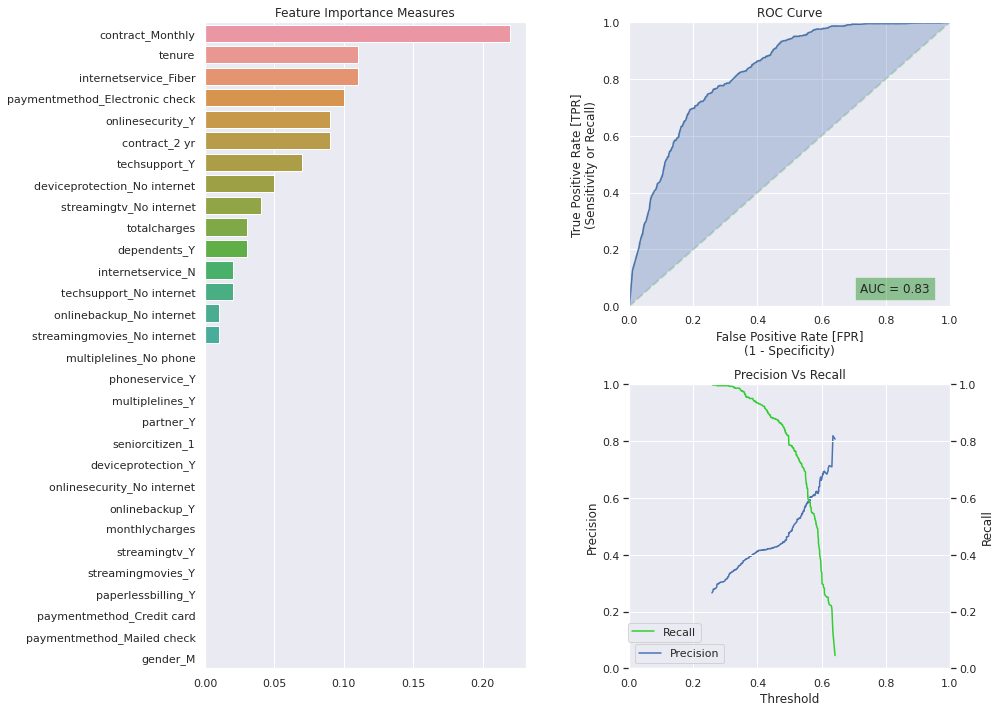

In [ ]:
from sklearn.ensemble import RandomForestClassifier

random_forest = RandomForestClassifier(class_weight='balanced', criterion='entropy',
                                       max_depth=1, max_samples=2000, n_estimators=100,
                                       n_jobs=-1, random_state=0)

random_forest, random_forest_report = report(random_forest, x_train, y_train,
                                             x_test, y_test,
                                             importance_plot=True,
                                             feature_labels=feature_names,
                                             confusion_labels=confusion_lbs)

<a name="8.4.8"></a>
#### 8.4.8 Decision Trees with AdaBoost
Back to [Table of Contents](#0)


AdaBoostClassifier(algorithm='SAMME.R',
                   base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                         class_weight='balanced',
                                                         criterion='entropy',
                                                         max_depth=1,
                                                         max_features=None,
                                                         max_leaf_nodes=None,
                                                         min_impurity_decrease=0.0,
                                                         min_impurity_split=None,
                                                         min_samples_leaf=1,
                                                         min_samples_split=2,
                                                         min_weight_fraction_leaf=0.0,
                                                         presort='deprecated',
                 

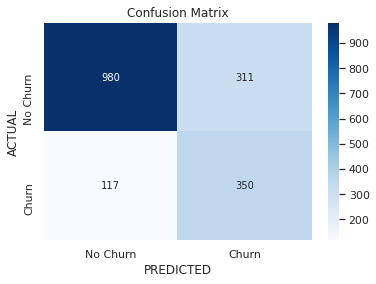


=======================================> PLOTS <=========================================


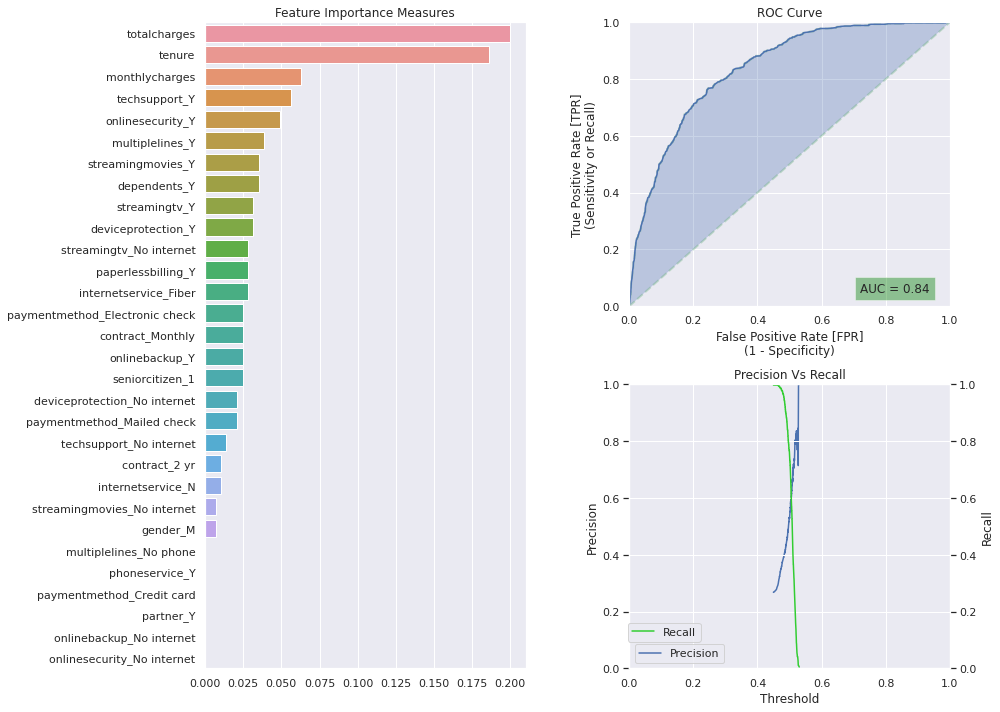

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

boosting_dtree = DecisionTreeClassifier(class_weight='balanced',
                                        criterion='entropy',
                                        max_depth=1, random_state=0)
adaboot = AdaBoostClassifier(base_estimator=boosting_dtree,
                             n_estimators=285, learning_rate=0.1,
                             random_state=0)

adaboot, adaboot_report = report(adaboot, x_train, y_train,
                                 x_test, y_test,
                                 importance_plot=True,
                                 feature_labels=feature_names,
                                 confusion_labels=confusion_lbs)

<a name="8.4.9"></a>
#### 8.4.9 Linear SVC
Back to [Table of Contents](#0)


SVC(C=1.0, break_ties=False, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='linear',
    max_iter=-1, probability=True, random_state=0, shrinking=True, tol=0.001,
    verbose=False)

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 10.442 seconds
 Testing Time: 0.181 seconds
------------------------------------------
Train Accuracy:  0.8048811983471075
 Test Accuracy:  0.757679180887372
------------------------------------------
 Area Under ROC:  0.8260523771058736
------------------------------------------
Model Memory Size: 868.79 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-score   support

    No Churn       0.88      0.78      0.82      1291
       Churn       0.53      0.71   

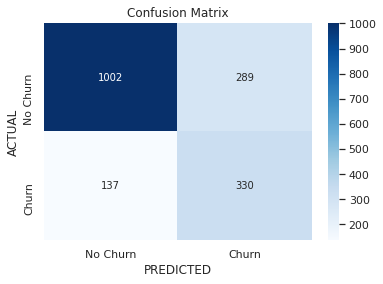


=======================================> PLOTS <=========================================


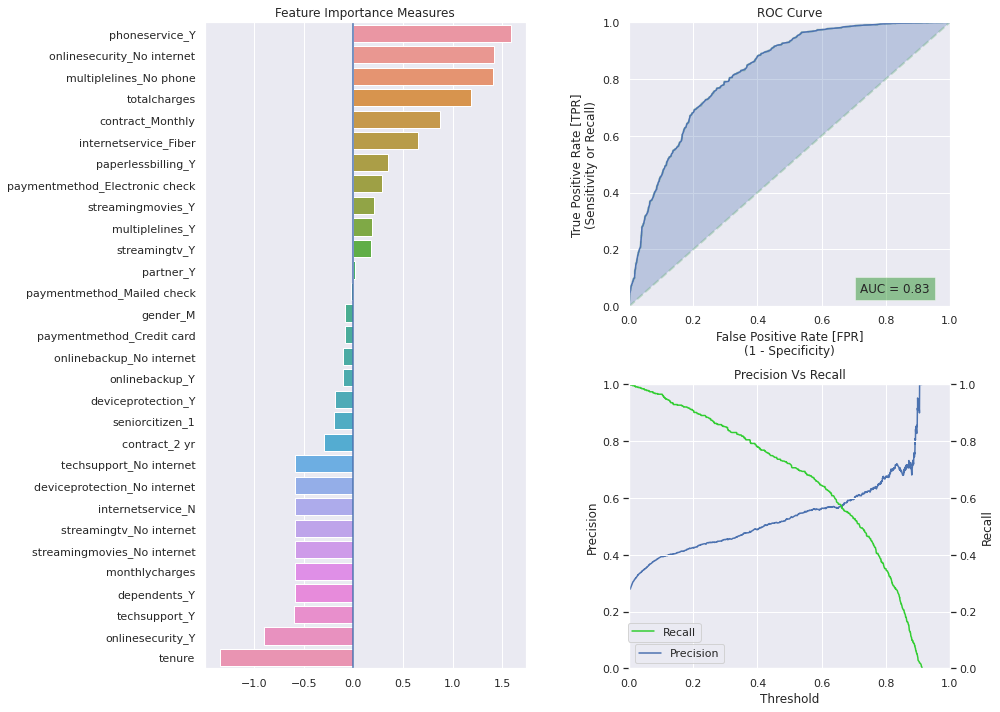

In [ ]:
from sklearn.svm import SVC

linear_svc = SVC(kernel='linear', probability=True,
                 class_weight='balanced', random_state=0)

linear_svc, linear_svc_report = report(linear_svc, x_train, y_train,
                                       x_test, y_test,
                                       importance_plot=True,
                                       feature_labels=feature_names,
                                       confusion_labels=confusion_lbs)

<a name="8.4.10"></a>
#### 8.4.10 SVM with RBF kernel
Back to [Table of Contents](#0)


SVC(C=0.3, break_ties=False, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=True, random_state=0, shrinking=True, tol=0.001,
    verbose=False)

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 12.246 seconds
 Testing Time: 0.352 seconds
------------------------------------------
Train Accuracy:  0.8277376033057852
 Test Accuracy:  0.7696245733788396
------------------------------------------
 Area Under ROC:  0.8155049701690338
------------------------------------------
Model Memory Size: 870.82 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-score   support

    No Churn       0.86      0.81      0.84      1291
       Churn       0.56      0.65     

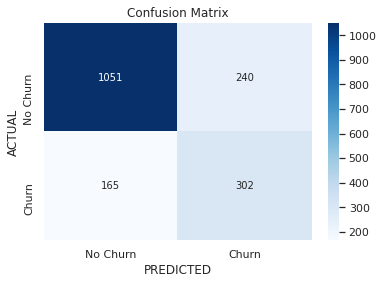


=======================================> PLOTS <=========================================


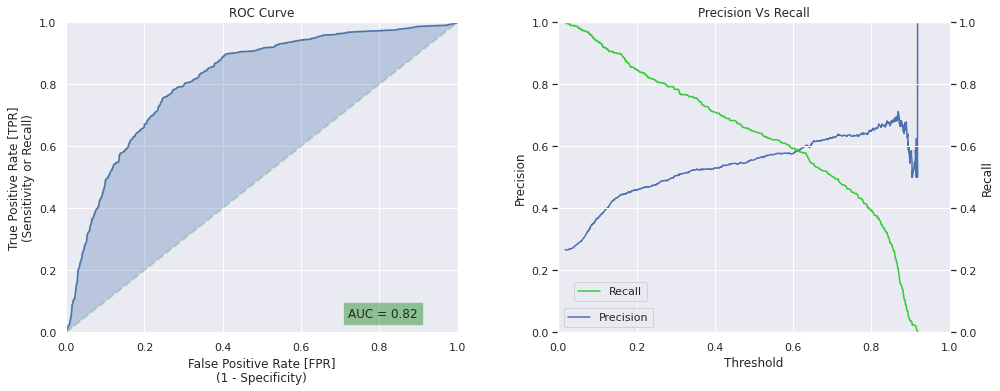

In [ ]:
rbf_svc = SVC(C=0.3, kernel='rbf', probability=True,
              class_weight='balanced', random_state=0)

rbf_svc, rbf_svc_report = report(rbf_svc, x_train, y_train,
                                 x_test, y_test,
                                 importance_plot=True,
                                 feature_labels=feature_names,
                                 confusion_labels=confusion_lbs)

<a name="8.4.11"></a>
#### 8.4.11 XGBoost
Back to [Table of Contents](#0)


SVC(C=0.3, break_ties=False, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=True, random_state=0, shrinking=True, tol=0.001,
    verbose=False)

=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 12.41 seconds
 Testing Time: 0.359 seconds
------------------------------------------
Train Accuracy:  0.8277376033057852
 Test Accuracy:  0.7696245733788396
------------------------------------------
 Area Under ROC:  0.8155049701690338
------------------------------------------
Model Memory Size: 870.82 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-score   support

    No Churn       0.86      0.81      0.84      1291
       Churn       0.56      0.65      

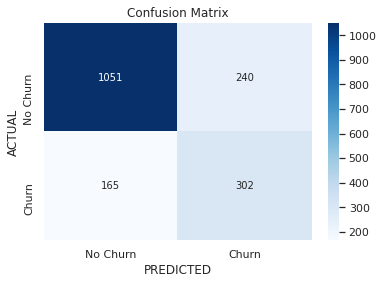


=======================================> PLOTS <=========================================


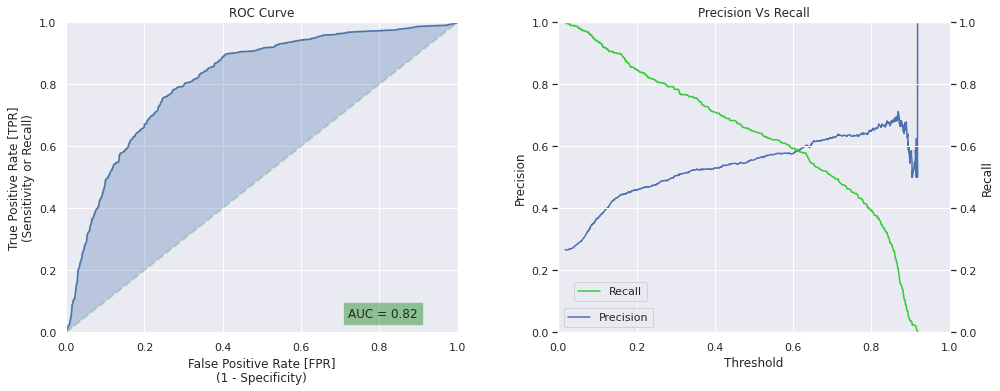

In [ ]:
from xgboost import XGBClassifier
from sklearn.utils import class_weight

## Compute `class_weights` using sklearn
cls_weight = (y_train.shape[0] - np.sum(y_train)) / np.sum(y_train)

xgb_clf = XGBClassifier(learning_rate=0.01, random_state=0,
                        scale_pos_weight=cls_weight, n_jobs=-1)
xgb_clf.fit(x_train, y_train);

xgb_clf, xgb_report = report(xgb_clf, x_train, y_train,
                             x_test, y_test,
                             importance_plot=True,
                             feature_labels=feature_names,
                             confusion_labels=confusion_lbs)

<a name="8.4.12"></a>
#### 8.4.12 CatBoost
Back to [Table of Contents](#0)


     |████████████████████████████████| 67.3MB 67kB/s 



=============================> TRAIN-TEST DETAILS <======================================
Train Size: 7744 samples
 Test Size: 1758 samples
------------------------------------------
Training Time: 0 seconds
 Testing Time: 0.007 seconds
------------------------------------------
Train Accuracy:  0.8539514462809917
 Test Accuracy:  0.764505119453925
------------------------------------------
 Area Under ROC:  0.829539705787224
------------------------------------------
Model Memory Size: 269.27 kB

=============================> CLASSIFICATION REPORT <===================================
              precision    recall  f1-score   support

    No Churn       0.86      0.81      0.83      1291
       Churn       0.55      0.65      0.59       467

    accuracy                           0.76      1758
   macro avg       0.71      0.73      0.71      1758
weighted avg       0.78      0.76      0.77      1758


================================> CONFUSION MATRIX <==========================

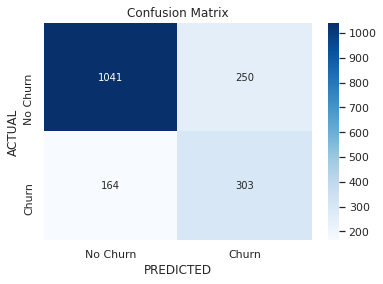


=======================================> PLOTS <=========================================


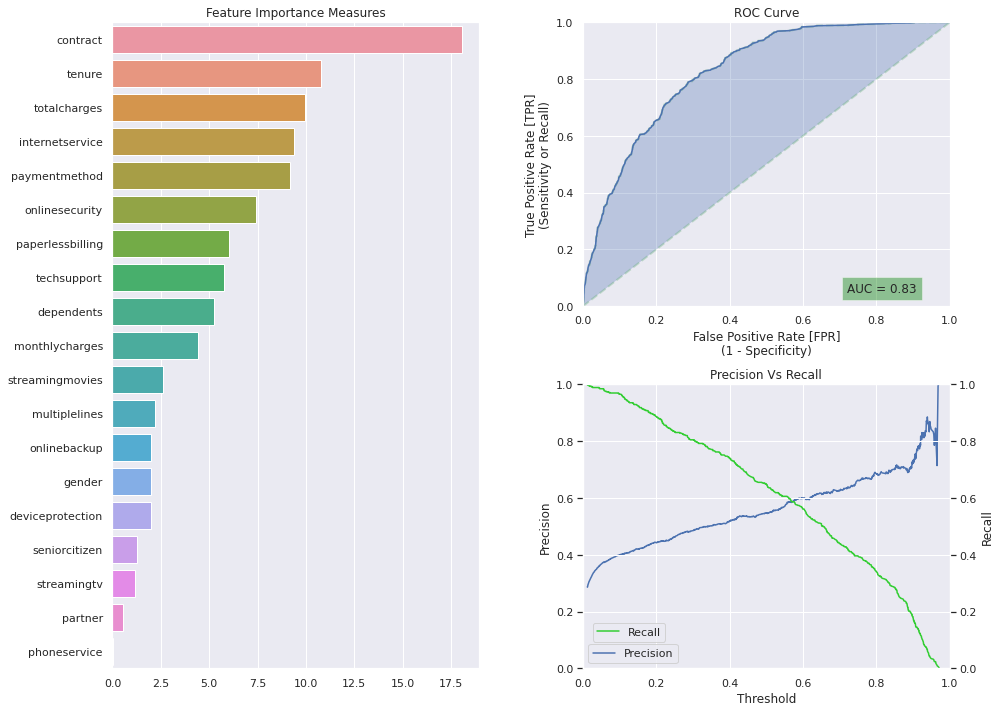

In [ ]:
from catboost import CatBoostClassifier

# Basic working

catboost_clf = CatBoostClassifier(cat_features=categorical_columns,
                                  l2_leaf_reg=120, depth=6,
                                  auto_class_weights='Balanced',
                                  iterations=200, learning_rate=0.16,
                                  use_best_model=True,
                                  early_stopping_rounds=150,
                                  eval_metric='F1', random_state=0)

catboost_clf.fit(x_train_cat, y_train, 
                 eval_set=(x_train_cat, y_train),
                 verbose=False)


f_labels = categorical_columns+numeric_columns
catboost_clf, catboost_report = report(catboost_clf, x_train_cat, y_train,
                                       x_test_cat, y_test,
                                       importance_plot=True,
                                       feature_labels=f_labels,
                                       confusion_labels=confusion_lbs)

<a name="8.5"></a>
### 8.5 Model Comparison
Back to [Table of Contents](#0)

In [ ]:
report_list = [nb_report, logit_report, knn_report, decision_tree_report, 
               bagging_clf_report, random_forest_report, adaboot_report,
               xgb_report, linear_svc_report, rbf_svc_report, catboost_report]
clf_labels = [rep['clf'].__class__.__name__ for rep in report_list]
clf_labels[-3], clf_labels[-2] = 'Linear SVC', 'RBF SVC'

<a name="8.5.1"></a>
#### 8.5.1 Evaluation Metrics
Back to [Table of Contents](#0)


In [ ]:
compare_table, compare_plot = compare_models(y_test, clf_reports=report_list, labels=clf_labels)

compare_table.sort_values(by=['Overfitting'])

,Train Accuracy,Test Accuracy,Overfitting,ROC Area,Precision,Recall,F1-score,Support
CategoricalNB,0.782,0.734,True,0.820968,0.499316,0.781585,0.609349,467
LogisticRegressionCV,0.808,0.756,True,0.828618,0.529968,0.719486,0.610354,467
KNeighborsClassifier,0.796,0.7,True,0.834146,0.464871,0.850107,0.60106,467
DecisionTreeClassifier,0.783,0.742,True,0.78487,0.513514,0.569593,0.540102,467
BaggingClassifier,0.79,0.733,True,0.836764,0.497997,0.798715,0.613487,467
RandomForestClassifier,0.779,0.716,True,0.828526,0.479112,0.785867,0.595296,467
AdaBoostClassifier,0.818,0.757,True,0.838277,0.529501,0.749465,0.620567,467
XGBClassifier,0.8,0.735,True,0.818476,0.500719,0.745182,0.598967,467
Linear SVC,0.805,0.758,True,0.826052,0.533118,0.706638,0.607735,467
RBF SVC,0.828,0.77,True,0.815505,0.557196,0.646681,0.598612,467


<a name="8.5.2"></a>
#### 8.5.2 ROC and PR Curves
Back to [Table of Contents](#0)


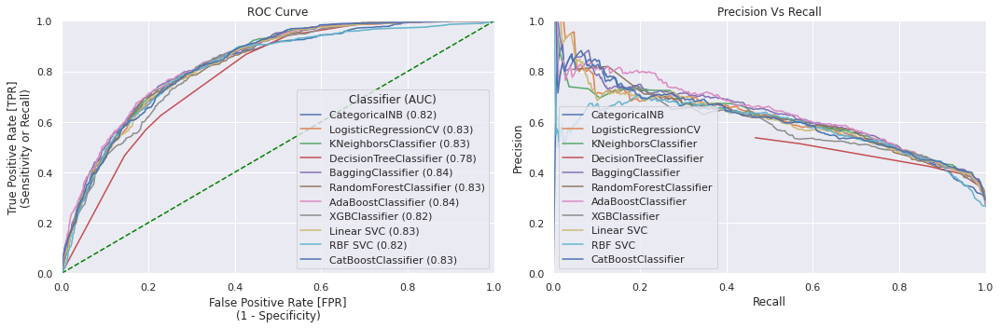

In [ ]:
compare_plot

<a name="8.6"></a>
### 8.6 Further Analysis
Back to [Table of Contents](#0)

In [ ]:
df_charges = list()
new_cols = ['Revenue Retained (Monthly) %', 'Revenue Retained (Total) %']

for rep in report_list:
    true_positives = (y_test * rep['test_predictions']).reshape(y_test.shape[0], 1)
    tp_revenue = (x_test_charges * true_positives).sum(axis=0)
    df_charges.append(tp_revenue)

revenue_saved = pd.DataFrame(df_charges, index=clf_labels, 
                             columns=new_cols)

compare_table_rev = pd.concat([compare_table, revenue_saved], axis=1)

## True Positive Revenue/ Total Churn Revenue
total_churn_revenue = (x_test_charges * y_test.reshape(y_test.shape[0], 1)).sum(axis=0)
temp_cols = (compare_table_rev.iloc[:, 8:10] / total_churn_revenue) * 100
compare_table_rev.iloc[:, 8:10] = temp_cols

In [ ]:
compare_table_rev

,Train Accuracy,Test Accuracy,Overfitting,ROC Area,Precision,Recall,F1-score,Support,Revenue Retained (Monthly) %,Revenue Retained (Total) %
CategoricalNB,0.782,0.734,True,0.820968,0.499316,0.781585,0.609349,467,79.498764,57.942667
LogisticRegressionCV,0.808,0.756,True,0.828618,0.529968,0.719486,0.610354,467,73.434152,55.053085
KNeighborsClassifier,0.796,0.7,True,0.834146,0.464871,0.850107,0.60106,467,86.672848,73.766242
DecisionTreeClassifier,0.783,0.742,True,0.78487,0.513514,0.569593,0.540102,467,55.492909,35.626324
BaggingClassifier,0.79,0.733,True,0.836764,0.497997,0.798715,0.613487,467,81.165812,60.562048
RandomForestClassifier,0.779,0.716,True,0.828526,0.479112,0.785867,0.595296,467,80.282664,60.386556
AdaBoostClassifier,0.818,0.757,True,0.838277,0.529501,0.749465,0.620567,467,75.952401,55.720689
XGBClassifier,0.8,0.735,True,0.818476,0.500719,0.745182,0.598967,467,74.411010,54.649950
Linear SVC,0.805,0.758,True,0.826052,0.533118,0.706638,0.607735,467,72.439546,55.426662
RBF SVC,0.828,0.77,True,0.815505,0.557196,0.646681,0.598612,467,66.318566,43.669037


In [ ]:
select_cols = ['Overfitting', 'F1-score'] + new_cols
compare_table_rev[select_cols].sort_values(by=['Overfitting', 'Revenue Retained (Monthly) %'],
                                           ascending=[True, False])

,Overfitting,F1-score,Revenue Retained (Monthly) %,Revenue Retained (Total) %
KNeighborsClassifier,True,0.60106,86.672848,73.766242
BaggingClassifier,True,0.613487,81.165812,60.562048
RandomForestClassifier,True,0.595296,80.282664,60.386556
CategoricalNB,True,0.609349,79.498764,57.942667
AdaBoostClassifier,True,0.620567,75.952401,55.720689
XGBClassifier,True,0.598967,74.411010,54.649950
LogisticRegressionCV,True,0.610354,73.434152,55.053085
Linear SVC,True,0.607735,72.439546,55.426662
RBF SVC,True,0.598612,66.318566,43.669037
CatBoostClassifier,True,0.594118,64.509818,40.240013


In [ ]:
compare_table_rev[select_cols].sort_values(by=['Overfitting', 'F1-score'],
                                           ascending=[True, False])

,Overfitting,F1-score,Revenue Retained (Monthly) %,Revenue Retained (Total) %
AdaBoostClassifier,True,0.620567,75.952401,55.720689
BaggingClassifier,True,0.613487,81.165812,60.562048
LogisticRegressionCV,True,0.610354,73.434152,55.053085
CategoricalNB,True,0.609349,79.498764,57.942667
Linear SVC,True,0.607735,72.439546,55.426662
KNeighborsClassifier,True,0.60106,86.672848,73.766242
XGBClassifier,True,0.598967,74.411010,54.649950
RBF SVC,True,0.598612,66.318566,43.669037
RandomForestClassifier,True,0.595296,80.282664,60.386556
CatBoostClassifier,True,0.594118,64.509818,40.240013


<a name="9"></a>
## 9 SHAP
Back to [Table of Contents](#0)

---


In [ ]:
churn_data = telecomDf.copy(deep = True)

In [ ]:
churn_data.TotalCharges = pd.to_numeric(churn_data.TotalCharges, errors='coerce')
churn_data.TotalCharges = churn_data.TotalCharges.fillna(method='ffill')

In [ ]:
churn_data.TotalCharges = pd.to_numeric(churn_data.TotalCharges, errors='coerce')
churn_data.isnull().sum()

In [ ]:
#Separating catagorical and numerical columns
Id_col     = ['customerID']
target_col = ["Churn"]
cat_cols   = churn_data.nunique()[churn_data.nunique() < 6].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col] #categorical predictor variables
num_cols   = [x for x in churn_data.columns if x not in cat_cols + target_col + Id_col] #numerical predictor variables

In [ ]:
#Separating churn and non churn customers
churn = churn_data[churn_data["Churn"] == "Yes"]
not_churn = churn_data[churn_data["Churn"] == "No"]

- 1) Gender is not a good indicator of churn
- 2) Customers that doesn't have partners are more likely to churn
- 3) Customers without dependents are also more likely to churn
- 4) Customers who are on month-to-month contract are likely to abandon company services
- 5) Customers who have internet available, opt for paperless billing and automatic payment services are more likely to churn. These groups of customers tend to be tech savvy, read widely and be updated on latest market trends and rates.
- 6) Customers who enjoy premium stream services are likely to leave, if they are lured by competitors offering similar services whose prices are competitive and offer better quality.
- 7) Customers also tend to leave because of lack of technical support and online security as they're unlikely to find success in a company's products.
- 8) Presence of phone service, especially multiple lines drive churn.

Senior citizens have a higher probability of having dependents. <br/>
People without partners generally do not have dependents.

Those with phoneservices have equal probability of having mutliple phone lines.

Multiple lines is not actually a strong predictor.

People who opt for paperless billing tend to utilise internet service.

Those with internet service have a clearcut preference for automatic transfers, especially Fiber optic subscribers. Those without internet services tend to use mailed check mostly.

People generally prefer manual transfer, probably due to safety reasons as well as lower cost, compared to automatic transfers.
This is regardless of age.

Inferences from histogram diagrams:

1) 39% of the churn customers have a tenure of about 5 months. <br/>

2) Churn customers have monthly charges peaked at around $75 per month. <br/>

3) Approximately 55% of churn customers have a cumulative total charge of 900 dollars <br/>

It is understood from the two scatterplots that:

1) Clients with lower tenure are more likely to churn

2) Clients with higher MonthlyCharges are also more likely to churn

3) Tenure and MonthlyCharges are very significant features in determining churn outcome

<a name="9.1"></a>
### 9.1 Feature Engineering
Back to [Table of Contents](#0)

In [ ]:
# A person is a family man if he has a spouse and dependents. 
#These groups of people chalk higher monthly bill and may churn
churn_data['Family_Person'] = np.where((churn_data['Dependents']=='Yes') & (churn_data['Partner']=='Yes'),1,0)


# Protection is defined by availability of security, backup and customer technical support
churn_data['Protection'] = np.where((churn_data['TechSupport'] == 'Yes') |\
                                    (churn_data['OnlineSecurity'] == 'Yes') |\
                                    (churn_data['OnlineBackup'] == 'Yes') |\
                                    (churn_data['DeviceProtection'] == 'Yes'),1,0)

# Total services - total counts of phone, internet, streaming and protection related services
churn_data['TotalServices'] = (churn_data[['PhoneService', 'InternetService', 'OnlineSecurity',
                                       'OnlineBackup', 'DeviceProtection', 'TechSupport',
                                       'StreamingTV', 'StreamingMovies']]== 'Yes').sum(axis=1)

# Presence of internet determines churn probability as well as numerous facilities availability
churn_data['Has_Internet']=churn_data['InternetService'].replace(['Fiber optic','DSL','No'], [1,1,0])

# Presence of either streaming movies or TV show facilities determine if a customer is using streaming services
churn_data['Streaming'] = np.where((churn_data['StreamingTV']=='Yes') | (churn_data['StreamingMovies']=='Yes'),1,0)

# Manual check payment does not utilises advanced modern electronic technology
churn_data['Tech_Payment'] = np.where((churn_data['PaymentMethod']!='Mailed check'),1,0)

# A person is a techie if he utilises high-tech payment methods or enjoys streaming services
churn_data['Techie'] = np.where((churn_data['Streaming']==1) | (churn_data['Tech_Payment']==1),1,0)

# Premium services defined by fiber optic usage and multiple phone lines
churn_data['Premium_Services'] = np.where((churn_data['MultipleLines']=='Yes') & (churn_data['InternetService']=='Fiber optic'),1,0)

In [ ]:
y=churn_data['Churn']

#Get rid of columns you don't wish to feed to machine learning models
drop_list=["customerID","Churn","gender","Partner","Dependents","StreamingTV","StreamingMovies","TechSupport",
           "OnlineSecurity","OnlineBackup","DeviceProtection","TotalCharges","MultipleLines","PhoneService","Contract",
          "InternetService","PaymentMethod"]
x=churn_data.drop(drop_list, axis=1)

In [ ]:
def label_encoder(dataframe, col_name): # Function for label encoding categorical variables
    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    le.fit(dataframe[col_name].unique())
    dataframe[col_name] = le.transform(dataframe[col_name])
    
for i in list(x.columns[x.dtypes =='object']):
    label_encoder(x, i)

In [ ]:
def label_encoder(dataframe, col_name): # Function for label encoding categorical variables
    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    le.fit(dataframe[col_name].unique())
    dataframe[col_name] = le.transform(dataframe[col_name])
    
for i in list(x.columns[x.dtypes =='object']):
    label_encoder(x, i)

<a name="9.2"></a>
### 9.2 Predictive Modelling
Back to [Table of Contents](#0)

<a name="9.2.1"></a>
#### 9.2.1 Random Forest
Back to [Table of Contents](#0)


In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=8,stratify=y,train_size=0.75)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(5282, 12) (1761, 12) (5282,) (1761,)


In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(bootstrap=True, oob_score=True, n_estimators=30, random_state=8,
                            max_depth=8, class_weight={'No': 1, 'Yes': 1.6},n_jobs=-1,max_features=0.3,min_samples_leaf=3,
                           min_samples_split=3)
rf.fit(x_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight={'No': 1, 'Yes': 1.6}, criterion='gini',
                       max_depth=8, max_features=0.3, max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=3,
                       min_samples_split=3, min_weight_fraction_leaf=0.0,
                       n_estimators=30, n_jobs=-1, oob_score=True,
                       random_state=8, verbose=0, warm_start=False)

In [ ]:
print("Training set score: {:.3f}".format(rf.score(x_train, y_train)))
print("Test set score: {:.3f}".format(rf.score(x_test, y_test)))
print("Out of bound score: {:.3f}".format(rf.oob_score_))

Training set score: 0.824
Test set score: 0.782
Out of bound score: 0.790


In [ ]:
rf_predictions = rf.predict(x_test)

[Text(30.5, 0.5, 'Truth'), Text(0.5, 12.5, 'Random Forest Prediction')]

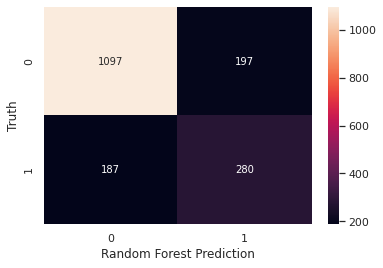

In [ ]:
from sklearn.metrics import confusion_matrix

ax = sns.heatmap(confusion_matrix(y_test, rf_predictions), annot=True, fmt='d')
ax.set(xlabel='Random Forest Prediction', ylabel='Truth')

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test,rf_predictions))

              precision    recall  f1-score   support

          No       0.85      0.85      0.85      1294
         Yes       0.59      0.60      0.59       467

    accuracy                           0.78      1761
   macro avg       0.72      0.72      0.72      1761
weighted avg       0.78      0.78      0.78      1761



In [ ]:
from sklearn.model_selection import RandomizedSearchCV

# Setup the parameters and distributions to sample from: param_dist
param = dict(max_depth = np.arange(6,15,1), max_features = np.arange(0.1,0.9,0.1))

rf_cv = RandomizedSearchCV(rf, param, cv=5,n_jobs=-1)
# Fit it to the data
rf_cv.fit(x_train, y_train)

RandomizedSearchCV(cv=5, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight={'No': 1,
                                                                  'Yes': 1.6},
                                                    criterion='gini',
                                                    max_depth=8,
                                                    max_features=0.3,
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=3,
                                                    min_samples_split=3,
                    

In [ ]:
# Print the tuned parameters and score
print("Tuned Random Forest Parameters: {}".format(rf_cv.best_params_))
print("Best score is {}".format(rf_cv.best_score_))

Tuned Random Forest Parameters: {'max_features': 0.2, 'max_depth': 9}
Best score is 0.7976154640061925


In [ ]:
rf2 = RandomForestClassifier(bootstrap=True, oob_score=True, n_estimators=30, random_state=8,
                            max_depth=6, class_weight={'No': 1, 'Yes': 1.6},n_jobs=-1,max_features=0.1,min_samples_leaf=5,
                           min_samples_split=5)
rf2.fit(x_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight={'No': 1, 'Yes': 1.6}, criterion='gini',
                       max_depth=6, max_features=0.1, max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=30, n_jobs=-1, oob_score=True,
                       random_state=8, verbose=0, warm_start=False)

In [ ]:
rf2_predictions = rf2.predict(x_test)

[Text(30.5, 0.5, 'Truth'), Text(0.5, 12.5, 'Random Forest Prediction')]

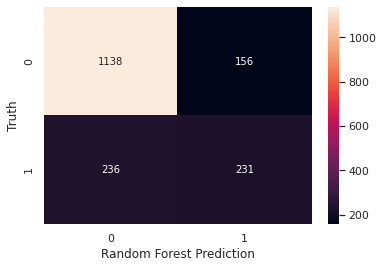

In [ ]:
from sklearn.metrics import confusion_matrix

ax = sns.heatmap(confusion_matrix(y_test, rf2_predictions), annot=True, fmt='d')
ax.set(xlabel='Random Forest Prediction', ylabel='Truth')

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test,rf2_predictions))

              precision    recall  f1-score   support

          No       0.83      0.88      0.85      1294
         Yes       0.60      0.49      0.54       467

    accuracy                           0.78      1761
   macro avg       0.71      0.69      0.70      1761
weighted avg       0.77      0.78      0.77      1761



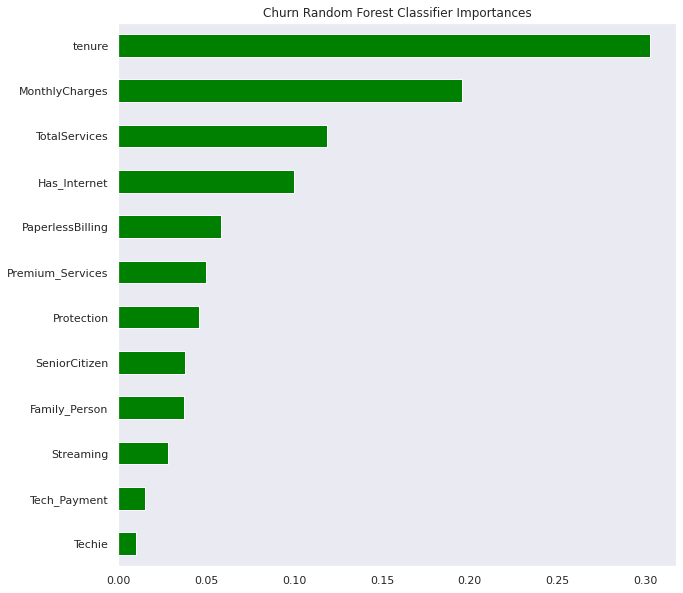

In [ ]:
def plot_feature_importances (model, kind, title, color, dataframe):
    importances = pd.Series(data=model.feature_importances_, index= dataframe.columns)
    # Sort importances
    importances_sorted = importances.sort_values()
    # Draw a horizontal barplot of importances_sorted
    importances_sorted.plot(kind=kind, color=color)
    plt.title(title)
    plt.grid()
    return(plt.show())

fig,ax=plt.subplots(figsize=(10,10))
plot_feature_importances (rf2, 'barh', 'Churn Random Forest Classifier Importances', 'green', x_train)

In [ ]:
#DT visualizatin method 1

from sklearn.tree import export_graphviz

dotfile = open("dt2.dot", 'w')

export_graphviz(rf[0], out_file=dotfile,feature_names = x.columns,class_names=['0','1'])
dotfile.close()
# Copying the contents of the created file ('dt2.dot' ) to a graphviz rendering agent at http://webgraphviz.com/
# check out https://www.kdnuggets.com/2017/05/simplifying-decision-tree-interpretation-decision-rules-python.html

In [ ]:
#DT visualizatin method 2
# need to install Graphviz first https://graphviz.gitlab.io/_pages/Download/Download_windows.html
from sklearn.tree import export_graphviz
import os

os.environ["PATH"] += os.pathsep + 'C:/Users/anirban/Desktop/customer-churn/codes'

export_graphviz(rf[0], out_file='tree.dot', feature_names=x.columns,class_names=['0','1'])
# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

<a name="9.3"></a>
### 9.3 Model Interpretability
Back to [Table of Contents](#0)

The relative importance score for each features generated is based on gini. It shows importance of each score in determining churn and non-churn categories.

Committment status of a customer (contract he/she signed up for), how long that person has been using telecom company service and monthly charges chalked up matters most regardless of demographics of the customer. This is for predicting both churn andd non-churn customers.

In [ ]:
! pip install shap

     |████████████████████████████████| 358kB 7.7MB/s 
  Created wheel for shap: filename=shap-0.39.0-cp37-cp37m-linux_x86_64.whl size=491626 sha256=9867eed59cde70f064e16cb43c3ef7709c743226225ef8ea5649e1e1ec531b40
  Stored in directory: /root/.cache/pip/wheels/15/27/f5/a8ab9da52fd159aae6477b5ede6eaaec69fd130fa0fa59f283
Successfully built shap


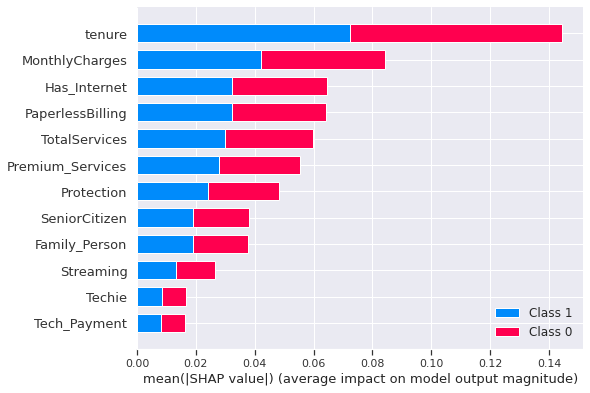

In [ ]:
import shap

# load JS visualization code to notebook
shap.initjs()

#Relative importance of each feature in determining target class probability
explainerRF = shap.TreeExplainer(rf2)
shap_values = explainerRF.shap_values(x_test)
shap.summary_plot(shap_values, x_test)

For comparison, a multi-prediction force plot is shown here. It is a combination of many individual force plots that are rotated 90 degrees and stacked horizontally.

The force plot shows that approximately three-quarters of the predictions follow the prediction path dominated by tenure, monthly charges and if the committment status, for both churn and non-churn customers.

Feel free to try out how various features interact with each other segregated by churn status flag.

In [ ]:
# visualize the training set predictions similarity with respect to predictor variables
shap.initjs()
shap.force_plot(explainerRF.expected_value[0], shap_values[0], x)

In [ ]:
! pip install scikit-plot

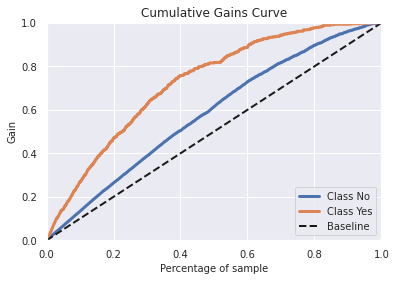

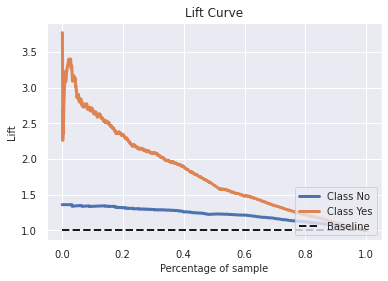

In [ ]:
import scikitplot as skplt

# Deriving Class probabilities
predicted_probabilities = rf2.predict_proba(x_test)
# Creating the plot
skplt.metrics.plot_cumulative_gain(y_test, predicted_probabilities)
skplt.metrics.plot_lift_curve(y_test, predicted_probabilities)

1. Lift is a measure of the effectiveness of a predictive model calculated as the ratio between the results obtained with and without the predictive model.
2. Cumulative gains and lift charts are visual aids for measuring model performance.
3. Both charts consist of a curve and a baseline.

If we observe carefully, we can reach out to over 80% of churn customers with this random forest model if marketing budget targets 50% of its customers according to cumulative gain curve. With a random pick in absence of this model, we will be reaching out to 50% of churn customers.


Lift is calculated as the ratio of Cumulative Gains from classification and random models. If the average incidence of targets is 20%, so the lift is 2.5. Thus, the model allows addressing two-and-half times more targets for this group, compared with addressing without the model (randomly).